In [2]:
from params import FuzzyInputVariable_3Trapezoids, FuzzyInputVariable_2Trapezoids, FuzzyInputVariable_List_Trapezoids
from operators import productN
import numpy as np
#from helps_and_enhancers import *
import matplotlib.pyplot as plt
from ANFIS import ANFIS
import time
import copy
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split

<H1>Przygotowanie zbioru danych<H1>

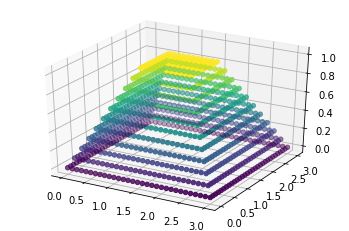

In [3]:
x = np.arange(0, 3.1, 0.1)
x,y = np.meshgrid(x, x)

dataX = x.flatten()
dataY = y.flatten()
dataXY = np.column_stack((dataX,dataY))

data_labels = []
for x, y in zip(dataX, dataY):
    x-=1.5
    y-=1.5
    data_labels.append( abs(x) if (y<x and y>-x) or (y>x and y<-x)  else abs(y) ) 
data_labels=np.array(data_labels)
#data_labels[data_labels>1.5] = 1.5
data_labels=abs(data_labels-1.5)
data_labels[data_labels>1] = 1
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(dataX, dataY, data_labels, c=data_labels)

plt.show()

<H1>Utworzenie funkcji przynależności</H1>

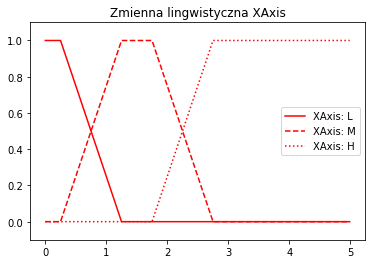

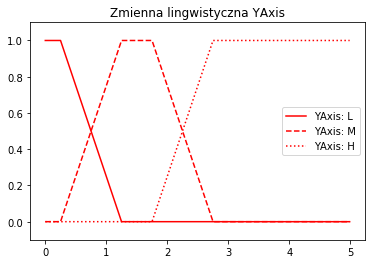

In [4]:
varX = FuzzyInputVariable_3Trapezoids(1.5, 0.5, 1, 1, "XAxis", ["L","M","H"])
varY = FuzzyInputVariable_3Trapezoids(1.5, 0.5, 1, 1, "YAxis", ["L","M","H"])

#Wyświetlanie funkcji przynależnosci
plt.figure()
varX.show(x = np.arange(0, 5, 0.01))
plt.legend()

plt.figure()
varY.show(x = np.arange(0, 5, 0.01))
plt.legend()

plt.show()

<H1>Uczenie systemu ANFIS</H1>

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(dataXY, data_labels, test_size=0.2, random_state=25)

fis = ANFIS([varX, varY], X_train.T, y_train)

start = time.time()
fis.train(True, True, False, True, n_iter=100)
end = time.time()
print("FIS premises", fis.premises)
print("TIME elapsed: ", end - start)   
fis.training_data = X_train.T
fis.expected_labels = y_train
fis.show_results(y_train)

args: [[[0.   0.85 0.15 ... 0.   0.85 0.15]
  [1.   0.   0.   ... 1.   0.   0.  ]
  [0.05 0.95 0.   ... 0.05 0.95 0.  ]
  ...
  [0.35 0.65 0.   ... 0.35 0.65 0.  ]
  [0.45 0.55 0.   ... 0.45 0.55 0.  ]
  [0.45 0.55 0.   ... 0.45 0.55 0.  ]]

 [[0.   0.   0.   ... 0.15 0.15 0.15]
  [0.05 0.05 0.05 ... 0.   0.   0.  ]
  [0.95 0.95 0.95 ... 0.   0.   0.  ]
  ...
  [0.   0.   0.   ... 0.   0.   0.  ]
  [0.25 0.25 0.25 ... 0.   0.   0.  ]
  [0.85 0.85 0.85 ... 0.   0.   0.  ]]]
args: [[[0.   0.85 0.15 ... 0.   0.85 0.15]
  [1.   0.   0.   ... 1.   0.   0.  ]
  [0.05 0.95 0.   ... 0.05 0.95 0.  ]
  ...
  [0.35 0.65 0.   ... 0.35 0.65 0.  ]
  [0.45 0.55 0.   ... 0.45 0.55 0.  ]
  [0.45 0.55 0.   ... 0.45 0.55 0.  ]]

 [[0.   0.   0.   ... 0.15 0.15 0.15]
  [0.05 0.05 0.05 ... 0.   0.   0.  ]
  [0.95 0.95 0.95 ... 0.   0.   0.  ]
  ...
  [0.   0.   0.   ... 0.   0.   0.  ]
  [0.25 0.25 0.25 ... 0.   0.   0.  ]
  [0.85 0.85 0.85 ... 0.   0.   0.  ]]]
args: [[[0.         0.85000001 0.14999999 ..

args: [[[0.56994514 0.43005486 0.         ... 0.56994514 0.43005486 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.56994514 0.43005486 0.         ... 0.56994514 0.43005486 0.        ]
  [1.     

args: [[[0.5221607 0.4778393 0.        ... 0.5221607 0.4778393 0.       ]
  [1.        0.        0.        ... 1.        0.        0.       ]
  [1.        0.        0.        ... 1.        0.        0.       ]
  ...
  [1.        0.        0.        ... 1.        0.        0.       ]
  [1.        0.        0.        ... 1.        0.        0.       ]
  [1.        0.        0.        ... 1.        0.        0.       ]]

 [[1.        1.        1.        ... 0.        0.        0.       ]
  [1.        1.        1.        ... 0.        0.        0.       ]
  [1.        1.        1.        ... 0.        0.        0.       ]
  ...
  [1.        1.        1.        ... 0.        0.        0.       ]
  [1.        1.        1.        ... 0.        0.        0.       ]
  [1.        1.        1.        ... 0.        0.        0.       ]]]
args: [[[0.5221607 0.4778393 0.        ... 0.5221607 0.4778393 0.       ]
  [1.        0.        0.        ... 1.        0.        0.       ]
  [1.        0.     

args: [[[0.67429877 0.32570123 0.         ... 0.67429877 0.32570123 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.67429877 0.32570123 0.         ... 0.67429877 0.32570123 0.        ]
  [1.     

args: [[[0.62381867 0.37618133 0.         ... 0.62381867 0.37618133 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.62381867 0.37618133 0.         ... 0.62381867 0.37618133 0.        ]
  [1.     

args: [[[1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.25962311 0.25962311 0.25962311 ... 0.         0.         0.        ]
  [0.46261842 0.46261842 0.46261842 ... 0.         0.         0.        ]
  [0.7236124  0.7236124  0.7236124  ... 0.         0.         0.        ]
  ...
  [0.37562043 0.37562043 0.37562043 ... 0.         0.         0.        ]
  [0.52061708 0.52061708 0.52061708 ... 0.         0.         0.        ]
  [0.69461307 0.69461307 0.69461307 ... 0.         0.         0.        ]]]
args: [[[0.64573741 0.35426259 0.         ... 0.64573741 0.35426259 0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.57724217 0.42275783 0.         ... 0.57724217 0.42275783 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.9450206  0.0549794  0.         ... 0.9450206  0.0549794  0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.577

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.47258025 0.52741975 0.         ... 0.47258025 0.52741975 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.83170171 0.16829829 0.         ... 0.83170171 0.16829829 0.        ]
  ...
  [0.98561091 0.01438909 0.         ... 0.98561091 0.01438909 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.472

args: [[[0.48305259 0.51694741 0.         ... 0.48305259 0.51694741 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81363489 0.18636511 0.         ... 0.81363489 0.18636511 0.        ]
  ...
  [0.95531301 0.04468699 0.         ... 0.95531301 0.04468699 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48305259 0.51694741 0.         ... 0.48305259 0.51694741 0.        ]
  [1.     

args: [[[0.50581406 0.49418594 0.         ... 0.50581406 0.49418594 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.86046399 0.13953601 0.         ... 0.86046399 0.13953601 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.50581406 0.49418594 0.         ... 0.50581406 0.49418594 0.        ]
  [1.     

args: [[[0.50064339 0.49935661 0.         ... 0.50064339 0.49935661 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85343001 0.14656999 0.         ... 0.85343001 0.14656999 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.50064339 0.49935661 0.         ... 0.50064339 0.49935661 0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.50027532 0.49972468 0.         ... 0.50027532 0.49972468 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85311575 0.14688425 0.         ... 0.85311575 0.14688425 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.500

args: [[[0.4999987  0.5000013  0.         ... 0.4999987  0.5000013  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85290347 0.14709653 0.         ... 0.85290347 0.14709653 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4999987  0.5000013  0.         ... 0.4999987  0.5000013  0.        ]
  [1.     

args: [[[0.49971765 0.50028235 0.         ... 0.49971765 0.50028235 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.8526434  0.1473566  0.         ... 0.8526434  0.1473566  0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49971291 0.50028709 0.         ... 0.49971291 0.50028709 0.        ]
  [1.     

args: [[[0.49969423 0.50030577 0.         ... 0.49969423 0.50030577 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85260032 0.14739968 0.         ... 0.85260032 0.14739968 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49969423 0.50030577 0.         ... 0.49969423 0.50030577 0.        ]
  [1.     

args: [[[0.49949078 0.50050922 0.         ... 0.49949078 0.50050922 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85245851 0.14754149 0.         ... 0.85245851 0.14754149 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49949078 0.50050922 0.         ... 0.49949078 0.50050922 0.        ]
  [1.     

args: [[[0.49906338 0.50093662 0.         ... 0.49906338 0.50093662 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85210083 0.14789917 0.         ... 0.85210083 0.14789917 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49906338 0.50093662 0.         ... 0.49906338 0.50093662 0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.499058   0.500942   0.         ... 0.499058   0.500942   0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85209969 0.14790031 0.         ... 0.85209969 0.14790031 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.499

args: [[[0.4989487  0.5010513  0.         ... 0.4989487  0.5010513  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85203167 0.14796833 0.         ... 0.85203167 0.14796833 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4989487  0.5010513  0.         ... 0.4989487  0.5010513  0.        ]
  [1.     

args: [[[0.49889314 0.50110686 0.         ... 0.49889314 0.50110686 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85198963 0.14801037 0.         ... 0.85198963 0.14801037 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49889314 0.50110686 0.         ... 0.49889314 0.50110686 0.        ]
  [1.     

args: [[[0.4988227  0.5011773  0.         ... 0.4988227  0.5011773  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85190804 0.14809196 0.         ... 0.85190804 0.14809196 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4988227  0.5011773  0.         ... 0.4988227  0.5011773  0.        ]
  [1.     

args: [[[0.73425502 0.26574498 0.         ... 0.73425502 0.26574498 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.84165202 0.84165202 0.84165202 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.73425502 0.26574498 0.         ... 0.73425502 0.26574498 0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]]

 [[0.20977947 0.20977947 0.20977947 ... 0.         0.         0.        ]
  [0.38477947 0.38477947 0.38477947 ... 0.         0.         0.        ]
  [0.60977947 0.60977947 0.60977947 ... 0.         0.         0.        ]
  ...
  [0.30977947 0.30977947 0.30977947 ... 0.         0.         0.        ]
  [0.43477947 0.43477947 0.43477947 ... 0.         0.         0.        ]
  [0.58477947 0.58477947 0.58477947 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]]

 [[0.19734271 0.19734271 0.19734271 ... 0.         0.         0.        ]
  [0.37234271 0.37234271 0.37234271 ... 0.         0.         0.        ]
  [0.59734271 0.59734271 0.59734271 ... 0.         0.         0.        ]
  ...
  [0.29734271 0.29734271 0.29734271 ... 0.         0.         0.        ]
  [0.42234271 0.42234271 0.42234271 ... 0.         0.         0.        ]
  [0.57234271 0.57234271 0.57234271 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

  [0.67722323 0.67722323 0.67722323 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]]

 [[0.26356425 0.26356425 0.26356425 ... 0.         0.         0.        ]
  [0.45660511 0.45660511 0.45660511 ... 0.         0.         0.        ]
  [0.70480049 0.70480049 0.70480049 ... 0.         0.         0.        ]
  ...
  [0.37387331 0.37387331 0.37387331 ... 0.         0.         0.        ]
  [0.51175964 0.51175964 0.51175964 ... 0.         0.         0.        ]
  [0.67722323 0.67722323 0.67722323 ... 0.         0.         0.        ]]]
args: [[[0.   

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.03074471 0.96925529 0.         ... 0.03074471 0.96925529 0.        ]
  [0.03074471 0.96925529 0.         ... 0.03074471 0.96925529 0.        ]]

 [[0.2517696  0.2517696  0.2517696  ... 0.         0.         0.        ]
  [0.43942876 0.43942876 0.43942876 ... 0.         0.         0.        ]
  [0.68070482 0.68070482 0.68070482 ... 0.         0.         0.        ]
  ...
  [0.3590034  0.3590034  0.3590034  ... 0.         0.         0.        ]
  [0.49304566 0.49304566 0.49304566 ... 0.         0.         0.        ]
  [0.65389637 0.65389637 0.65389637 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.03467261 0.96532739 0.         ... 0.03467261 0.96532739 0.        ]
  [0.19681935 0.80318065 0.         ... 0.19681935 0.80318065 0.        ]
  [0.19681935 0.80318065 0.         ... 0.19681935 0.80318065 0.        ]]

 [[0.26909319 0.26909319 0.26909319 ... 0.         0.         0.        ]
  [0.45233282 0.45233282 0.45233282 ... 0.         0.         0.        ]
  [0.68792662 0.68792662 0.68792662 ... 0.         0.         0.        ]
  ...
  [0.37380155 0.37380155 0.37380155 ... 0.         0.         0.        ]
  [0.504687   0.504687   0.504687   ... 0.         0.         0.        ]
  [0.66174953 0.66174953 0.66174953 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.03513629 0.96486371 0.         ... 0.03513629 0.96486371 0.        ]
  [0.19589897 0.80410103 0.         ... 0.19589897 0.80410103 0.        ]
  [0.19589897 0.80410103 0.         ... 0.19589897 0.80410103 0.        ]]

 [[0.26996567 0.26996567 0.26996567 ... 0.         0.         0.        ]
  [0.44496583 0.44496583 0.44496583 ... 0.         0.         0.        ]
  [0.66996604 0.66996604 0.66996604 ... 0.         0.         0.        ]
  ...
  [0.36996576 0.36996576 0.36996576 ... 0.         0.         0.        ]
  [0.49496588 0.49496588 0.49496588 ... 0.         0.         0.        ]
  [0.64496602 0.64496602 0.64496602 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

  [0.64369383 0.64369383 0.64369383 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.08079194 0.91920806 0.         ... 0.08079194 0.91920806 0.        ]
  [0.08079194 0.91920806 0.         ... 0.08079194 0.91920806 0.        ]]

 [[0.26867313 0.26867313 0.26867313 ... 0.         0.         0.        ]
  [0.44368279 0.44368279 0.44368279 ... 0.         0.         0.        ]
  [0.6686952  0.6686952  0.6686952  ... 0.         0.         0.        ]
  ...
  [0.36867865 0.36867865 0.36867865 ... 0.         0.         0.        ]
  [0.49368555 0.49368555 0.49368555 ... 0.         0.         0.        ]
  [0.64369383 0.64369383 0.64369383 ... 0.         0.         0.        ]]]
args: [[[0.   

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.03287352 0.96712648 0.         ... 0.03287352 0.96712648 0.        ]
  [0.18860915 0.81139085 0.         ... 0.18860915 0.81139085 0.        ]
  [0.18860915 0.81139085 0.         ... 0.18860915 0.81139085 0.        ]]

 [[0.28658674 0.28658674 0.28658674 ... 0.         0.         0.        ]
  [0.47349617 0.47349617 0.47349617 ... 0.         0.         0.        ]
  [0.71380829 0.71380829 0.71380829 ... 0.         0.         0.        ]
  ...
  [0.39339213 0.39339213 0.39339213 ... 0.         0.         0.        ]
  [0.52689886 0.52689886 0.52689886 ... 0.         0.         0.        ]
  [0.68710694 0.68710694 0.68710694 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.00259819 0.99740181 0.         ... 0.00259819 0.99740181 0.        ]
  [0.16248936 0.83751064 0.         ... 0.16248936 0.83751064 0.        ]
  [0.16248936 0.83751064 0.         ... 0.16248936 0.83751064 0.        ]]

 [[0.28797765 0.28797765 0.28797765 ... 0.         0.         0.        ]
  [0.47660104 0.47660104 0.47660104 ... 0.         0.         0.        ]
  [0.71911683 0.71911683 0.71911683 ... 0.         0.         0.        ]
  ...
  [0.39576245 0.39576245 0.39576245 ... 0.         0.         0.        ]
  [0.53049344 0.53049344 0.53049344 ... 0.         0.         0.        ]
  [0.69217063 0.69217063 0.69217063 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.15723227 0.84276773 0.         ... 0.15723227 0.84276773 0.        ]
  [0.15723227 0.84276773 0.         ... 0.15723227 0.84276773 0.        ]]

 [[0.27068936 0.27068936 0.27068936 ... 0.         0.         0.        ]
  [0.44783147 0.44783147 0.44783147 ... 0.         0.         0.        ]
  [0.67558561 0.67558561 0.67558561 ... 0.         0.         0.        ]
  ...
  [0.37191342 0.37191342 0.37191342 ... 0.         0.         0.        ]
  [0.4984435  0.4984435  0.4984435  ... 0.         0.         0.        ]
  [0.65027959 0.65027959 0.65027959 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

  [0.64366182 0.64366182 0.64366182 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.14616745 0.85383255 0.         ... 0.14616745 0.85383255 0.        ]
  [0.14616745 0.85383255 0.         ... 0.14616745 0.85383255 0.        ]]

 [[0.26866182 0.26866182 0.26866182 ... 0.         0.         0.        ]
  [0.44366182 0.44366182 0.44366182 ... 0.         0.         0.        ]
  [0.66866182 0.66866182 0.66866182 ... 0.         0.         0.        ]
  ...
  [0.36866182 0.36866182 0.36866182 ... 0.         0.         0.        ]
  [0.49366182 0.49366182 0.49366182 ... 0.         0.         0.        ]
  [0.64366182 0.64366182 0.64366182 ... 0.         0.         0.        ]]]
args: [[[0.   

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.00148411 0.99851589 0.         ... 0.00148411 0.99851589 0.        ]
  [0.14614974 0.85385026 0.         ... 0.14614974 0.85385026 0.        ]
  [0.14614974 0.85385026 0.         ... 0.14614974 0.85385026 0.        ]]

 [[0.2688229  0.2688229  0.2688229  ... 0.         0.         0.        ]
  [0.4438229  0.4438229  0.4438229  ... 0.         0.         0.        ]
  [0.6688229  0.6688229  0.6688229  ... 0.         0.         0.        ]
  ...
  [0.3688229  0.3688229  0.3688229  ... 0.         0.         0.        ]
  [0.4938229  0.4938229  0.4938229  ... 0.         0.         0.        ]
  [0.6438229  0.6438229  0.6438229  ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.14176629 0.85823371 0.         ... 0.14176629 0.85823371 0.        ]
  [0.14176629 0.85823371 0.         ... 0.14176629 0.85823371 0.        ]]

 [[0.26844955 0.26844955 0.26844955 ... 0.         0.         0.        ]
  [0.44359084 0.44359084 0.44359084 ... 0.         0.         0.        ]
  [0.6687725  0.6687725  0.6687725  ... 0.         0.         0.        ]
  ...
  [0.36853029 0.36853029 0.36853029 ... 0.         0.         0.        ]
  [0.49363121 0.49363121 0.49363121 ... 0.         0.         0.        ]
  [0.64375232 0.64375232 0.64375232 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

  [0.66379306 0.66379306 0.66379306 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.90555656 0.09444344 0.         ... 0.90555656 0.09444344 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.04622915 0.95377085 0.         ... 0.04622915 0.95377085 0.        ]
  [0.16899021 0.83100979 0.         ... 0.16899021 0.83100979 0.        ]
  [0.16899021 0.83100979 0.         ... 0.16899021 0.83100979 0.        ]]

 [[0.27660128 0.27660128 0.27660128 ... 0.         0.         0.        ]
  [0.45729078 0.45729078 0.45729078 ... 0.         0.         0.        ]
  [0.68960584 0.68960584 0.68960584 ... 0.         0.         0.        ]
  ...
  [0.37985242 0.37985242 0.37985242 ... 0.         0.         0.        ]
  [0.50891635 0.50891635 0.50891635 ... 0.         0.         0.        ]
  [0.66379306 0.66379306 0.66379306 ... 0.         0.         0.        ]]]
args: [[[0.   

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.90065567 0.09934433 0.         ... 0.90065567 0.09934433 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.04586874 0.95413126 0.         ... 0.04586874 0.95413126 0.        ]
  [0.16798116 0.83201884 0.         ... 0.16798116 0.83201884 0.        ]
  [0.16798116 0.83201884 0.         ... 0.16798116 0.83201884 0.        ]]

 [[0.28127801 0.28127801 0.28127801 ... 0.         0.         0.        ]
  [0.46544037 0.46544037 0.46544037 ... 0.         0.         0.        ]
  [0.70222055 0.70222055 0.70222055 ... 0.         0.         0.        ]
  ...
  [0.38651364 0.38651364 0.38651364 ... 0.         0.         0.        ]
  [0.51805819 0.51805819 0.51805819 ... 0.         0.         0.        ]
  [0.67591164 0.67591164 0.67591164 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.90065

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.90583964 0.09416036 0.         ... 0.90583964 0.09416036 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.0311361  0.9688639  0.         ... 0.0311361  0.9688639  0.        ]
  [0.15609375 0.84390625 0.         ... 0.15609375 0.84390625 0.        ]
  [0.15609375 0.84390625 0.         ... 0.15609375 0.84390625 0.        ]]

 [[0.28362872 0.28362872 0.28362872 ... 0.         0.         0.        ]
  [0.46932933 0.46932933 0.46932933 ... 0.         0.         0.        ]
  [0.70808725 0.70808725 0.70808725 ... 0.         0.         0.        ]
  ...
  [0.38974335 0.38974335 0.38974335 ... 0.         0.         0.        ]
  [0.52238664 0.52238664 0.52238664 ... 0.         0.         0.        ]
  [0.68155859 0.68155859 0.68155859 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.90583

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.8592537  0.1407463  0.         ... 0.8592537  0.1407463  0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.00246481 0.99753519 0.         ... 0.00246481 0.99753519 0.        ]
  [0.12486323 0.87513677 0.         ... 0.12486323 0.87513677 0.        ]
  [0.12486323 0.87513677 0.         ... 0.12486323 0.87513677 0.        ]]

 [[0.30971529 0.30971529 0.30971529 ... 0.         0.         0.        ]
  [0.51232668 0.51232668 0.51232668 ... 0.         0.         0.        ]
  [0.77282703 0.77282703 0.77282703 ... 0.         0.         0.        ]
  ...
  [0.42549323 0.42549323 0.42549323 ... 0.         0.         0.        ]
  [0.57021565 0.57021565 0.57021565 ... 0.         0.         0.        ]
  [0.74388255 0.74388255 0.74388255 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.85925

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81818298 0.18181702 0.         ... 0.81818298 0.18181702 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.03356363 0.96643637 0.         ... 0.03356363 0.96643637 0.        ]
  [0.14565211 0.85434789 0.         ... 0.14565211 0.85434789 0.        ]
  [0.14565211 0.85434789 0.         ... 0.14565211 0.85434789 0.        ]]

 [[0.28399677 0.28399677 0.28399677 ... 0.         0.         0.        ]
  [0.46966448 0.46966448 0.46966448 ... 0.         0.         0.        ]
  [0.7083801  0.7083801  0.7083801  ... 0.         0.         0.        ]
  ...
  [0.39009261 0.39009261 0.39009261 ... 0.         0.         0.        ]
  [0.52271239 0.52271239 0.52271239 ... 0.         0.         0.        ]
  [0.68185614 0.68185614 0.68185614 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81818

  [0.6696035  0.6696035  0.6696035  ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81237255 0.18762745 0.         ... 0.81237255 0.18762745 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.01715144 0.98284856 0.         ... 0.01715144 0.98284856 0.        ]
  [0.13075445 0.86924555 0.         ... 0.13075445 0.86924555 0.        ]
  [0.13075445 0.86924555 0.         ... 0.13075445 0.86924555 0.        ]]

 [[0.27893084 0.27893084 0.27893084 ... 0.         0.         0.        ]
  [0.46124475 0.46124475 0.46124475 ... 0.         0.         0.        ]
  [0.69564834 0.69564834 0.69564834 ... 0.         0.         0.        ]
  ...
  [0.38311022 0.38311022 0.38311022 ... 0.         0.         0.        ]
  [0.51333444 0.51333444 0.51333444 ... 0.         0.         0.        ]
  [0.6696035  0.6696035  0.6696035  ... 0.         0.         0.        ]]]
args: [[[0.   

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81130451 0.18869549 0.         ... 0.81130451 0.18869549 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.01484209 0.98515791 0.         ... 0.01484209 0.98515791 0.        ]
  [0.12862243 0.87137757 0.         ... 0.12862243 0.87137757 0.        ]
  [0.12862243 0.87137757 0.         ... 0.12862243 0.87137757 0.        ]]

 [[0.27731787 0.27731787 0.27731787 ... 0.         0.         0.        ]
  [0.4585474  0.4585474  0.4585474  ... 0.         0.         0.        ]
  [0.69155678 0.69155678 0.69155678 ... 0.         0.         0.        ]
  ...
  [0.3808776  0.3808776  0.3808776  ... 0.         0.         0.        ]
  [0.51032726 0.51032726 0.51032726 ... 0.         0.         0.        ]
  [0.66566685 0.66566685 0.66566685 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81176

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81068772 0.18931228 0.         ... 0.81068772 0.18931228 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.0107368  0.9892632  0.         ... 0.0107368  0.9892632  0.        ]
  [0.12501551 0.87498449 0.         ... 0.12501551 0.87498449 0.        ]
  [0.12501551 0.87498449 0.         ... 0.12501551 0.87498449 0.        ]]

 [[0.27525252 0.27525252 0.27525252 ... 0.         0.         0.        ]
  [0.45509176 0.45509176 0.45509176 ... 0.         0.         0.        ]
  [0.68631365 0.68631365 0.68631365 ... 0.         0.         0.        ]
  ...
  [0.3780178  0.3780178  0.3780178  ... 0.         0.         0.        ]
  [0.5064744  0.5064744  0.5064744  ... 0.         0.         0.        ]
  [0.66062233 0.66062233 0.66062233 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81068

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81061417 0.18938583 0.         ... 0.81061417 0.18938583 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.01144319 0.98855681 0.         ... 0.01144319 0.98855681 0.        ]
  [0.12561047 0.87438953 0.         ... 0.12561047 0.87438953 0.        ]
  [0.12561047 0.87438953 0.         ... 0.12561047 0.87438953 0.        ]]

 [[0.27546526 0.27546526 0.27546526 ... 0.         0.         0.        ]
  [0.45529266 0.45529266 0.45529266 ... 0.         0.         0.        ]
  [0.68649931 0.68649931 0.68649931 ... 0.         0.         0.        ]
  ...
  [0.37822377 0.37822377 0.37822377 ... 0.         0.         0.        ]
  [0.50667191 0.50667191 0.50667191 ... 0.         0.         0.        ]
  [0.66080968 0.66080968 0.66080968 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81061

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81066209 0.18933791 0.         ... 0.81066209 0.18933791 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.01232463 0.98767537 0.         ... 0.01232463 0.98767537 0.        ]
  [0.12637284 0.87362716 0.         ... 0.12637284 0.87362716 0.        ]
  [0.12637284 0.87362716 0.         ... 0.12637284 0.87362716 0.        ]]

 [[0.27609499 0.27609499 0.27609499 ... 0.         0.         0.        ]
  [0.45588996 0.45588996 0.45588996 ... 0.         0.         0.        ]
  [0.68705493 0.68705493 0.68705493 ... 0.         0.         0.        ]
  ...
  [0.37883497 0.37883497 0.37883497 ... 0.         0.         0.        ]
  [0.50725996 0.50725996 0.50725996 ... 0.         0.         0.        ]
  [0.66136994 0.66136994 0.66136994 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81066

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.79703204 0.20296796 0.         ... 0.79703204 0.20296796 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.00759383 0.99240617 0.         ... 0.00759383 0.99240617 0.        ]
  [0.12037072 0.87962928 0.         ... 0.12037072 0.87962928 0.        ]
  [0.12037072 0.87962928 0.         ... 0.12037072 0.87962928 0.        ]]

 [[0.31116572 0.31116572 0.31116572 ... 0.         0.         0.        ]
  [0.48616572 0.48616572 0.48616572 ... 0.         0.         0.        ]
  [0.71116572 0.71116572 0.71116572 ... 0.         0.         0.        ]
  ...
  [0.41116572 0.41116572 0.41116572 ... 0.         0.         0.        ]
  [0.53616572 0.53616572 0.53616572 ... 0.         0.         0.        ]
  [0.68616572 0.68616572 0.68616572 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.80928

  [0.66138062 0.66138062 0.66138062 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.7949535  0.2050465  0.         ... 0.7949535  0.2050465  0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.0043413  0.9956587  0.         ... 0.0043413  0.9956587  0.        ]
  [0.1172859  0.8827141  0.         ... 0.1172859  0.8827141  0.        ]
  [0.1172859  0.8827141  0.         ... 0.1172859  0.8827141  0.        ]]

 [[0.31586771 0.31586771 0.31586771 ... 0.         0.         0.        ]
  [0.49086771 0.49086771 0.49086771 ... 0.         0.         0.        ]
  [0.71586771 0.71586771 0.71586771 ... 0.         0.         0.        ]
  ...
  [0.41586771 0.41586771 0.41586771 ... 0.         0.         0.        ]
  [0.54086771 0.54086771 0.54086771 ... 0.         0.         0.        ]
  [0.69086771 0.69086771 0.69086771 ... 0.         0.         0.        ]]]
args: [[[0.   

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81065741 0.18934259 0.         ... 0.81065741 0.18934259 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.01233317 0.98766683 0.         ... 0.01233317 0.98766683 0.        ]
  [0.12637949 0.87362051 0.         ... 0.12637949 0.87362051 0.        ]
  [0.12637949 0.87362051 0.         ... 0.12637949 0.87362051 0.        ]]

 [[0.2761134  0.2761134  0.2761134  ... 0.         0.         0.        ]
  [0.45590518 0.45590518 0.45590518 ... 0.         0.         0.        ]
  [0.68706603 0.68706603 0.68706603 ... 0.         0.         0.        ]
  ...
  [0.37885156 0.37885156 0.37885156 ... 0.         0.         0.        ]
  [0.50727425 0.50727425 0.50727425 ... 0.         0.         0.        ]
  [0.66138149 0.66138149 0.66138149 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81065

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.8105513  0.1894487  0.         ... 0.8105513  0.1894487  0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.01182671 0.98817329 0.         ... 0.01182671 0.98817329 0.        ]
  [0.12593022 0.87406978 0.         ... 0.12593022 0.87406978 0.        ]
  [0.12593022 0.87406978 0.         ... 0.12593022 0.87406978 0.        ]]

 [[0.27624143 0.27624143 0.27624143 ... 0.         0.         0.        ]
  [0.45613199 0.45613199 0.45613199 ... 0.         0.         0.        ]
  [0.68741985 0.68741985 0.68741985 ... 0.         0.         0.        ]
  ...
  [0.37903604 0.37903604 0.37903604 ... 0.         0.         0.        ]
  [0.50752929 0.50752929 0.50752929 ... 0.         0.         0.        ]
  [0.6617212  0.6617212  0.6617212  ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81055

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81028198 0.18971802 0.         ... 0.81028198 0.18971802 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.01055897 0.98944103 0.         ... 0.01055897 0.98944103 0.        ]
  [0.12480511 0.87519489 0.         ... 0.12480511 0.87519489 0.        ]
  [0.12480511 0.87519489 0.         ... 0.12480511 0.87519489 0.        ]]

 [[0.27718062 0.27718062 0.27718062 ... 0.         0.         0.        ]
  [0.45767897 0.45767897 0.45767897 ... 0.         0.         0.        ]
  [0.68974828 0.68974828 0.68974828 ... 0.         0.         0.        ]
  ...
  [0.38032253 0.38032253 0.38032253 ... 0.         0.         0.        ]
  [0.50924993 0.50924993 0.50924993 ... 0.         0.         0.        ]
  [0.6639628  0.6639628  0.6639628  ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81028

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81027006 0.18972994 0.         ... 0.81027006 0.18972994 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.01050445 0.98949555 0.         ... 0.01050445 0.98949555 0.        ]
  [0.12475668 0.87524332 0.         ... 0.12475668 0.87524332 0.        ]
  [0.12475668 0.87524332 0.         ... 0.12475668 0.87524332 0.        ]]

 [[0.27722169 0.27722169 0.27722169 ... 0.         0.         0.        ]
  [0.45774667 0.45774667 0.45774667 ... 0.         0.         0.        ]
  [0.68985021 0.68985021 0.68985021 ... 0.         0.         0.        ]
  ...
  [0.38037882 0.38037882 0.38037882 ... 0.         0.         0.        ]
  [0.50932523 0.50932523 0.50932523 ... 0.         0.         0.        ]
  [0.66406093 0.66406093 0.66406093 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.81027

args: [[[0.3453547  0.6546453  0.         ... 0.3453547  0.6546453  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.6436349  0.3563651  0.         ... 0.6436349  0.3563651  0.        ]
  ...
  [0.77146928 0.22853072 0.         ... 0.77146928 0.22853072 0.        ]
  [0.81408073 0.18591927 0.         ... 0.81408073 0.18591927 0.        ]
  [0.81408073 0.18591927 0.         ... 0.81408073 0.18591927 0.        ]]

 [[0.93871627 0.93871627 0.93871627 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.3453547  0.6546453  0.         ... 0.3453547  0.6546453  0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.28070259 0.71929741 0.         ... 0.28070259 0.71929741 0.        ]
  [0.95840504 0.04159496 0.         ... 0.95840504 0.04159496 0.        ]
  [0.55975654 0.44024346 0.         ... 0.55975654 0.44024346 0.        ]
  ...
  [0.67935109 0.32064891 0.         ... 0.67935109 0.32064891 0.        ]
  [0.71921594 0.28078406 0.         ... 0.71921594 0.28078406 0.        ]
  [0.71921594 0.28078406 0.         ... 0.71921594 0.28078406 0.        ]]

 [[0.82914176 0.82914176 0.82914176 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.280

args: [[[0.26096926 0.73903074 0.         ... 0.26096926 0.73903074 0.        ]
  [0.95089091 0.04910909 0.         ... 0.95089091 0.04910909 0.        ]
  [0.54505464 0.45494536 0.         ... 0.54505464 0.45494536 0.        ]
  ...
  [0.66680552 0.33319448 0.         ... 0.66680552 0.33319448 0.        ]
  [0.70738915 0.29261085 0.         ... 0.70738915 0.29261085 0.        ]
  [0.70738915 0.29261085 0.         ... 0.70738915 0.29261085 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.26096926 0.73903074 0.         ... 0.26096926 0.73903074 0.        ]
  [0.95089

args: [[[0.39001209 0.60998791 0.         ... 0.39001209 0.60998791 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.71440075 0.28559925 0.         ... 0.71440075 0.28559925 0.        ]
  ...
  [0.85342447 0.14657553 0.         ... 0.85342447 0.14657553 0.        ]
  [0.8997657  0.1002343  0.         ... 0.8997657  0.1002343  0.        ]
  [0.8997657  0.1002343  0.         ... 0.8997657  0.1002343  0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.39001209 0.60998791 0.         ... 0.39001209 0.60998791 0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.35679984 0.64320016 0.         ... 0.35679984 0.64320016 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.6373857  0.3626143  0.         ... 0.6373857  0.3626143  0.        ]
  ...
  [0.75763678 0.24236322 0.         ... 0.75763678 0.24236322 0.        ]
  [0.79772047 0.20227953 0.         ... 0.79772047 0.20227953 0.        ]
  [0.79772047 0.20227953 0.         ... 0.79772047 0.20227953 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.356

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.42269949 0.57730051 0.         ... 0.42269949 0.57730051 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.74768175 0.25231825 0.         ... 0.74768175 0.25231825 0.        ]
  ...
  [0.88695986 0.11304014 0.         ... 0.88695986 0.11304014 0.        ]
  [0.9333859  0.0666141  0.         ... 0.9333859  0.0666141  0.        ]
  [0.9333859  0.0666141  0.         ... 0.9333859  0.0666141  0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.422

args: [[[0.43391048 0.56608952 0.         ... 0.43391048 0.56608952 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.76180106 0.23819894 0.         ... 0.76180106 0.23819894 0.        ]
  ...
  [0.9023256  0.0976744  0.         ... 0.9023256  0.0976744  0.        ]
  [0.94916711 0.05083289 0.         ... 0.94916711 0.05083289 0.        ]
  [0.94916711 0.05083289 0.         ... 0.94916711 0.05083289 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.43391048 0.56608952 0.         ... 0.43391048 0.56608952 0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4887203  0.5112797  0.         ... 0.4887203  0.5112797  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.84776626 0.15223374 0.         ... 0.84776626 0.15223374 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.488

args: [[[0.49734272 0.50265728 0.         ... 0.49734272 0.50265728 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85208512 0.14791488 0.         ... 0.85208512 0.14791488 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49734272 0.50265728 0.         ... 0.49734272 0.50265728 0.        ]
  [1.     

args: [[[0.49702179 0.50297821 0.         ... 0.49702179 0.50297821 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.85032228 0.14967772 0.         ... 0.85032228 0.14967772 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49702179 0.50297821 0.         ... 0.49702179 0.50297821 0.        ]
  [1.     

args: [[[0.49704136 0.50295864 0.         ... 0.49704136 0.50295864 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.84990699 0.15009301 0.         ... 0.84990699 0.15009301 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49716387 0.50283613 0.         ... 0.49716387 0.50283613 0.        ]
  [1.     

args: [[[0.49639984 0.50360016 0.         ... 0.49639984 0.50360016 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.84903297 0.15096703 0.         ... 0.84903297 0.15096703 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49639984 0.50360016 0.         ... 0.49639984 0.50360016 0.        ]
  [1.     

args: [[[0.49645511 0.50354489 0.         ... 0.49645511 0.50354489 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.8489758  0.1510242  0.         ... 0.8489758  0.1510242  0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49645511 0.50354489 0.         ... 0.49645511 0.50354489 0.        ]
  [1.     

args: [[[0.49643863 0.50356137 0.         ... 0.49643863 0.50356137 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.84896212 0.15103788 0.         ... 0.84896212 0.15103788 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49643863 0.50356137 0.         ... 0.49643863 0.50356137 0.        ]
  [1.     

args: [[[0.49646281 0.50353719 0.         ... 0.49646281 0.50353719 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.84895959 0.15104041 0.         ... 0.84895959 0.15104041 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.49646281 0.50353719 0.         ... 0.49646281 0.50353719 0.        ]
  [1.     

args: [[[0.55440417 0.44559583 0.         ... 0.55440417 0.44559583 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.88227336 0.11772664 0.         ... 0.88227336 0.11772664 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.99207933 0.99207933 0.99207933 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.55440417 0.44559583 0.         ... 0.55440417 0.44559583 0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.87534403 0.12465597 0.         ... 0.87534403 0.12465597 0.        ]
  [0.31005279 0.68994721 0.         ... 0.31005279 0.68994721 0.        ]
  ...
  [0.47964016 0.52035984 0.         ... 0.47964016 0.52035984 0.        ]
  [0.53616928 0.46383072 0.         ... 0.53616928 0.46383072 0.        ]
  [0.53616928 0.46383072 0.         ... 0.53616928 0.46383072 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.20276114 0.20276114 0.20276114 ... 0.         0.         0.        ]
  [0.48709787 0.48709787 0.48709787 ... 0.         0.         0.        ]
  ...
  [0.10798222 0.10798222 0.10798222 ... 0.         0.         0.        ]
  [0.26594708 0.26594708 0.26594708 ... 0.         0.         0.        ]
  [0.4555049  0.4555049  0.4555049  ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.87534

args: [[[0.29035522 0.70964478 0.         ... 0.29035522 0.70964478 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.65606425 0.34393575 0.         ... 0.65606425 0.34393575 0.        ]
  ...
  [0.81279669 0.18720331 0.         ... 0.81279669 0.18720331 0.        ]
  [0.86504083 0.13495917 0.         ... 0.86504083 0.13495917 0.        ]
  [0.86504083 0.13495917 0.         ... 0.86504083 0.13495917 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.23302261 0.23302261 0.23302261 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.17375797 0.17375797 0.17375797 ... 0.         0.         0.        ]]]
args: [[[0.29035522 0.70964478 0.         ... 0.29035522 0.70964478 0.        ]
  [1.     

  [0.90372441 0.90372441 0.90372441 ... 0.         0.         0.        ]]]
args: [[[0.35828073 0.64171927 0.         ... 0.35828073 0.64171927 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.67527876 0.32472124 0.         ... 0.67527876 0.32472124 0.        ]
  ...
  [0.81113506 0.18886494 0.         ... 0.81113506 0.18886494 0.        ]
  [0.8564205  0.1435795  0.         ... 0.8564205  0.1435795  0.        ]
  [0.8564205  0.1435795  0.         ... 0.8564205  0.1435795  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.28965112 0.28965112 0.28965112 ... 0.         0.         0.        ]
  [0.98048357 0.98048357 0.98048357 ... 0.         0.         0.        ]
  ...
  [0.05937363 0.05937363 0.05937363 ... 0.         0.         0.        ]
  [0.44316944 0.44316944 0.44316944 ... 0.         0.         0.        ]
  [0.90372441 0.90372441 0.90372441 ... 0.         0.         0.        ]]]
args: [[[0.358

args: [[[0.36493169 0.63506831 0.         ... 0.36493169 0.63506831 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.64723872 0.35276128 0.         ... 0.64723872 0.35276128 0.        ]
  ...
  [0.76822745 0.23177255 0.         ... 0.76822745 0.23177255 0.        ]
  [0.80855702 0.19144298 0.         ... 0.80855702 0.19144298 0.        ]
  [0.80855702 0.19144298 0.         ... 0.80855702 0.19144298 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.67971808 0.67971808 0.67971808 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.033768   0.033768   0.033768   ... 0.         0.         0.        ]
  [0.5874395  0.5874395  0.5874395  ... 0.         0.         0.        ]]]
args: [[[0.36493169 0.63506831 0.         ... 0.36493169 0.63506831 0.        ]
  [1.     

args: [[[0.4042532  0.5957468  0.         ... 0.4042532  0.5957468  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.70574263 0.29425737 0.         ... 0.70574263 0.29425737 0.        ]
  ...
  [0.83495238 0.16504762 0.         ... 0.83495238 0.16504762 0.        ]
  [0.87802229 0.12197771 0.         ... 0.87802229 0.12197771 0.        ]
  [0.87802229 0.12197771 0.         ... 0.87802229 0.12197771 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4042532  0.5957468  0.         ... 0.4042532  0.5957468  0.        ]
  [1.     

args: [[[0.44145438 0.55854562 0.         ... 0.44145438 0.55854562 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.75869584 0.24130416 0.         ... 0.75869584 0.24130416 0.        ]
  ...
  [0.89465646 0.10534354 0.         ... 0.89465646 0.10534354 0.        ]
  [0.93997667 0.06002333 0.         ... 0.93997667 0.06002333 0.        ]
  [0.93997667 0.06002333 0.         ... 0.93997667 0.06002333 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.91228116 0.91228116 0.91228116 ... 0.         0.         0.        ]]]
args: [[[0.44145438 0.55854562 0.         ... 0.44145438 0.55854562 0.        ]
  [1.     

args: [[[0.44814217 0.55185783 0.         ... 0.44814217 0.55185783 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77074818 0.22925182 0.         ... 0.77074818 0.22925182 0.        ]
  ...
  [0.9090079  0.0909921  0.         ... 0.9090079  0.0909921  0.        ]
  [0.95509447 0.04490553 0.         ... 0.95509447 0.04490553 0.        ]
  [0.95509447 0.04490553 0.         ... 0.95509447 0.04490553 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.89500295 0.89500295 0.89500295 ... 0.         0.         0.        ]]]
args: [[[0.44814217 0.55185783 0.         ... 0.44814217 0.55185783 0.        ]
  [1.     

  [0.91341192 0.91341192 0.91341192 ... 0.         0.         0.        ]]]
args: [[[0.45036569 0.54963431 0.         ... 0.45036569 0.54963431 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77584797 0.22415203 0.         ... 0.77584797 0.22415203 0.        ]
  ...
  [0.91534037 0.08465963 0.         ... 0.91534037 0.08465963 0.        ]
  [0.96183784 0.03816216 0.         ... 0.96183784 0.03816216 0.        ]
  [0.96183784 0.03816216 0.         ... 0.96183784 0.03816216 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.91341192 0.91341192 0.91341192 ... 0.         0.         0.        ]]]
args: [[[0.450

args: [[[0.45010128 0.54989872 0.         ... 0.45010128 0.54989872 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77583774 0.22416226 0.         ... 0.77583774 0.22416226 0.        ]
  ...
  [0.91543909 0.08456091 0.         ... 0.91543909 0.08456091 0.        ]
  [0.96197287 0.03802713 0.         ... 0.96197287 0.03802713 0.        ]
  [0.96197287 0.03802713 0.         ... 0.96197287 0.03802713 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88404979 0.88404979 0.88404979 ... 0.         0.         0.        ]]]
args: [[[0.45010128 0.54989872 0.         ... 0.45010128 0.54989872 0.        ]
  [1.     

args: [[[0.45248126 0.54751874 0.         ... 0.45248126 0.54751874 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78015022 0.21984978 0.         ... 0.78015022 0.21984978 0.        ]
  ...
  [0.92057977 0.07942023 0.         ... 0.92057977 0.07942023 0.        ]
  [0.96738962 0.03261038 0.         ... 0.96738962 0.03261038 0.        ]
  [0.96738962 0.03261038 0.         ... 0.96738962 0.03261038 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.85745742 0.85745742 0.85745742 ... 0.         0.         0.        ]]]
args: [[[0.45248126 0.54751874 0.         ... 0.45248126 0.54751874 0.        ]
  [1.     

args: [[[0.4566155  0.5433845  0.         ... 0.4566155  0.5433845  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78732961 0.21267039 0.         ... 0.78732961 0.21267039 0.        ]
  ...
  [0.92906423 0.07093577 0.         ... 0.92906423 0.07093577 0.        ]
  [0.9763091  0.0236909  0.         ... 0.9763091  0.0236909  0.        ]
  [0.9763091  0.0236909  0.         ... 0.9763091  0.0236909  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.97753464 0.97753464 0.97753464 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.8226952  0.8226952  0.8226952  ... 0.         0.         0.        ]]]
args: [[[0.4566155  0.5433845  0.         ... 0.4566155  0.5433845  0.        ]
  [1.     

args: [[[0.4623085  0.5376915  0.         ... 0.4623085  0.5376915  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.79540255 0.20459745 0.         ... 0.79540255 0.20459745 0.        ]
  ...
  [0.93815714 0.06184286 0.         ... 0.93815714 0.06184286 0.        ]
  [0.98574201 0.01425799 0.         ... 0.98574201 0.01425799 0.        ]
  [0.98574201 0.01425799 0.         ... 0.98574201 0.01425799 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.95066487 0.95066487 0.95066487 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.80853181 0.80853181 0.80853181 ... 0.         0.         0.        ]]]
args: [[[0.4623085  0.5376915  0.         ... 0.4623085  0.5376915  0.        ]
  [1.     

args: [[[0.46924782 0.53075218 0.         ... 0.46924782 0.53075218 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80465846 0.19534154 0.         ... 0.80465846 0.19534154 0.        ]
  ...
  [0.94840588 0.05159412 0.         ... 0.94840588 0.05159412 0.        ]
  [0.99632168 0.00367832 0.         ... 0.99632168 0.00367832 0.        ]
  [0.99632168 0.00367832 0.         ... 0.99632168 0.00367832 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.9012845  0.9012845  0.9012845  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.77010875 0.77010875 0.77010875 ... 0.         0.         0.        ]]]
args: [[[0.46924782 0.53075218 0.         ... 0.46924782 0.53075218 0.        ]
  [1.     

args: [[[0.47307491 0.52692509 0.         ... 0.47307491 0.52692509 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80418742 0.19581258 0.         ... 0.80418742 0.19581258 0.        ]
  ...
  [0.94609278 0.05390722 0.         ... 0.94609278 0.05390722 0.        ]
  [0.99339457 0.00660543 0.         ... 0.99339457 0.00660543 0.        ]
  [0.99339457 0.00660543 0.         ... 0.99339457 0.00660543 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.82375225 0.82375225 0.82375225 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.70498867 0.70498867 0.70498867 ... 0.         0.         0.        ]]]
args: [[[0.47307491 0.52692509 0.         ... 0.47307491 0.52692509 0.        ]
  [1.     

args: [[[4.76383833e-01 5.23616167e-01 0.00000000e+00 ... 4.76383833e-01
   5.23616167e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.05242381e-01 1.94757619e-01 0.00000000e+00 ... 8.05242381e-01
   1.94757619e-01 0.00000000e+00]
  ...
  [9.46181758e-01 5.38182415e-02 0.00000000e+00 ... 9.46181758e-01
   5.38182415e-02 0.00000000e+00]
  [9.93161551e-01 6.83844898e-03 0.00000000e+00 ... 9.93161551e-01
   6.83844898e-03 0.00000000e+00]
  [9.93161551e-01 6.83844898e-03 0.00000000e+00 ... 9.93161551e-01
   6.83844898e-03 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.89275673e-01 7.89275673e-01 7.89275673e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

  [0.63263419 0.63263419 0.63263419 ... 0.         0.         0.        ]]]
args: [[[0.47901728 0.52098272 0.         ... 0.47901728 0.52098272 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80236781 0.19763219 0.         ... 0.80236781 0.19763219 0.        ]
  ...
  [0.94094661 0.05905339 0.         ... 0.94094661 0.05905339 0.        ]
  [0.98713954 0.01286046 0.         ... 0.98713954 0.01286046 0.        ]
  [0.98713954 0.01286046 0.         ... 0.98713954 0.01286046 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73864623 0.73864623 0.73864623 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.63263419 0.63263419 0.63263419 ... 0.         0.         0.        ]]]
args: [[[0.479

args: [[[0.4809819  0.5190181  0.         ... 0.4809819  0.5190181  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80205822 0.19794178 0.         ... 0.80205822 0.19794178 0.        ]
  ...
  [0.93966236 0.06033764 0.         ... 0.93966236 0.06033764 0.        ]
  [0.98553041 0.01446959 0.         ... 0.98553041 0.01446959 0.        ]
  [0.98553041 0.01446959 0.         ... 0.98553041 0.01446959 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73073733 0.73073733 0.73073733 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62599602 0.62599602 0.62599602 ... 0.         0.         0.        ]]]
args: [[[0.48098189 0.51901811 0.         ... 0.48098189 0.51901811 0.        ]
  [1.     

args: [[[0.48071833 0.51928167 0.         ... 0.48071833 0.51928167 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80165019 0.19834981 0.         ... 0.80165019 0.19834981 0.        ]
  ...
  [0.93919242 0.06080758 0.         ... 0.93919242 0.06080758 0.        ]
  [0.98503983 0.01496017 0.         ... 0.98503983 0.01496017 0.        ]
  [0.98503983 0.01496017 0.         ... 0.98503983 0.01496017 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73415396 0.73415396 0.73415396 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62921106 0.62921106 0.62921106 ... 0.         0.         0.        ]]]
args: [[[0.48071833 0.51928167 0.         ... 0.48071833 0.51928167 0.        ]
  [1.     

args: [[[0.48063822 0.51936178 0.         ... 0.48063822 0.51936178 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80150523 0.19849477 0.         ... 0.80150523 0.19849477 0.        ]
  ...
  [0.93901966 0.06098034 0.         ... 0.93901966 0.06098034 0.        ]
  [0.9848578  0.0151422  0.         ... 0.9848578  0.0151422  0.        ]
  [0.9848578  0.0151422  0.         ... 0.9848578  0.0151422  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73328756 0.73328756 0.73328756 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62849744 0.62849744 0.62849744 ... 0.         0.         0.        ]]]
args: [[[0.48063822 0.51936178 0.         ... 0.48063822 0.51936178 0.        ]
  [1.     

  [0.62875747 0.62875747 0.62875747 ... 0.         0.         0.        ]]]
args: [[[0.48058038 0.51941962 0.         ... 0.48058038 0.51941962 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.8014291  0.1985709  0.         ... 0.8014291  0.1985709  0.        ]
  ...
  [0.93893569 0.06106431 0.         ... 0.93893569 0.06106431 0.        ]
  [0.98477122 0.01522878 0.         ... 0.98477122 0.01522878 0.        ]
  [0.98477122 0.01522878 0.         ... 0.98477122 0.01522878 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.7335513  0.7335513  0.7335513  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62875748 0.62875748 0.62875748 ... 0.         0.         0.        ]]]
args: [[[0.480

args: [[[0.48168826 0.51831174 0.         ... 0.48168826 0.51831174 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80861579 0.19138421 0.         ... 0.80861579 0.19138421 0.        ]
  ...
  [0.94872759 0.05127241 0.         ... 0.94872759 0.05127241 0.        ]
  [0.99543153 0.00456847 0.         ... 0.99543153 0.00456847 0.        ]
  [0.99543153 0.00456847 0.         ... 0.99543153 0.00456847 0.        ]]

 [[0.9050429  0.9050429  0.9050429  ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48168826 0.51831174 0.         ... 0.48168826 0.51831174 0.        ]
  [1.     

args: [[[0.19761786 0.80238214 0.         ... 0.19761786 0.80238214 0.        ]
  [0.90487533 0.09512467 0.         ... 0.90487533 0.09512467 0.        ]
  [0.48884153 0.51115847 0.         ... 0.48884153 0.51115847 0.        ]
  ...
  [0.61365167 0.38634833 0.         ... 0.61365167 0.38634833 0.        ]
  [0.65525505 0.34474495 0.         ... 0.65525505 0.34474495 0.        ]
  [0.65525505 0.34474495 0.         ... 0.65525505 0.34474495 0.        ]]

 [[0.53666656 0.53666656 0.53666656 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.8764332  0.8764332  0.8764332  ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.19761786 0.80238214 0.         ... 0.19761786 0.80238214 0.        ]
  [0.90487

args: [[[0.25269151 0.74730849 0.         ... 0.25269151 0.74730849 0.        ]
  [0.73469566 0.26530434 0.         ... 0.73469566 0.26530434 0.        ]
  [0.45116381 0.54883619 0.         ... 0.45116381 0.54883619 0.        ]
  ...
  [0.53622337 0.46377663 0.         ... 0.53622337 0.46377663 0.        ]
  [0.56457655 0.43542345 0.         ... 0.56457655 0.43542345 0.        ]
  [0.56457655 0.43542345 0.         ... 0.56457655 0.43542345 0.        ]]

 [[0.67197445 0.67197445 0.67197445 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.95793822 0.95793822 0.95793822 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.25269151 0.74730849 0.         ... 0.25269151 0.74730849 0.        ]
  [0.73469

args: [[[0.24088077 0.75911923 0.         ... 0.24088077 0.75911923 0.        ]
  [0.76458943 0.23541057 0.         ... 0.76458943 0.23541057 0.        ]
  [0.45652551 0.54347449 0.         ... 0.45652551 0.54347449 0.        ]
  ...
  [0.54894469 0.45105531 0.         ... 0.54894469 0.45105531 0.        ]
  [0.57975108 0.42024892 0.         ... 0.57975108 0.42024892 0.        ]
  [0.57975108 0.42024892 0.         ... 0.57975108 0.42024892 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.24088077 0.75911923 0.         ... 0.24088077 0.75911923 0.        ]
  [0.76458

args: [[[0.29143131 0.70856869 0.         ... 0.29143131 0.70856869 0.        ]
  [0.85084858 0.14915142 0.         ... 0.85084858 0.14915142 0.        ]
  [0.5217796  0.4782204  0.         ... 0.5217796  0.4782204  0.        ]
  ...
  [0.62050029 0.37949971 0.         ... 0.62050029 0.37949971 0.        ]
  [0.65340719 0.34659281 0.         ... 0.65340719 0.34659281 0.        ]
  [0.65340719 0.34659281 0.         ... 0.65340719 0.34659281 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.29143131 0.70856869 0.         ... 0.29143131 0.70856869 0.        ]
  [0.85084

args: [[[0.31223783 0.68776217 0.         ... 0.31223783 0.68776217 0.        ]
  [0.91346576 0.08653424 0.         ... 0.91346576 0.08653424 0.        ]
  [0.55980227 0.44019773 0.         ... 0.55980227 0.44019773 0.        ]
  ...
  [0.66590132 0.33409868 0.         ... 0.66590132 0.33409868 0.        ]
  [0.70126767 0.29873233 0.         ... 0.70126767 0.29873233 0.        ]
  [0.70126767 0.29873233 0.         ... 0.70126767 0.29873233 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31223783 0.68776217 0.         ... 0.31223783 0.68776217 0.        ]
  [0.91346

args: [[[0.31852773 0.68147227 0.         ... 0.31852773 0.68147227 0.        ]
  [0.93837187 0.06162813 0.         ... 0.93837187 0.06162813 0.        ]
  [0.57375767 0.42624233 0.         ... 0.57375767 0.42624233 0.        ]
  ...
  [0.68314193 0.31685807 0.         ... 0.68314193 0.31685807 0.        ]
  [0.71960335 0.28039665 0.         ... 0.71960335 0.28039665 0.        ]
  [0.71960335 0.28039665 0.         ... 0.71960335 0.28039665 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31658669 0.68341331 0.         ... 0.31658669 0.68341331 0.        ]
  [0.92972

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31462362 0.68537638 0.         ... 0.31462362 0.68537638 0.        ]
  [0.92702896 0.07297104 0.         ... 0.92702896 0.07297104 0.        ]
  [0.56679053 0.43320947 0.         ... 0.56679053 0.43320947 0.        ]
  ...
  [0.67486206 0.32513794 0.         ... 0.67486206 0.32513794 0.        ]
  [0.7108859  0.2891141  0.         ... 0.7108859  0.2891141  0.        ]
  [0.7108859  0.2891141  0.         ... 0.7108859  0.2891141  0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.314

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31424963 0.68575037 0.         ... 0.31424963 0.68575037 0.        ]
  [0.92675218 0.07324782 0.         ... 0.92675218 0.07324782 0.        ]
  [0.56645656 0.43354344 0.         ... 0.56645656 0.43354344 0.        ]
  ...
  [0.67454525 0.32545475 0.         ... 0.67454525 0.32545475 0.        ]
  [0.71057481 0.28942519 0.         ... 0.71057481 0.28942519 0.        ]
  [0.71057481 0.28942519 0.         ... 0.71057481 0.28942519 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.314

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31466451 0.68533549 0.         ... 0.31466451 0.68533549 0.        ]
  [0.9278379  0.0721621  0.         ... 0.9278379  0.0721621  0.        ]
  [0.56714767 0.43285233 0.         ... 0.56714767 0.43285233 0.        ]
  ...
  [0.67535474 0.32464526 0.         ... 0.67535474 0.32464526 0.        ]
  [0.71142376 0.28857624 0.         ... 0.71142376 0.28857624 0.        ]
  [0.71142376 0.28857624 0.         ... 0.71142376 0.28857624 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.314

args: [[[0.31468722 0.68531278 0.         ... 0.31468722 0.68531278 0.        ]
  [0.92785895 0.07214105 0.         ... 0.92785895 0.07214105 0.        ]
  [0.56716969 0.43283031 0.         ... 0.56716969 0.43283031 0.        ]
  ...
  [0.67537647 0.32462353 0.         ... 0.67537647 0.32462353 0.        ]
  [0.7114454  0.2885546  0.         ... 0.7114454  0.2885546  0.        ]
  [0.7114454  0.2885546  0.         ... 0.7114454  0.2885546  0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31468722 0.68531278 0.         ... 0.31468722 0.68531278 0.        ]
  [0.92785

args: [[[0.31469213 0.68530787 0.         ... 0.31469213 0.68530787 0.        ]
  [0.92786238 0.07213762 0.         ... 0.92786238 0.07213762 0.        ]
  [0.567174   0.432826   0.         ... 0.567174   0.432826   0.        ]
  ...
  [0.67538051 0.32461949 0.         ... 0.67538051 0.32461949 0.        ]
  [0.71144935 0.28855065 0.         ... 0.71144935 0.28855065 0.        ]
  [0.71144935 0.28855065 0.         ... 0.71144935 0.28855065 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31469212 0.68530788 0.         ... 0.31469212 0.68530788 0.        ]
  [0.92786

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.3445895  0.6554105  0.         ... 0.3445895  0.6554105  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.66999381 0.33000619 0.         ... 0.66999381 0.33000619 0.        ]
  ...
  [0.8094528  0.1905472  0.         ... 0.8094528  0.1905472  0.        ]
  [0.85593913 0.14406087 0.         ... 0.85593913 0.14406087 0.        ]
  [0.85593913 0.14406087 0.         ... 0.85593913 0.14406087 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.344

args: [[[0.1891004  0.8108996  0.         ... 0.1891004  0.8108996  0.        ]
  [0.9258617  0.0741383  0.         ... 0.9258617  0.0741383  0.        ]
  [0.4924727  0.5075273  0.         ... 0.4924727  0.5075273  0.        ]
  ...
  [0.6224894  0.3775106  0.         ... 0.6224894  0.3775106  0.        ]
  [0.6658283  0.3341717  0.         ... 0.6658283  0.3341717  0.        ]
  [0.6658283  0.3341717  0.         ... 0.6658283  0.3341717  0.        ]]

 [[0.82269719 0.82269719 0.82269719 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.1891004  0.8108996  0.         ... 0.1891004  0.8108996  0.        ]
  [0.92586

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.30645647 0.69354353 0.         ... 0.30645647 0.69354353 0.        ]
  [0.88764562 0.11235438 0.         ... 0.88764562 0.11235438 0.        ]
  [0.54576965 0.45423035 0.         ... 0.54576965 0.45423035 0.        ]
  ...
  [0.64833244 0.35166756 0.         ... 0.64833244 0.35166756 0.        ]
  [0.68252004 0.31747996 0.         ... 0.68252004 0.31747996 0.        ]
  [0.68252004 0.31747996 0.         ... 0.68252004 0.31747996 0.        ]]

 [[0.98071125 0.98071125 0.98071125 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.306

args: [[[0.29489407 0.70510593 0.         ... 0.29489407 0.70510593 0.        ]
  [0.92082548 0.07917452 0.         ... 0.92082548 0.07917452 0.        ]
  [0.55263053 0.44736947 0.         ... 0.55263053 0.44736947 0.        ]
  ...
  [0.66308902 0.33691098 0.         ... 0.66308902 0.33691098 0.        ]
  [0.69990851 0.30009149 0.         ... 0.69990851 0.30009149 0.        ]
  [0.69990851 0.30009149 0.         ... 0.69990851 0.30009149 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.29489407 0.70510593 0.         ... 0.29489407 0.70510593 0.        ]
  [0.92082

args: [[[0.33031397 0.66968603 0.         ... 0.33031397 0.66968603 0.        ]
  [0.94755674 0.05244326 0.         ... 0.94755674 0.05244326 0.        ]
  [0.58447276 0.41552724 0.         ... 0.58447276 0.41552724 0.        ]
  ...
  [0.69339795 0.30660205 0.         ... 0.69339795 0.30660205 0.        ]
  [0.72970635 0.27029365 0.         ... 0.72970635 0.27029365 0.        ]
  [0.72970635 0.27029365 0.         ... 0.72970635 0.27029365 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.33031397 0.66968603 0.         ... 0.33031397 0.66968603 0.        ]
  [0.94755

args: [[[0.31577942 0.68422058 0.         ... 0.31577942 0.68422058 0.        ]
  [0.93112079 0.06887921 0.         ... 0.93112079 0.06887921 0.        ]
  [0.56915527 0.43084473 0.         ... 0.56915527 0.43084473 0.        ]
  ...
  [0.67774493 0.32225507 0.         ... 0.67774493 0.32225507 0.        ]
  [0.71394148 0.28605852 0.         ... 0.71394148 0.28605852 0.        ]
  [0.71394148 0.28605852 0.         ... 0.71394148 0.28605852 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31577942 0.68422058 0.         ... 0.31577942 0.68422058 0.        ]
  [0.93112

args: [[[0.31161014 0.68838986 0.         ... 0.31161014 0.68838986 0.        ]
  [0.9141745  0.0858255  0.         ... 0.9141745  0.0858255  0.        ]
  [0.55972488 0.44027512 0.         ... 0.55972488 0.44027512 0.        ]
  ...
  [0.66605976 0.33394024 0.         ... 0.66605976 0.33394024 0.        ]
  [0.70150473 0.29849527 0.         ... 0.70150473 0.29849527 0.        ]
  [0.70150473 0.29849527 0.         ... 0.70150473 0.29849527 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31237801 0.68762199 0.         ... 0.31237801 0.68762199 0.        ]
  [0.91907

args: [[[0.31580398 0.68419602 0.         ... 0.31580398 0.68419602 0.        ]
  [0.92791696 0.07208304 0.         ... 0.92791696 0.07208304 0.        ]
  [0.5678505  0.4321495  0.         ... 0.5678505  0.4321495  0.        ]
  ...
  [0.67587044 0.32412956 0.         ... 0.67587044 0.32412956 0.        ]
  [0.71187708 0.28812292 0.         ... 0.71187708 0.28812292 0.        ]
  [0.71187708 0.28812292 0.         ... 0.71187708 0.28812292 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31580398 0.68419602 0.         ... 0.31580398 0.68419602 0.        ]
  [0.92791

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.31582386 0.68417614 0.         ... 0.31582386 0.68417614 0.        ]
  [0.92797992 0.07202008 0.         ... 0.92797992 0.07202008 0.        ]
  [0.56788812 0.43211188 0.         ... 0.56788812 0.43211188 0.        ]
  ...
  [0.67591566 0.32408434 0.         ... 0.67591566 0.32408434 0.        ]
  [0.71192484 0.28807516 0.         ... 0.71192484 0.28807516 0.        ]
  [0.71192484 0.28807516 0.         ... 0.71192484 0.28807516 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.315

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.09664274 0.90335726 0.         ... 0.09664274 0.90335726 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.0838815  0.0838815  0.0838815  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.042954   0.042954   0.042954   ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.09664

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.31763157 0.68236843 0.         ... 0.31763157 0.68236843 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.04491334 0.95508666 0.         ... 0.04491334 0.95508666 0.        ]
  [0.08387309 0.91612691 0.         ... 0.08387309 0.91612691 0.        ]
  [0.08387309 0.91612691 0.         ... 0.08387309 0.91612691 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.22827265 0.22827265 0.22827265 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.1954313  0.1954313  0.1954313  ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.31763

  [0.12467504 0.12467504 0.12467504 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.56557028 0.43442972 0.         ... 0.56557028 0.43442972 0.        ]
  [0.14872554 0.85127446 0.         ... 0.14872554 0.85127446 0.        ]
  ...
  [0.27377896 0.72622104 0.         ... 0.27377896 0.72622104 0.        ]
  [0.31546343 0.68453657 0.         ... 0.31546343 0.68453657 0.        ]
  [0.31546343 0.68453657 0.         ... 0.31546343 0.68453657 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.15396757 0.15396757 0.15396757 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.12467504 0.12467504 0.12467504 ... 0.         0.         0.        ]]]
args: [[[0.   

args: [[[0.0565715  0.9434285  0.         ... 0.0565715  0.9434285  0.        ]
  [0.81978521 0.18021479 0.         ... 0.81978521 0.18021479 0.        ]
  [0.37083597 0.62916403 0.         ... 0.37083597 0.62916403 0.        ]
  ...
  [0.50552074 0.49447926 0.         ... 0.50552074 0.49447926 0.        ]
  [0.55041567 0.44958433 0.         ... 0.55041567 0.44958433 0.        ]
  [0.55041567 0.44958433 0.         ... 0.55041567 0.44958433 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.15288241 0.15288241 0.15288241 ... 0.         0.         0.        ]
  [0.47533289 0.47533289 0.47533289 ... 0.         0.         0.        ]
  ...
  [0.04539891 0.04539891 0.04539891 ... 0.         0.         0.        ]
  [0.22453807 0.22453807 0.22453807 ... 0.         0.         0.        ]
  [0.43950506 0.43950506 0.43950506 ... 0.         0.         0.        ]]]
args: [[[0.0565715  0.9434285  0.         ... 0.0565715  0.9434285  0.        ]
  [0.81978

args: [[[0.31528021 0.68471979 0.         ... 0.31528021 0.68471979 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.70730465 0.29269535 0.         ... 0.70730465 0.29269535 0.        ]
  ...
  [0.87531512 0.12468488 0.         ... 0.87531512 0.12468488 0.        ]
  [0.93131861 0.06868139 0.         ... 0.93131861 0.06868139 0.        ]
  [0.93131861 0.06868139 0.         ... 0.93131861 0.06868139 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.29241609 0.29241609 0.29241609 ... 0.         0.         0.        ]
  [0.89784855 0.89784855 0.89784855 ... 0.         0.         0.        ]
  ...
  [0.09060528 0.09060528 0.09060528 ... 0.         0.         0.        ]
  [0.42695664 0.42695664 0.42695664 ... 0.         0.         0.        ]
  [0.83057828 0.83057828 0.83057828 ... 0.         0.         0.        ]]]
args: [[[0.31528021 0.68471979 0.         ... 0.31528021 0.68471979 0.        ]
  [1.     

  [0.69739402 0.69739402 0.69739402 ... 0.         0.         0.        ]]]
args: [[[0.29085344 0.70914656 0.         ... 0.29085344 0.70914656 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.75727732 0.24272268 0.         ... 0.75727732 0.24272268 0.        ]
  ...
  [0.95717326 0.04282674 0.         ... 0.95717326 0.04282674 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.86464969 0.86464969 0.86464969 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.69739402 0.69739402 0.69739402 ... 0.         0.         0.        ]]]
args: [[[0.290

args: [[[0.32511965 0.67488035 0.         ... 0.32511965 0.67488035 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.66912973 0.33087027 0.         ... 0.66912973 0.33087027 0.        ]
  ...
  [0.81656262 0.18343738 0.         ... 0.81656262 0.18343738 0.        ]
  [0.86570692 0.13429308 0.         ... 0.86570692 0.13429308 0.        ]
  [0.86570692 0.13429308 0.         ... 0.86570692 0.13429308 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88400462 0.88400462 0.88400462 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.74443744 0.74443744 0.74443744 ... 0.         0.         0.        ]]]
args: [[[0.32511965 0.67488035 0.         ... 0.32511965 0.67488035 0.        ]
  [1.     

  [0.96956673 0.96956673 0.96956673 ... 0.         0.         0.        ]]]
args: [[[0.43846015 0.56153985 0.         ... 0.43846015 0.56153985 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.8302976  0.1697024  0.         ... 0.8302976  0.1697024  0.        ]
  ...
  [0.99822794 0.00177206 0.         ... 0.99822794 0.00177206 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.96956673 0.96956673 0.96956673 ... 0.         0.         0.        ]]]
args: [[[0.438

args: [[[0.4173776  0.5826224  0.         ... 0.4173776  0.5826224  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.720977   0.279023   0.         ... 0.720977   0.279023   0.        ]
  ...
  [0.85109103 0.14890897 0.         ... 0.85109103 0.14890897 0.        ]
  [0.89446237 0.10553763 0.         ... 0.89446237 0.10553763 0.        ]
  [0.89446237 0.10553763 0.         ... 0.89446237 0.10553763 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.85339164 0.85339164 0.85339164 ... 0.         0.         0.        ]]]
args: [[[0.4173776  0.5826224  0.         ... 0.4173776  0.5826224  0.        ]
  [1.     

args: [[[0.46175044 0.53824956 0.         ... 0.46175044 0.53824956 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78807005 0.21192995 0.         ... 0.78807005 0.21192995 0.        ]
  ...
  [0.92792131 0.07207869 0.         ... 0.92792131 0.07207869 0.        ]
  [0.97453839 0.02546161 0.         ... 0.97453839 0.02546161 0.        ]
  [0.97453839 0.02546161 0.         ... 0.97453839 0.02546161 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.46175044 0.53824956 0.         ... 0.46175044 0.53824956 0.        ]
  [1.     

args: [[[0.4560885  0.5439115  0.         ... 0.4560885  0.5439115  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77978592 0.22021408 0.         ... 0.77978592 0.22021408 0.        ]
  ...
  [0.91851338 0.08148662 0.         ... 0.91851338 0.08148662 0.        ]
  [0.96475587 0.03524413 0.         ... 0.96475587 0.03524413 0.        ]
  [0.96475587 0.03524413 0.         ... 0.96475587 0.03524413 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4560885  0.5439115  0.         ... 0.4560885  0.5439115  0.        ]
  [1.     

args: [[[0.45583121 0.54416879 0.         ... 0.45583121 0.54416879 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77935355 0.22064645 0.         ... 0.77935355 0.22064645 0.        ]
  ...
  [0.91800597 0.08199403 0.         ... 0.91800597 0.08199403 0.        ]
  [0.96422345 0.03577655 0.         ... 0.96422345 0.03577655 0.        ]
  [0.96422345 0.03577655 0.         ... 0.96422345 0.03577655 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.45583121 0.54416879 0.         ... 0.45583121 0.54416879 0.        ]
  [1.     

args: [[[0.45467341 0.54532659 0.         ... 0.45467341 0.54532659 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77788567 0.22211433 0.         ... 0.77788567 0.22211433 0.        ]
  ...
  [0.91640521 0.08359479 0.         ... 0.91640521 0.08359479 0.        ]
  [0.96257838 0.03742162 0.         ... 0.96257838 0.03742162 0.        ]
  [0.96257838 0.03742162 0.         ... 0.96257838 0.03742162 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.45467341 0.54532659 0.         ... 0.45467341 0.54532659 0.        ]
  [1.     

args: [[[0.45253294 0.54746706 0.         ... 0.45253294 0.54746706 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77863184 0.22136816 0.         ... 0.77863184 0.22136816 0.        ]
  ...
  [0.91838852 0.08161148 0.         ... 0.91838852 0.08161148 0.        ]
  [0.96497407 0.03502593 0.         ... 0.96497407 0.03502593 0.        ]
  [0.96497407 0.03502593 0.         ... 0.96497407 0.03502593 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.45253294 0.54746706 0.         ... 0.45253294 0.54746706 0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.45585628 0.54414372 0.         ... 0.45585628 0.54414372 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78440757 0.21559243 0.         ... 0.78440757 0.21559243 0.        ]
  ...
  [0.92521526 0.07478474 0.         ... 0.92521526 0.07478474 0.        ]
  [0.97215116 0.02784884 0.         ... 0.97215116 0.02784884 0.        ]
  [0.97215116 0.02784884 0.         ... 0.97215116 0.02784884 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.455

args: [[[0.4539068  0.5460932  0.         ... 0.4539068  0.5460932  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78086287 0.21913713 0.         ... 0.78086287 0.21913713 0.        ]
  ...
  [0.9209869  0.0790131  0.         ... 0.9209869  0.0790131  0.        ]
  [0.96769491 0.03230509 0.         ... 0.96769491 0.03230509 0.        ]
  [0.96769491 0.03230509 0.         ... 0.96769491 0.03230509 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4539068  0.5460932  0.         ... 0.4539068  0.5460932  0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.45564453 0.54435547 0.         ... 0.45564453 0.54435547 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78266578 0.21733422 0.         ... 0.78266578 0.21733422 0.        ]
  ...
  [0.92281774 0.07718226 0.         ... 0.92281774 0.07718226 0.        ]
  [0.96953506 0.03046494 0.         ... 0.96953506 0.03046494 0.        ]
  [0.96953506 0.03046494 0.         ... 0.96953506 0.03046494 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.455

args: [[[0.46663968 0.53336032 0.         ... 0.46663968 0.53336032 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.79278093 0.20721907 0.         ... 0.79278093 0.20721907 0.        ]
  ...
  [0.93255575 0.06744425 0.         ... 0.93255575 0.06744425 0.        ]
  [0.97914736 0.02085264 0.         ... 0.97914736 0.02085264 0.        ]
  [0.97914736 0.02085264 0.         ... 0.97914736 0.02085264 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.46663968 0.53336032 0.         ... 0.46663968 0.53336032 0.        ]
  [1.     

args: [[[0.48090327 0.51909673 0.         ... 0.48090327 0.51909673 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80390131 0.19609869 0.         ... 0.80390131 0.19609869 0.        ]
  ...
  [0.94232904 0.05767096 0.         ... 0.94232904 0.05767096 0.        ]
  [0.98847161 0.01152839 0.         ... 0.98847161 0.01152839 0.        ]
  [0.98847161 0.01152839 0.         ... 0.98847161 0.01152839 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48090327 0.51909673 0.         ... 0.48090327 0.51909673 0.        ]
  [1.     

args: [[[0.4804685  0.5195315  0.         ... 0.4804685  0.5195315  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80310931 0.19689069 0.         ... 0.80310931 0.19689069 0.        ]
  ...
  [0.94138394 0.05861606 0.         ... 0.94138394 0.05861606 0.        ]
  [0.98747548 0.01252452 0.         ... 0.98747548 0.01252452 0.        ]
  [0.98747548 0.01252452 0.         ... 0.98747548 0.01252452 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4804685  0.5195315  0.         ... 0.4804685  0.5195315  0.        ]
  [1.     

args: [[[0.48032849 0.51967151 0.         ... 0.48032849 0.51967151 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.802902   0.197098   0.         ... 0.802902   0.197098   0.        ]
  ...
  [0.94114779 0.05885221 0.         ... 0.94114779 0.05885221 0.        ]
  [0.98722972 0.01277028 0.         ... 0.98722972 0.01277028 0.        ]
  [0.98722972 0.01277028 0.         ... 0.98722972 0.01277028 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48032849 0.51967151 0.         ... 0.48032849 0.51967151 0.        ]
  [1.     

args: [[[0.48053135 0.51946865 0.         ... 0.48053135 0.51946865 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80328381 0.19671619 0.         ... 0.80328381 0.19671619 0.        ]
  ...
  [0.9416063  0.0583937  0.         ... 0.9416063  0.0583937  0.        ]
  [0.98771379 0.01228621 0.         ... 0.98771379 0.01228621 0.        ]
  [0.98771379 0.01228621 0.         ... 0.98771379 0.01228621 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48053135 0.51946865 0.         ... 0.48053135 0.51946865 0.        ]
  [1.     

args: [[[0.48055942 0.51944058 0.         ... 0.48055942 0.51944058 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80333758 0.19666242 0.         ... 0.80333758 0.19666242 0.        ]
  ...
  [0.94167108 0.05832892 0.         ... 0.94167108 0.05832892 0.        ]
  [0.98778224 0.01221776 0.         ... 0.98778224 0.01221776 0.        ]
  [0.98778224 0.01221776 0.         ... 0.98778224 0.01221776 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48055942 0.51944058 0.         ... 0.48055942 0.51944058 0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48057327 0.51942673 0.         ... 0.48057327 0.51942673 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.803364   0.196636   0.         ... 0.803364   0.196636   0.        ]
  ...
  [0.94170289 0.05829711 0.         ... 0.94170289 0.05829711 0.        ]
  [0.98781585 0.01218415 0.         ... 0.98781585 0.01218415 0.        ]
  [0.98781585 0.01218415 0.         ... 0.98781585 0.01218415 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.480

args: [[[0.48058023 0.51941977 0.         ... 0.48058023 0.51941977 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80337563 0.19662437 0.         ... 0.80337563 0.19662437 0.        ]
  ...
  [0.94171652 0.05828348 0.         ... 0.94171652 0.05828348 0.        ]
  [0.98783015 0.01216985 0.         ... 0.98783015 0.01216985 0.        ]
  [0.98783015 0.01216985 0.         ... 0.98783015 0.01216985 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48058024 0.51941976 0.         ... 0.48058024 0.51941976 0.        ]
  [1.     

args: [[[0.48059741 0.51940259 0.         ... 0.48059741 0.51940259 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80342548 0.19657452 0.         ... 0.80342548 0.19657452 0.        ]
  ...
  [0.94178037 0.05821963 0.         ... 0.94178037 0.05821963 0.        ]
  [0.98789866 0.01210134 0.         ... 0.98789866 0.01210134 0.        ]
  [0.98789866 0.01210134 0.         ... 0.98789866 0.01210134 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48059741 0.51940259 0.         ... 0.48059741 0.51940259 0.        ]
  [1.     

args: [[[0.48127083 0.51872917 0.         ... 0.48127083 0.51872917 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80504186 0.19495814 0.         ... 0.80504186 0.19495814 0.        ]
  ...
  [0.94380087 0.05619913 0.         ... 0.94380087 0.05619913 0.        ]
  [0.99005388 0.00994612 0.         ... 0.99005388 0.00994612 0.        ]
  [0.99005388 0.00994612 0.         ... 0.99005388 0.00994612 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48127083 0.51872917 0.         ... 0.48127083 0.51872917 0.        ]
  [1.     

args: [[[0.490591   0.509409   0.         ... 0.490591   0.509409   0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.82737937 0.17262063 0.         ... 0.82737937 0.17262063 0.        ]
  ...
  [0.97171725 0.02828275 0.         ... 0.97171725 0.02828275 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48232367 0.51767633 0.         ... 0.48232367 0.51767633 0.        ]
  [1.     

args: [[[0.48147427 0.51852573 0.         ... 0.48147427 0.51852573 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80553048 0.19446952 0.         ... 0.80553048 0.19446952 0.        ]
  ...
  [0.94441171 0.05558829 0.         ... 0.94441171 0.05558829 0.        ]
  [0.99070546 0.00929454 0.         ... 0.99070546 0.00929454 0.        ]
  [0.99070546 0.00929454 0.         ... 0.99070546 0.00929454 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.48147427 0.51852573 0.         ... 0.48147427 0.51852573 0.        ]
  [1.     

  [0.28252963 0.28252963 0.28252963 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.71345096 0.28654904 0.         ... 0.71345096 0.28654904 0.        ]
  [0.09525107 0.90474893 0.         ... 0.09525107 0.90474893 0.        ]
  ...
  [0.28071103 0.71928897 0.         ... 0.28071103 0.71928897 0.        ]
  [0.34253102 0.65746898 0.         ... 0.34253102 0.65746898 0.        ]
  [0.34253102 0.65746898 0.         ... 0.34253102 0.65746898 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.32421512 0.32421512 0.32421512 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.03241668 0.03241668 0.03241668 ... 0.         0.         0.        ]
  [0.28252963 0.28252963 0.28252963 ... 0.         0.         0.        ]]]
args: [[[0.   

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.4140938  0.5859062  0.         ... 0.4140938  0.5859062  0.        ]
  ...
  [0.6571002  0.3428998  0.         ... 0.6571002  0.3428998  0.        ]
  [0.73810233 0.26189767 0.         ... 0.73810233 0.26189767 0.        ]
  [0.73810233 0.26189767 0.         ... 0.73810233 0.26189767 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.11902109 0.11902109 0.11902109 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.08298583 0.08298583 0.08298583 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [1.     

args: [[[0.31318991 0.68681009 0.         ... 0.31318991 0.68681009 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.59950673 0.40049327 0.         ... 0.59950673 0.40049327 0.        ]
  ...
  [0.72221393 0.27778607 0.         ... 0.72221393 0.27778607 0.        ]
  [0.76311633 0.23688367 0.         ... 0.76311633 0.23688367 0.        ]
  [0.76311633 0.23688367 0.         ... 0.76311633 0.23688367 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.23062567 0.23062567 0.23062567 ... 0.         0.         0.        ]
  [0.57493851 0.57493851 0.57493851 ... 0.         0.         0.        ]
  ...
  [0.11585473 0.11585473 0.11585473 ... 0.         0.         0.        ]
  [0.30713964 0.30713964 0.30713964 ... 0.         0.         0.        ]
  [0.53668153 0.53668153 0.53668153 ... 0.         0.         0.        ]]]
args: [[[0.31318991 0.68681009 0.         ... 0.31318991 0.68681009 0.        ]
  [1.     

args: [[[0.39448551 0.60551449 0.         ... 0.39448551 0.60551449 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.72410094 0.27589906 0.         ... 0.72410094 0.27589906 0.        ]
  ...
  [0.86536469 0.13463531 0.         ... 0.86536469 0.13463531 0.        ]
  [0.91245261 0.08754739 0.         ... 0.91245261 0.08754739 0.        ]
  [0.91245261 0.08754739 0.         ... 0.91245261 0.08754739 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.21791441 0.21791441 0.21791441 ... 0.         0.         0.        ]
  [0.68890244 0.68890244 0.68890244 ... 0.         0.         0.        ]
  ...
  [0.0609184  0.0609184  0.0609184  ... 0.         0.         0.        ]
  [0.32257842 0.32257842 0.32257842 ... 0.         0.         0.        ]
  [0.63657044 0.63657044 0.63657044 ... 0.         0.         0.        ]]]
args: [[[0.39448551 0.60551449 0.         ... 0.39448551 0.60551449 0.        ]
  [1.     

args: [[[0.42419167 0.57580833 0.         ... 0.42419167 0.57580833 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.75806941 0.24193059 0.         ... 0.75806941 0.24193059 0.        ]
  ...
  [0.90115987 0.09884013 0.         ... 0.90115987 0.09884013 0.        ]
  [0.94885669 0.05114331 0.         ... 0.94885669 0.05114331 0.        ]
  [0.94885669 0.05114331 0.         ... 0.94885669 0.05114331 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.39829204 0.39829204 0.39829204 ... 0.         0.         0.        ]
  [0.9714666  0.9714666  0.9714666  ... 0.         0.         0.        ]
  ...
  [0.20723385 0.20723385 0.20723385 ... 0.         0.         0.        ]
  [0.52566416 0.52566416 0.52566416 ... 0.         0.         0.        ]
  [0.90778053 0.90778053 0.90778053 ... 0.         0.         0.        ]]]
args: [[[0.42419167 0.57580833 0.         ... 0.42419167 0.57580833 0.        ]
  [1.     

  [0.59552595 0.59552595 0.59552595 ... 0.         0.         0.        ]]]
args: [[[0.47483433 0.52516567 0.         ... 0.47483433 0.52516567 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81320882 0.18679118 0.         ... 0.81320882 0.18679118 0.        ]
  ...
  [0.95822646 0.04177354 0.         ... 0.95822646 0.04177354 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.67864774 0.67864774 0.67864774 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.09679526 0.09679526 0.09679526 ... 0.         0.         0.        ]
  [0.59552595 0.59552595 0.59552595 ... 0.         0.         0.        ]]]
args: [[[0.476

args: [[[0.49902946 0.50097054 0.         ... 0.49902946 0.50097054 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.84221603 0.15778397 0.         ... 0.84221603 0.15778397 0.        ]
  ...
  [0.98929599 0.01070401 0.         ... 0.98929599 0.01070401 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.91600014 0.91600014 0.91600014 ... 0.         0.         0.        ]]]
args: [[[0.49902946 0.50097054 0.         ... 0.49902946 0.50097054 0.        ]
  [1.     

args: [[[0.49537966 0.50462034 0.         ... 0.49537966 0.50462034 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81809126 0.18190874 0.         ... 0.81809126 0.18190874 0.        ]
  ...
  [0.95639623 0.04360377 0.         ... 0.95639623 0.04360377 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.86130088 0.86130088 0.86130088 ... 0.         0.         0.        ]]]
args: [[[0.49537966 0.50462034 0.         ... 0.49537966 0.50462034 0.        ]
  [1.     

  [0.88164137 0.88164137 0.88164137 ... 0.         0.         0.        ]]]
args: [[[0.47003865 0.52996135 0.         ... 0.47003865 0.52996135 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78158674 0.21841326 0.         ... 0.78158674 0.21841326 0.        ]
  ...
  [0.91510735 0.08489265 0.         ... 0.91510735 0.08489265 0.        ]
  [0.95961422 0.04038578 0.         ... 0.95961422 0.04038578 0.        ]
  [0.95961422 0.04038578 0.         ... 0.95961422 0.04038578 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88164137 0.88164137 0.88164137 ... 0.         0.         0.        ]]]
args: [[[0.470

args: [[[0.47251171 0.52748829 0.         ... 0.47251171 0.52748829 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78441106 0.21558894 0.         ... 0.78441106 0.21558894 0.        ]
  ...
  [0.91808221 0.08191779 0.         ... 0.91808221 0.08191779 0.        ]
  [0.96263926 0.03736074 0.         ... 0.96263926 0.03736074 0.        ]
  [0.96263926 0.03736074 0.         ... 0.96263926 0.03736074 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.86653444 0.86653444 0.86653444 ... 0.         0.         0.        ]]]
args: [[[0.47251171 0.52748829 0.         ... 0.47251171 0.52748829 0.        ]
  [1.     

  [0.86009041 0.86009041 0.86009041 ... 0.         0.         0.        ]]]
args: [[[0.47464262 0.52535738 0.         ... 0.47464262 0.52535738 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78907814 0.21092186 0.         ... 0.78907814 0.21092186 0.        ]
  ...
  [0.92383622 0.07616378 0.         ... 0.92383622 0.07616378 0.        ]
  [0.96875558 0.03124442 0.         ... 0.96875558 0.03124442 0.        ]
  [0.96875558 0.03124442 0.         ... 0.96875558 0.03124442 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.86009041 0.86009041 0.86009041 ... 0.         0.         0.        ]]]
args: [[[0.474

args: [[[0.474736   0.525264   0.         ... 0.474736   0.525264   0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78937467 0.21062533 0.         ... 0.78937467 0.21062533 0.        ]
  ...
  [0.92421982 0.07578018 0.         ... 0.92421982 0.07578018 0.        ]
  [0.9691682  0.0308318  0.         ... 0.9691682  0.0308318  0.        ]
  [0.9691682  0.0308318  0.         ... 0.9691682  0.0308318  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.84985461 0.84985461 0.84985461 ... 0.         0.         0.        ]]]
args: [[[0.474736   0.525264   0.         ... 0.474736   0.525264   0.        ]
  [1.     

args: [[[0.47484608 0.52515392 0.         ... 0.47484608 0.52515392 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78966177 0.21033823 0.         ... 0.78966177 0.21033823 0.        ]
  ...
  [0.92458278 0.07541722 0.         ... 0.92458278 0.07541722 0.        ]
  [0.96955645 0.03044355 0.         ... 0.96955645 0.03044355 0.        ]
  [0.96955645 0.03044355 0.         ... 0.96955645 0.03044355 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.8472457  0.8472457  0.8472457  ... 0.         0.         0.        ]]]
args: [[[0.47484608 0.52515392 0.         ... 0.47484608 0.52515392 0.        ]
  [1.     

args: [[[0.47498846 0.52501154 0.         ... 0.47498846 0.52501154 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78997275 0.21002725 0.         ... 0.78997275 0.21002725 0.        ]
  ...
  [0.92496601 0.07503399 0.         ... 0.92496601 0.07503399 0.        ]
  [0.96996377 0.03003623 0.         ... 0.96996377 0.03003623 0.        ]
  [0.96996377 0.03003623 0.         ... 0.96996377 0.03003623 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.84671849 0.84671849 0.84671849 ... 0.         0.         0.        ]]]
args: [[[0.47498846 0.52501154 0.         ... 0.47498846 0.52501154 0.        ]
  [1.     

args: [[[0.47950788 0.52049212 0.         ... 0.47950788 0.52049212 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80093963 0.19906037 0.         ... 0.80093963 0.19906037 0.        ]
  ...
  [0.93869609 0.06130391 0.         ... 0.93869609 0.06130391 0.        ]
  [0.98461492 0.01538508 0.         ... 0.98461492 0.01538508 0.        ]
  [0.98461492 0.01538508 0.         ... 0.98461492 0.01538508 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.91532981 0.91532981 0.91532981 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.78277771 0.78277771 0.78277771 ... 0.         0.         0.        ]]]
args: [[[0.47950788 0.52049212 0.         ... 0.47950788 0.52049212 0.        ]
  [1.     

  [0.75802808 0.75802808 0.75802808 ... 0.         0.         0.        ]]]
args: [[[0.48148313 0.51851687 0.         ... 0.48148313 0.51851687 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80558248 0.19441752 0.         ... 0.80558248 0.19441752 0.        ]
  ...
  [0.9444822  0.0555178  0.         ... 0.9444822  0.0555178  0.        ]
  [0.9907821  0.0092179  0.         ... 0.9907821  0.0092179  0.        ]
  [0.9907821  0.0092179  0.         ... 0.9907821  0.0092179  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88479421 0.88479421 0.88479421 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.75802808 0.75802808 0.75802808 ... 0.         0.         0.        ]]]
args: [[[0.480

args: [[[0.4816847  0.5183153  0.         ... 0.4816847  0.5183153  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80579552 0.19420448 0.         ... 0.80579552 0.19420448 0.        ]
  ...
  [0.94470016 0.05529984 0.         ... 0.94470016 0.05529984 0.        ]
  [0.9910017  0.0089983  0.         ... 0.9910017  0.0089983  0.        ]
  [0.9910017  0.0089983  0.         ... 0.9910017  0.0089983  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.82783804 0.82783804 0.82783804 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.7095228  0.7095228  0.7095228  ... 0.         0.         0.        ]]]
args: [[[0.4816847  0.5183153  0.         ... 0.4816847  0.5183153  0.        ]
  [1.     

args: [[[0.4812595  0.5187405  0.         ... 0.4812595  0.5187405  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80477357 0.19522643 0.         ... 0.80477357 0.19522643 0.        ]
  ...
  [0.94342245 0.05657755 0.         ... 0.94342245 0.05657755 0.        ]
  [0.98963875 0.01036125 0.         ... 0.98963875 0.01036125 0.        ]
  [0.98963875 0.01036125 0.         ... 0.98963875 0.01036125 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.81014403 0.81014403 0.81014403 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.69414497 0.69414497 0.69414497 ... 0.         0.         0.        ]]]
args: [[[0.4812595  0.5187405  0.         ... 0.4812595  0.5187405  0.        ]
  [1.     

   0.00000000e+00 0.00000000e+00]]]
args: [[[4.81270315e-01 5.18729685e-01 0.00000000e+00 ... 4.81270315e-01
   5.18729685e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.04826350e-01 1.95173650e-01 0.00000000e+00 ... 8.04826350e-01
   1.95173650e-01 0.00000000e+00]
  ...
  [9.43493223e-01 5.65067772e-02 0.00000000e+00 ... 9.43493223e-01
   5.65067772e-02 0.00000000e+00]
  [9.89715514e-01 1.02844865e-02 0.00000000e+00 ... 9.89715514e-01
   1.02844865e-02 0.00000000e+00]
  [9.89715514e-01 1.02844865e-02 0.00000000e+00 ... 9.89715514e-01
   1.02844865e-02 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.08888637e-01 8.08888637e-01 8.08888637e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.

args: [[[0.48129453 0.51870547 0.         ... 0.48129453 0.51870547 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80487603 0.19512397 0.         ... 0.80487603 0.19512397 0.        ]
  ...
  [0.94355382 0.05644618 0.         ... 0.94355382 0.05644618 0.        ]
  [0.98977975 0.01022025 0.         ... 0.98977975 0.01022025 0.        ]
  [0.98977975 0.01022025 0.         ... 0.98977975 0.01022025 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.80867992 0.80867992 0.80867992 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.69306781 0.69306781 0.69306781 ... 0.         0.         0.        ]]]
args: [[[0.48129453 0.51870547 0.         ... 0.48129453 0.51870547 0.        ]
  [1.     

args: [[[4.81324102e-01 5.18675898e-01 0.00000000e+00 ... 4.81324102e-01
   5.18675898e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.04945154e-01 1.95054846e-01 0.00000000e+00 ... 8.04945154e-01
   1.95054846e-01 0.00000000e+00]
  ...
  [9.43639890e-01 5.63601097e-02 0.00000000e+00 ... 9.43639890e-01
   5.63601097e-02 0.00000000e+00]
  [9.89871469e-01 1.01285309e-02 0.00000000e+00 ... 9.89871469e-01
   1.01285309e-02 0.00000000e+00]
  [9.89871469e-01 1.01285309e-02 0.00000000e+00 ... 9.89871469e-01
   1.01285309e-02 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.09320782e-01 8.09320782e-01 8.09320782e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.81388236e-01 5.18611764e-01 0.00000000e+00 ... 4.81388236e-01
   5.18611764e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.05102154e-01 1.94897846e-01 0.00000000e+00 ... 8.05102154e-01
   1.94897846e-01 0.00000000e+00]
  ...
  [9.43836690e-01 5.61633102e-02 0.00000000e+00 ... 9.43836690e-01
   5.61633102e-02 0.00000000e+00]
  [9.90081535e-01 9.91846479e-03 0.00000000e+00 ... 9.90081535e-01
   9.91846479e-03 0.00000000e+00]
  [9.90081535e-01 9.91846479e-03 0.00000000e+00 ... 9.90081535e-01
   9.91846479e-03 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.09912188e-01 8.09912188e-01 8.09912188e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.48151854 0.51848146 0.         ... 0.48151854 0.51848146 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80543565 0.19456435 0.         ... 0.80543565 0.19456435 0.        ]
  ...
  [0.94425727 0.05574273 0.         ... 0.94425727 0.05574273 0.        ]
  [0.99053114 0.00946886 0.         ... 0.99053114 0.00946886 0.        ]
  [0.99053114 0.00946886 0.         ... 0.99053114 0.00946886 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.81013416 0.81013416 0.81013416 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.69436902 0.69436902 0.69436902 ... 0.         0.         0.        ]]]
args: [[[0.48151854 0.51848146 0.         ... 0.48151854 0.51848146 0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.66596989 0.33403011 0.         ... 0.66596989 0.33403011 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.11240527 0.88759473 0.         ... 0.11240527 0.88759473 0.        ]
  [0.19148593 0.80851407 0.         ... 0.19148593 0.80851407 0.        ]
  [0.19148593 0.80851407 0.         ... 0.19148593 0.80851407 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.13553499 0.13553499 0.13553499 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.09689308 0.09689308 0.09689308 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.66596

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.96753797 0.03246203 0.         ... 0.96753797 0.03246203 0.        ]
  [0.0794809  0.9205191  0.         ... 0.0794809  0.9205191  0.        ]
  ...
  [0.34589802 0.65410198 0.         ... 0.34589802 0.65410198 0.        ]
  [0.43470373 0.56529627 0.         ... 0.43470373 0.56529627 0.        ]
  [0.43470373 0.56529627 0.         ... 0.43470373 0.56529627 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.08543457 0.08543457 0.08543457 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.05020277 0.05020277 0.05020277 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.96753

args: [[[0.26140831 0.73859169 0.         ... 0.26140831 0.73859169 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.64078051 0.35921949 0.         ... 0.64078051 0.35921949 0.        ]
  ...
  [0.8033686  0.1966314  0.         ... 0.8033686  0.1966314  0.        ]
  [0.85756463 0.14243537 0.         ... 0.85756463 0.14243537 0.        ]
  [0.85756463 0.14243537 0.         ... 0.85756463 0.14243537 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.23540229 0.23540229 0.23540229 ... 0.         0.         0.        ]
  [0.70287613 0.70287613 0.70287613 ... 0.         0.         0.        ]
  ...
  [0.07957767 0.07957767 0.07957767 ... 0.         0.         0.        ]
  [0.33928536 0.33928536 0.33928536 ... 0.         0.         0.        ]
  [0.65093459 0.65093459 0.65093459 ... 0.         0.         0.        ]]]
args: [[[0.26140831 0.73859169 0.         ... 0.26140831 0.73859169 0.        ]
  [1.     

args: [[[0.3027623  0.6972377  0.         ... 0.3027623  0.6972377  0.        ]
  [0.99351252 0.00648748 0.         ... 0.99351252 0.00648748 0.        ]
  [0.58718886 0.41281114 0.         ... 0.58718886 0.41281114 0.        ]
  ...
  [0.70908596 0.29091404 0.         ... 0.70908596 0.29091404 0.        ]
  [0.74971833 0.25028167 0.         ... 0.74971833 0.25028167 0.        ]
  [0.74971833 0.25028167 0.         ... 0.74971833 0.25028167 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.31601261 0.31601261 0.31601261 ... 0.         0.         0.        ]
  [0.72450835 0.72450835 0.72450835 ... 0.         0.         0.        ]
  ...
  [0.17984736 0.17984736 0.17984736 ... 0.         0.         0.        ]
  [0.40678944 0.40678944 0.40678944 ... 0.         0.         0.        ]
  [0.67911993 0.67911993 0.67911993 ... 0.         0.         0.        ]]]
args: [[[0.3027623  0.6972377  0.         ... 0.3027623  0.6972377  0.        ]
  [0.99351

args: [[[0.42142179 0.57857821 0.         ... 0.42142179 0.57857821 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.79559125 0.20440875 0.         ... 0.79559125 0.20440875 0.        ]
  ...
  [0.9559496  0.0440504  0.         ... 0.9559496  0.0440504  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.09159419 0.09159419 0.09159419 ... 0.         0.         0.        ]
  [0.41024181 0.41024181 0.41024181 ... 0.         0.         0.        ]
  [0.8199316  0.8199316  0.8199316  ... 0.         0.         0.        ]
  ...
  [0.27367854 0.27367854 0.27367854 ... 0.         0.         0.        ]
  [0.50128398 0.50128398 0.50128398 ... 0.         0.         0.        ]
  [0.77441051 0.77441051 0.77441051 ... 0.         0.         0.        ]]]
args: [[[0.42142178 0.57857822 0.         ... 0.42142178 0.57857822 0.        ]
  [1.     

args: [[[0.4992818  0.5007182  0.         ... 0.4992818  0.5007182  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.88353632 0.11646368 0.         ... 0.88353632 0.11646368 0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.0545154  0.0545154  0.0545154  ... 0.         0.         0.        ]
  [0.43095907 0.43095907 0.43095907 ... 0.         0.         0.        ]
  [0.91495809 0.91495809 0.91495809 ... 0.         0.         0.        ]
  ...
  [0.26962607 0.26962607 0.26962607 ... 0.         0.         0.        ]
  [0.53851441 0.53851441 0.53851441 ... 0.         0.         0.        ]
  [0.86118042 0.86118042 0.86118042 ... 0.         0.         0.        ]]]
args: [[[0.4992818  0.5007182  0.         ... 0.4992818  0.5007182  0.        ]
  [1.     

args: [[[0.60497646 0.39502354 0.         ... 0.60497646 0.39502354 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.05984305 0.05984305 0.05984305 ... 0.         0.         0.        ]
  [0.37833936 0.37833936 0.37833936 ... 0.         0.         0.        ]
  [0.78783461 0.78783461 0.78783461 ... 0.         0.         0.        ]
  ...
  [0.24184094 0.24184094 0.24184094 ... 0.         0.         0.        ]
  [0.46933831 0.46933831 0.46933831 ... 0.         0.         0.        ]
  [0.74233514 0.74233514 0.74233514 ... 0.         0.         0.        ]]]
args: [[[0.60497646 0.39502354 0.         ... 0.60497646 0.39502354 0.        ]
  [1.     

args: [[[0.72108941 0.27891059 0.         ... 0.72108941 0.27891059 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.00111931 0.00111931 0.00111931 ... 0.         0.         0.        ]
  [0.36166981 0.36166981 0.36166981 ... 0.         0.         0.        ]
  [0.82523474 0.82523474 0.82523474 ... 0.         0.         0.        ]
  ...
  [0.20714817 0.20714817 0.20714817 ... 0.         0.         0.        ]
  [0.46468424 0.46468424 0.46468424 ... 0.         0.         0.        ]
  [0.77372752 0.77372752 0.77372752 ... 0.         0.         0.        ]]]
args: [[[0.72108941 0.27891059 0.         ... 0.72108941 0.27891059 0.        ]
  [1.     

args: [[[0.72346442 0.27653558 0.         ... 0.72346442 0.27653558 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.37788275 0.37788275 0.37788275 ... 0.         0.         0.        ]
  [0.88208006 0.88208006 0.88208006 ... 0.         0.         0.        ]
  ...
  [0.20981698 0.20981698 0.20981698 ... 0.         0.         0.        ]
  [0.4899266  0.4899266  0.4899266  ... 0.         0.         0.        ]
  [0.82605814 0.82605814 0.82605814 ... 0.         0.         0.        ]]]
args: [[[0.72346442 0.27653558 0.         ... 0.72346442 0.27653558 0.        ]
  [1.     

  [0.81842964 0.81842964 0.81842964 ... 0.         0.         0.        ]]]
args: [[[0.71219698 0.28780302 0.         ... 0.71219698 0.28780302 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.3728226  0.3728226  0.3728226  ... 0.         0.         0.        ]
  [0.87413052 0.87413052 0.87413052 ... 0.         0.         0.        ]
  ...
  [0.20571995 0.20571995 0.20571995 ... 0.         0.         0.        ]
  [0.48422436 0.48422436 0.48422436 ... 0.         0.         0.        ]
  [0.81842964 0.81842964 0.81842964 ... 0.         0.         0.        ]]]
args: [[[0.712

args: [[[0.70913869 0.29086131 0.         ... 0.70913869 0.29086131 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.36480627 0.36480627 0.36480627 ... 0.         0.         0.        ]
  [0.87240682 0.87240682 0.87240682 ... 0.         0.         0.        ]
  ...
  [0.19560608 0.19560608 0.19560608 ... 0.         0.         0.        ]
  [0.47760639 0.47760639 0.47760639 ... 0.         0.         0.        ]
  [0.81600676 0.81600676 0.81600676 ... 0.         0.         0.        ]]]
args: [[[0.70913869 0.29086131 0.         ... 0.70913869 0.29086131 0.        ]
  [1.     

args: [[[0.69177301 0.30822699 0.         ... 0.69177301 0.30822699 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.35570237 0.35570237 0.35570237 ... 0.         0.         0.        ]
  [0.87233766 0.87233766 0.87233766 ... 0.         0.         0.        ]
  ...
  [0.18349061 0.18349061 0.18349061 ... 0.         0.         0.        ]
  [0.47051021 0.47051021 0.47051021 ... 0.         0.         0.        ]
  [0.81493374 0.81493374 0.81493374 ... 0.         0.         0.        ]]]
args: [[[0.69177302 0.30822698 0.         ... 0.69177302 0.30822698 0.        ]
  [1.     

args: [[[0.69038399 0.30961601 0.         ... 0.69038399 0.30961601 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.35638139 0.35638139 0.35638139 ... 0.         0.         0.        ]
  [0.87503606 0.87503606 0.87503606 ... 0.         0.         0.        ]
  ...
  [0.1834965  0.1834965  0.1834965  ... 0.         0.         0.        ]
  [0.47163798 0.47163798 0.47163798 ... 0.         0.         0.        ]
  [0.81740776 0.81740776 0.81740776 ... 0.         0.         0.        ]]]
args: [[[0.69038399 0.30961601 0.         ... 0.69038399 0.30961601 0.        ]
  [1.     

args: [[[0.68786726 0.31213274 0.         ... 0.68786726 0.31213274 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.35637564 0.35637564 0.35637564 ... 0.         0.         0.        ]
  [0.87428914 0.87428914 0.87428914 ... 0.         0.         0.        ]
  ...
  [0.1837378  0.1837378  0.1837378  ... 0.         0.         0.        ]
  [0.47146753 0.47146753 0.47146753 ... 0.         0.         0.        ]
  [0.8167432  0.8167432  0.8167432  ... 0.         0.         0.        ]]]
args: [[[0.68786727 0.31213273 0.         ... 0.68786727 0.31213273 0.        ]
  [1.     

  [0.81718387 0.81718387 0.81718387 ... 0.         0.         0.        ]]]
args: [[[0.68738739 0.31261261 0.         ... 0.68738739 0.31261261 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.35655142 0.35655142 0.35655142 ... 0.         0.         0.        ]
  [0.87476292 0.87476292 0.87476292 ... 0.         0.         0.        ]
  ...
  [0.18381425 0.18381425 0.18381425 ... 0.         0.         0.        ]
  [0.47170953 0.47170953 0.47170953 ... 0.         0.         0.        ]
  [0.81718387 0.81718387 0.81718387 ... 0.         0.         0.        ]]]
args: [[[0.687

args: [[[0.68850183 0.31149817 0.         ... 0.68850183 0.31149817 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.3563585  0.3563585  0.3563585  ... 0.         0.         0.        ]
  [0.87510966 0.87510966 0.87510966 ... 0.         0.         0.        ]
  ...
  [0.18344144 0.18344144 0.18344144 ... 0.         0.         0.        ]
  [0.47163654 0.47163654 0.47163654 ... 0.         0.         0.        ]
  [0.81747065 0.81747065 0.81747065 ... 0.         0.         0.        ]]]
args: [[[0.68850183 0.31149817 0.         ... 0.68850183 0.31149817 0.        ]
  [1.     

  [0.81713451 0.81713451 0.81713451 ... 0.         0.         0.        ]]]
args: [[[0.68752195 0.31247805 0.         ... 0.68752195 0.31247805 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.35618507 0.35618507 0.35618507 ... 0.         0.         0.        ]
  [0.87475319 0.87475319 0.87475319 ... 0.         0.         0.        ]
  ...
  [0.18332903 0.18332903 0.18332903 ... 0.         0.         0.        ]
  [0.47142243 0.47142243 0.47142243 ... 0.         0.         0.        ]
  [0.81713451 0.81713451 0.81713451 ... 0.         0.         0.        ]]]
args: [[[0.687

args: [[[0.6875953  0.3124047  0.         ... 0.6875953  0.3124047  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.35618744 0.35618744 0.35618744 ... 0.         0.         0.        ]
  [0.87475121 0.87475121 0.87475121 ... 0.         0.         0.        ]
  ...
  [0.18333285 0.18333285 0.18333285 ... 0.         0.         0.        ]
  [0.47142383 0.47142383 0.47142383 ... 0.         0.         0.        ]
  [0.81713301 0.81713301 0.81713301 ... 0.         0.         0.        ]]]
args: [[[0.6875953  0.3124047  0.         ... 0.6875953  0.3124047  0.        ]
  [1.     

args: [[[0.45783647 0.54216353 0.         ... 0.45783647 0.54216353 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.74955268 0.25044732 0.         ... 0.74955268 0.25044732 0.        ]
  ...
  [0.87457392 0.12542608 0.         ... 0.87457392 0.12542608 0.        ]
  [0.91624767 0.08375233 0.         ... 0.91624767 0.08375233 0.        ]
  [0.91624767 0.08375233 0.         ... 0.91624767 0.08375233 0.        ]]

 [[0.80892942 0.80892942 0.80892942 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.45783647 0.54216353 0.         ... 0.45783647 0.54216353 0.        ]
  [1.     

args: [[[0.2698062  0.7301938  0.         ... 0.2698062  0.7301938  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.61512449 0.38487551 0.         ... 0.61512449 0.38487551 0.        ]
  ...
  [0.76311804 0.23688196 0.         ... 0.76311804 0.23688196 0.        ]
  [0.81244922 0.18755078 0.         ... 0.81244922 0.18755078 0.        ]
  [0.81244922 0.18755078 0.         ... 0.81244922 0.18755078 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.2698062  0.7301938  0.         ... 0.2698062  0.7301938  0.        ]
  [1.     

args: [[[0.35025628 0.64974372 0.         ... 0.35025628 0.64974372 0.        ]
  [0.77525628 0.22474372 0.         ... 0.77525628 0.22474372 0.        ]
  [0.52525628 0.47474372 0.         ... 0.52525628 0.47474372 0.        ]
  ...
  [0.60025628 0.39974372 0.         ... 0.60025628 0.39974372 0.        ]
  [0.62525628 0.37474372 0.         ... 0.62525628 0.37474372 0.        ]
  [0.62525628 0.37474372 0.         ... 0.62525628 0.37474372 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.36362295 0.63637705 0.         ... 0.36362295 0.63637705 0.        ]
  [0.97380

args: [[[0.41430672 0.58569328 0.         ... 0.41430672 0.58569328 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.6987737  0.3012263  0.         ... 0.6987737  0.3012263  0.        ]
  ...
  [0.82068812 0.17931188 0.         ... 0.82068812 0.17931188 0.        ]
  [0.86132626 0.13867374 0.         ... 0.86132626 0.13867374 0.        ]
  [0.86132626 0.13867374 0.         ... 0.86132626 0.13867374 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.41430672 0.58569328 0.         ... 0.41430672 0.58569328 0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.40758414 0.59241586 0.         ... 0.40758414 0.59241586 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.66824218 0.33175782 0.         ... 0.66824218 0.33175782 0.        ]
  ...
  [0.77995276 0.22004724 0.         ... 0.77995276 0.22004724 0.        ]
  [0.81718963 0.18281037 0.         ... 0.81718963 0.18281037 0.        ]
  [0.81718963 0.18281037 0.         ... 0.81718963 0.18281037 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.407

args: [[[0.41391351 0.58608649 0.         ... 0.41391351 0.58608649 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.67966427 0.32033573 0.         ... 0.67966427 0.32033573 0.        ]
  ...
  [0.79355746 0.20644254 0.         ... 0.79355746 0.20644254 0.        ]
  [0.83152185 0.16847815 0.         ... 0.83152185 0.16847815 0.        ]
  [0.83152185 0.16847815 0.         ... 0.83152185 0.16847815 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.41391351 0.58608649 0.         ... 0.41391351 0.58608649 0.        ]
  [1.     

args: [[[0.41804816 0.58195184 0.         ... 0.41804816 0.58195184 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.68670091 0.31329909 0.         ... 0.68670091 0.31329909 0.        ]
  ...
  [0.8018378  0.1981622  0.         ... 0.8018378  0.1981622  0.        ]
  [0.84021677 0.15978323 0.         ... 0.84021677 0.15978323 0.        ]
  [0.84021677 0.15978323 0.         ... 0.84021677 0.15978323 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.41804816 0.58195184 0.         ... 0.41804816 0.58195184 0.        ]
  [1.     

args: [[[0.41927938 0.58072062 0.         ... 0.41927938 0.58072062 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.68866486 0.31133514 0.         ... 0.68866486 0.31133514 0.        ]
  ...
  [0.80411578 0.19588422 0.         ... 0.80411578 0.19588422 0.        ]
  [0.84259942 0.15740058 0.         ... 0.84259942 0.15740058 0.        ]
  [0.84259942 0.15740058 0.         ... 0.84259942 0.15740058 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.41865236 0.58134764 0.         ... 0.41865236 0.58134764 0.        ]
  [1.     

args: [[[0.41823164 0.58176836 0.         ... 0.41823164 0.58176836 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.6869564  0.3130436  0.         ... 0.6869564  0.3130436  0.        ]
  ...
  [0.80212416 0.19787584 0.         ... 0.80212416 0.19787584 0.        ]
  [0.84051341 0.15948659 0.         ... 0.84051341 0.15948659 0.        ]
  [0.84051341 0.15948659 0.         ... 0.84051341 0.15948659 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.41823164 0.58176836 0.         ... 0.41823164 0.58176836 0.        ]
  [1.     

args: [[[0.41162803 0.58837197 0.         ... 0.41162803 0.58837197 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.67458601 0.32541399 0.         ... 0.67458601 0.32541399 0.        ]
  ...
  [0.78728229 0.21271771 0.         ... 0.78728229 0.21271771 0.        ]
  [0.82484771 0.17515229 0.         ... 0.82484771 0.17515229 0.        ]
  [0.82484771 0.17515229 0.         ... 0.82484771 0.17515229 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.41709485 0.58290515 0.         ... 0.41709485 0.58290515 0.        ]
  [1.     

args: [[[0.4176428  0.5823572  0.         ... 0.4176428  0.5823572  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.68585406 0.31414594 0.         ... 0.68585406 0.31414594 0.        ]
  ...
  [0.80080174 0.19919826 0.         ... 0.80080174 0.19919826 0.        ]
  [0.83911763 0.16088237 0.         ... 0.83911763 0.16088237 0.        ]
  [0.83911763 0.16088237 0.         ... 0.83911763 0.16088237 0.        ]]

 [[1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.4176428  0.5823572  0.         ... 0.4176428  0.5823572  0.        ]
  [1.     

  [0.02303241 0.02303241 0.02303241 ... 0.         0.         0.        ]]]
args: [[[1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.05925002 0.05925002 0.05925002 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.02303241 0.02303241 0.02303241 ... 0.         0.         0.        ]]]
args: [[[1.   

  [0.10538593 0.10538593 0.10538593 ... 0.         0.         0.        ]]]
args: [[[0.58003033 0.41996967 0.         ... 0.58003033 0.41996967 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.1433303  0.1433303  0.1433303  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.10538593 0.10538593 0.10538593 ... 0.         0.         0.        ]]]
args: [[[0.580

args: [[[1. 0. 0. ... 1. 0. 0.]
  [1. 0. 0. ... 1. 0. 0.]
  [1. 0. 0. ... 1. 0. 0.]
  ...
  [1. 0. 0. ... 1. 0. 0.]
  [1. 0. 0. ... 1. 0. 0.]
  [1. 0. 0. ... 1. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]]
args: [[[1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.22576533 0.22576533 0.22576533 ... 0.         0.         0.        ]
  [0.71995403 0.71995403 0.71995403 ... 0.         0.       

args: [[[0.70889667 0.29110333 0.         ... 0.70889667 0.29110333 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.07704772 0.07704772 0.07704772 ... 0.         0.         0.        ]
  [0.53996717 0.53996717 0.53996717 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.34157312 0.34157312 0.34157312 ... 0.         0.         0.        ]
  [0.67222987 0.67222987 0.67222987 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.70889667 0.29110333 0.         ... 0.70889667 0.29110333 0.        ]
  [1.     

args: [[[0.7702788  0.2297212  0.         ... 0.7702788  0.2297212  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.08781187 0.08781187 0.08781187 ... 0.         0.         0.        ]
  [0.6476851  0.6476851  0.6476851  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.21222814 0.21222814 0.21222814 ... 0.         0.         0.        ]
  [0.58547697 0.58547697 0.58547697 ... 0.         0.         0.        ]]]
args: [[[0.7702788  0.2297212  0.         ... 0.7702788  0.2297212  0.        ]
  [1.     

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.71069088 0.28930912 0.         ... 0.71069088 0.28930912 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.11285146 0.11285146 0.11285146]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.710

args: [[[0.57114025 0.42885975 0.         ... 0.57114025 0.42885975 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.8963007  0.1036993  0.         ... 0.8963007  0.1036993  0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.04909703 0.04909703 0.04909703]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.57114025 0.42885975 0.         ... 0.57114025 0.42885975 0.        ]
  [1.     

args: [[[0.65803973 0.34196027 0.         ... 0.65803973 0.34196027 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.04915507 0.04915507 0.04915507]
  [0.00716527 0.00716527 0.00716527 ... 0.         0.         0.        ]
  [0.8341404  0.8341404  0.8341404  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.19093752 0.19093752 0.19093752 ... 0.         0.         0.        ]
  [0.74225427 0.74225427 0.74225427 ... 0.         0.         0.        ]]]
args: [[[0.65803973 0.34196027 0.         ... 0.65803973 0.34196027 0.        ]
  [1.     

  [0.74909301 0.74909301 0.74909301 ... 0.         0.         0.        ]]]
args: [[[0.36551143 0.63448857 0.         ... 0.36551143 0.63448857 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.63581679 0.36418321 0.         ... 0.63581679 0.36418321 0.        ]
  ...
  [0.75166194 0.24833806 0.         ... 0.75166194 0.24833806 0.        ]
  [0.790277   0.209723   0.         ... 0.790277   0.209723   0.        ]
  [0.790277   0.209723   0.         ... 0.790277   0.209723   0.        ]]

 [[0.         0.         0.         ... 0.02747285 0.02747285 0.02747285]
  [0.03129998 0.03129998 0.03129998 ... 0.         0.         0.        ]
  [0.83881714 0.83881714 0.83881714 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.21074823 0.21074823 0.21074823 ... 0.         0.         0.        ]
  [0.74909301 0.74909301 0.74909301 ... 0.         0.         0.        ]]]
args: [[[0.365

  [0.81476884 0.81476884 0.81476884 ... 0.         0.         0.        ]]]
args: [[[0.48141523 0.51858477 0.         ... 0.48141523 0.51858477 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78990126 0.21009874 0.         ... 0.78990126 0.21009874 0.        ]
  ...
  [0.92210956 0.07789044 0.         ... 0.92210956 0.07789044 0.        ]
  [0.96617899 0.03382101 0.         ... 0.96617899 0.03382101 0.        ]
  [0.96617899 0.03382101 0.         ... 0.96617899 0.03382101 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.94963049 0.94963049 0.94963049 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00559892 0.00559892 0.00559892 ... 0.         0.         0.        ]
  [0.81476884 0.81476884 0.81476884 ... 0.         0.         0.        ]]]
args: [[[0.481

args: [[[0.48629652 0.51370348 0.         ... 0.48629652 0.51370348 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.83091476 0.16908524 0.         ... 0.83091476 0.16908524 0.        ]
  ...
  [0.97860828 0.02139172 0.         ... 0.97860828 0.02139172 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.97219305 0.97219305 0.97219305 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.03594839 0.03594839 0.03594839 ... 0.         0.         0.        ]
  [0.83844381 0.83844381 0.83844381 ... 0.         0.         0.        ]]]
args: [[[0.45872663 0.54127337 0.         ... 0.45872663 0.54127337 0.        ]
  [1.     

  [0.81669143 0.81669143 0.81669143 ... 0.         0.         0.        ]]]
args: [[[0.47528059 0.52471941 0.         ... 0.47528059 0.52471941 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81513271 0.18486729 0.         ... 0.81513271 0.18486729 0.        ]
  ...
  [0.96078361 0.03921639 0.         ... 0.96078361 0.03921639 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.9229274  0.9229274  0.9229274  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00938725 0.00938725 0.00938725 ... 0.         0.         0.        ]
  [0.79242167 0.79242167 0.79242167 ... 0.         0.         0.        ]]]
args: [[[0.475

args: [[[0.47207889 0.52792111 0.         ... 0.47207889 0.52792111 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.79866392 0.20133608 0.         ... 0.79866392 0.20133608 0.        ]
  ...
  [0.93862893 0.06137107 0.         ... 0.93862893 0.06137107 0.        ]
  [0.98528394 0.01471606 0.         ... 0.98528394 0.01471606 0.        ]
  [0.98528394 0.01471606 0.         ... 0.98528394 0.01471606 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.90189235 0.90189235 0.90189235 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00601085 0.00601085 0.00601085 ... 0.         0.         0.        ]
  [0.77390928 0.77390928 0.77390928 ... 0.         0.         0.        ]]]
args: [[[0.47207889 0.52792111 0.         ... 0.47207889 0.52792111 0.        ]
  [1.     

args: [[[0.49048021 0.50951979 0.         ... 0.49048021 0.50951979 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.817386   0.182614   0.         ... 0.817386   0.182614   0.        ]
  ...
  [0.95748849 0.04251151 0.         ... 0.95748849 0.04251151 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.90369809 0.90369809 0.90369809 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.77319437 0.77319437 0.77319437 ... 0.         0.         0.        ]]]
args: [[[0.49048021 0.50951979 0.         ... 0.49048021 0.50951979 0.        ]
  [1.     

args: [[[0.49222204 0.50777796 0.         ... 0.49222204 0.50777796 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.8181101  0.1818899  0.         ... 0.8181101  0.1818899  0.        ]
  ...
  [0.95777641 0.04222359 0.         ... 0.95777641 0.04222359 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88667605 0.88667605 0.88667605 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00108096 0.00108096 0.00108096 ... 0.         0.         0.        ]
  [0.76016247 0.76016247 0.76016247 ... 0.         0.         0.        ]]]
args: [[[0.49222204 0.50777796 0.         ... 0.49222204 0.50777796 0.        ]
  [1.     

args: [[[0.4917646  0.5082354  0.         ... 0.4917646  0.5082354  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81770126 0.18229874 0.         ... 0.81770126 0.18229874 0.        ]
  ...
  [0.95738839 0.04261161 0.         ... 0.95738839 0.04261161 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88247166 0.88247166 0.88247166 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00104356 0.00104356 0.00104356 ... 0.         0.         0.        ]
  [0.75655336 0.75655336 0.75655336 ... 0.         0.         0.        ]]]
args: [[[0.4917646  0.5082354  0.         ... 0.4917646  0.5082354  0.        ]
  [1.     

  [0.7532506  0.7532506  0.7532506  ... 0.         0.         0.        ]]]
args: [[[0.49056412 0.50943588 0.         ... 0.49056412 0.50943588 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81611765 0.18388235 0.         ... 0.81611765 0.18388235 0.        ]
  ...
  [0.9556406  0.0443594  0.         ... 0.9556406  0.0443594  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.87879345 0.87879345 0.87879345 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.7532506  0.7532506  0.7532506  ... 0.         0.         0.        ]]]
args: [[[0.490

args: [[[0.49035426 0.50964574 0.         ... 0.49035426 0.50964574 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81563218 0.18436782 0.         ... 0.81563218 0.18436782 0.        ]
  ...
  [0.955037   0.044963   0.         ... 0.955037   0.044963   0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.87829996 0.87829996 0.87829996 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.75280132 0.75280132 0.75280132 ... 0.         0.         0.        ]]]
args: [[[0.49035426 0.50964574 0.         ... 0.49035426 0.50964574 0.        ]
  [1.     

args: [[[4.90502959e-01 5.09497041e-01 0.00000000e+00 ... 4.90502959e-01
   5.09497041e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.15734259e-01 1.84265741e-01 0.00000000e+00 ... 8.15734259e-01
   1.84265741e-01 0.00000000e+00]
  ...
  [9.55119102e-01 4.48808984e-02 0.00000000e+00 ... 9.55119102e-01
   4.48808984e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.76869754e-01 8.76869754e-01 8.76869754e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.4905347  0.5094653  0.         ... 0.4905347  0.5094653  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81570191 0.18429809 0.         ... 0.81570191 0.18429809 0.        ]
  ...
  [0.95505928 0.04494072 0.         ... 0.95505928 0.04494072 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.87666694 0.87666694 0.87666694 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.75142859 0.75142859 0.75142859 ... 0.         0.         0.        ]]]
args: [[[0.4905347  0.5094653  0.         ... 0.4905347  0.5094653  0.        ]
  [1.     

args: [[[0.49059096 0.50940904 0.         ... 0.49059096 0.50940904 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81568575 0.18431425 0.         ... 0.81568575 0.18431425 0.        ]
  ...
  [0.95501208 0.04498792 0.         ... 0.95501208 0.04498792 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.87634998 0.87634998 0.87634998 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.75115359 0.75115359 0.75115359 ... 0.         0.         0.        ]]]
args: [[[0.49059096 0.50940904 0.         ... 0.49059096 0.50940904 0.        ]
  [1.     

args: [[[4.91381175e-01 5.08618825e-01 0.00000000e+00 ... 4.91381175e-01
   5.08618825e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.15574989e-01 1.84425011e-01 0.00000000e+00 ... 8.15574989e-01
   1.84425011e-01 0.00000000e+00]
  ...
  [9.54515194e-01 4.54848056e-02 0.00000000e+00 ... 9.54515194e-01
   4.54848056e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.75925969e-01 8.75925969e-01 8.75925969e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.91326972e-01 5.08673028e-01 0.00000000e+00 ... 4.91326972e-01
   5.08673028e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.15550394e-01 1.84449606e-01 0.00000000e+00 ... 8.15550394e-01
   1.84449606e-01 0.00000000e+00]
  ...
  [9.54503288e-01 4.54967116e-02 0.00000000e+00 ... 9.54503288e-01
   4.54967116e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.75345237e-01 8.75345237e-01 8.75345237e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.49129715 0.50870285 0.         ... 0.49129715 0.50870285 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81555806 0.18444194 0.         ... 0.81555806 0.18444194 0.        ]
  ...
  [0.95452703 0.04547297 0.         ... 0.95452703 0.04547297 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.87518188 0.87518188 0.87518188 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.75015524 0.75015524 0.75015524 ... 0.         0.         0.        ]]]
args: [[[0.49129715 0.50870285 0.         ... 0.49129715 0.50870285 0.        ]
  [1.     

args: [[[0.49098132 0.50901868 0.         ... 0.49098132 0.50901868 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81420645 0.18579355 0.         ... 0.81420645 0.18579355 0.        ]
  ...
  [0.9527315  0.0472685  0.         ... 0.9527315  0.0472685  0.        ]
  [0.99890651 0.00109349 0.         ... 0.99890651 0.00109349 0.        ]
  [0.99890651 0.00109349 0.         ... 0.99890651 0.00109349 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.84996686 0.84996686 0.84996686 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00356259 0.00356259 0.00356259 ... 0.         0.         0.        ]
  [0.72905197 0.72905197 0.72905197 ... 0.         0.         0.        ]]]
args: [[[0.49098132 0.50901868 0.         ... 0.49098132 0.50901868 0.        ]
  [1.     

   0.00000000e+00 0.00000000e+00]]]
args: [[[4.91071238e-01 5.08928762e-01 0.00000000e+00 ... 4.91071238e-01
   5.08928762e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.14189433e-01 1.85810567e-01 0.00000000e+00 ... 8.14189433e-01
   1.85810567e-01 0.00000000e+00]
  ...
  [9.52668659e-01 4.73313410e-02 0.00000000e+00 ... 9.52668659e-01
   4.73313410e-02 0.00000000e+00]
  [9.98828401e-01 1.17159896e-03 0.00000000e+00 ... 9.98828401e-01
   1.17159896e-03 0.00000000e+00]
  [9.98828401e-01 1.17159896e-03 0.00000000e+00 ... 9.98828401e-01
   1.17159896e-03 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.34573799e-01 8.34573799e-01 8.34573799e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.

args: [[[4.91128720e-01 5.08871280e-01 0.00000000e+00 ... 4.91128720e-01
   5.08871280e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.14359069e-01 1.85640931e-01 0.00000000e+00 ... 8.14359069e-01
   1.85640931e-01 0.00000000e+00]
  ...
  [9.52886361e-01 4.71136386e-02 0.00000000e+00 ... 9.52886361e-01
   4.71136386e-02 0.00000000e+00]
  [9.99062126e-01 9.37874454e-04 0.00000000e+00 ... 9.99062126e-01
   9.37874454e-04 0.00000000e+00]
  [9.99062126e-01 9.37874454e-04 0.00000000e+00 ... 9.99062126e-01
   9.37874454e-04 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.33844683e-01 8.33844683e-01 8.33844683e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.90618246e-01 5.09381754e-01 0.00000000e+00 ... 4.90618246e-01
   5.09381754e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.14459079e-01 1.85540921e-01 0.00000000e+00 ... 8.14459079e-01
   1.85540921e-01 0.00000000e+00]
  ...
  [9.53248007e-01 4.67519927e-02 0.00000000e+00 ... 9.53248007e-01
   4.67519927e-02 0.00000000e+00]
  [9.99510983e-01 4.89016546e-04 0.00000000e+00 ... 9.99510983e-01
   4.89016546e-04 0.00000000e+00]
  [9.99510983e-01 4.89016546e-04 0.00000000e+00 ... 9.99510983e-01
   4.89016546e-04 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.24257181e-01 8.24257181e-01 8.24257181e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.48994263 0.51005737 0.         ... 0.48994263 0.51005737 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81468811 0.18531189 0.         ... 0.81468811 0.18531189 0.        ]
  ...
  [0.95386474 0.04613526 0.         ... 0.95386474 0.04613526 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.80439524 0.80439524 0.80439524 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.68868995 0.68868995 0.68868995 ... 0.         0.         0.        ]]]
args: [[[0.48994263 0.51005737 0.         ... 0.48994263 0.51005737 0.        ]
  [1.     

args: [[[0.49040493 0.50959507 0.         ... 0.49040493 0.50959507 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81480985 0.18519015 0.         ... 0.81480985 0.18519015 0.        ]
  ...
  [0.95384052 0.04615948 0.         ... 0.95384052 0.04615948 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.75825835 0.75825835 0.75825835 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.64790913 0.64790913 0.64790913 ... 0.         0.         0.        ]]]
args: [[[0.49040493 0.50959507 0.         ... 0.49040493 0.50959507 0.        ]
  [1.     

args: [[[4.90821020e-01 5.09178980e-01 0.00000000e+00 ... 4.90821020e-01
   5.09178980e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.14385037e-01 1.85614963e-01 0.00000000e+00 ... 8.14385037e-01
   1.85614963e-01 0.00000000e+00]
  ...
  [9.53055331e-01 4.69446694e-02 0.00000000e+00 ... 9.53055331e-01
   4.69446694e-02 0.00000000e+00]
  [9.99278762e-01 7.21238270e-04 0.00000000e+00 ... 9.99278762e-01
   7.21238270e-04 0.00000000e+00]
  [9.99278762e-01 7.21238270e-04 0.00000000e+00 ... 9.99278762e-01
   7.21238270e-04 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.41576729e-01 7.41576729e-01 7.41576729e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.00985617 0.99014383 0.         ... 0.00985617 0.99014383 0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  ...
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]
  [0.         1.         0.         ... 0.         1.         0.        ]]

 [[0.         0.         0.         ... 1.         1.         1.        ]
  [0.         0.         0.         ... 1.         1.         1.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 1.         1.         1.        ]
  [0.         0.         0.         ... 0.52079169 0.52079169 0.52079169]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.00985

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.40872313 0.59127687 0.         ... 0.40872313 0.59127687 0.        ]
  [0.05242986 0.94757014 0.         ... 0.05242986 0.94757014 0.        ]
  ...
  [0.15931784 0.84068216 0.         ... 0.15931784 0.84068216 0.        ]
  [0.19494717 0.80505283 0.         ... 0.19494717 0.80505283 0.        ]
  [0.19494717 0.80505283 0.         ... 0.19494717 0.80505283 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.40872

args: [[[0.12835684 0.87164316 0.         ... 0.12835684 0.87164316 0.        ]
  [0.68966607 0.31033393 0.         ... 0.68966607 0.31033393 0.        ]
  [0.35948417 0.64051583 0.         ... 0.35948417 0.64051583 0.        ]
  ...
  [0.45853874 0.54146126 0.         ... 0.45853874 0.54146126 0.        ]
  [0.49155693 0.50844307 0.         ... 0.49155693 0.50844307 0.        ]
  [0.49155693 0.50844307 0.         ... 0.49155693 0.50844307 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[1.        0.        0.        ... 1.        0.        0.       ]
  [1.        0. 

args: [[[0.28477425 0.71522575 0.         ... 0.28477425 0.71522575 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.61806702 0.38193298 0.         ... 0.61806702 0.38193298 0.        ]
  ...
  [0.76090678 0.23909322 0.         ... 0.76090678 0.23909322 0.        ]
  [0.80852004 0.19147996 0.         ... 0.80852004 0.19147996 0.        ]
  [0.80852004 0.19147996 0.         ... 0.80852004 0.19147996 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.28477425 0.71522575 0.         ... 0.28477425 0.71522575 0.        ]
  [1.     

args: [[[0.27387125 0.72612875 0.         ... 0.27387125 0.72612875 0.        ]
  [0.9578215  0.0421785  0.         ... 0.9578215  0.0421785  0.        ]
  [0.55549782 0.44450218 0.         ... 0.55549782 0.44450218 0.        ]
  ...
  [0.67619493 0.32380507 0.         ... 0.67619493 0.32380507 0.        ]
  [0.71642729 0.28357271 0.         ... 0.71642729 0.28357271 0.        ]
  [0.71642729 0.28357271 0.         ... 0.71642729 0.28357271 0.        ]]

 [[0.         0.         0.         ... 0.05111049 0.05111049 0.05111049]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.27387125 0.72612875 0.         ... 0.27387125 0.72612875 0.        ]
  [0.95782

args: [[[0.30716429 0.69283571 0.         ... 0.30716429 0.69283571 0.        ]
  [0.92229438 0.07770562 0.         ... 0.92229438 0.07770562 0.        ]
  [0.56045315 0.43954685 0.         ... 0.56045315 0.43954685 0.        ]
  ...
  [0.66900552 0.33099448 0.         ... 0.66900552 0.33099448 0.        ]
  [0.70518964 0.29481036 0.         ... 0.70518964 0.29481036 0.        ]
  [0.70518964 0.29481036 0.         ... 0.70518964 0.29481036 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.30716429 0.69283571 0.         ... 0.30716429 0.69283571 0.        ]
  [0.92229

args: [[[0.31683239 0.68316761 0.         ... 0.31683239 0.68316761 0.        ]
  [0.91964786 0.08035214 0.         ... 0.91964786 0.08035214 0.        ]
  [0.56505052 0.43494948 0.         ... 0.56505052 0.43494948 0.        ]
  ...
  [0.67142972 0.32857028 0.         ... 0.67142972 0.32857028 0.        ]
  [0.70688946 0.29311054 0.         ... 0.70688946 0.29311054 0.        ]
  [0.70688946 0.29311054 0.         ... 0.70688946 0.29311054 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.31683239 0.68316761 0.         ... 0.31683239 0.68316761 0.        ]
  [0.91964

args: [[[0.3165236  0.6834764  0.         ... 0.3165236  0.6834764  0.        ]
  [0.92798688 0.07201312 0.         ... 0.92798688 0.07201312 0.        ]
  [0.5683026  0.4316974  0.         ... 0.5683026  0.4316974  0.        ]
  ...
  [0.67620788 0.32379212 0.         ... 0.67620788 0.32379212 0.        ]
  [0.71217631 0.28782369 0.         ... 0.71217631 0.28782369 0.        ]
  [0.71217631 0.28782369 0.         ... 0.71217631 0.28782369 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.3165236  0.6834764  0.         ... 0.3165236  0.6834764  0.        ]
  [0.92798

args: [[[0.31550298 0.68449702 0.         ... 0.31550298 0.68449702 0.        ]
  [0.92756674 0.07243326 0.         ... 0.92756674 0.07243326 0.        ]
  [0.56752923 0.43247077 0.         ... 0.56752923 0.43247077 0.        ]
  ...
  [0.67554049 0.32445951 0.         ... 0.67554049 0.32445951 0.        ]
  [0.71154424 0.28845576 0.         ... 0.71154424 0.28845576 0.        ]
  [0.71154424 0.28845576 0.         ... 0.71154424 0.28845576 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.31550298 0.68449702 0.         ... 0.31550298 0.68449702 0.        ]
  [0.92756

args: [[[0.31500667 0.68499333 0.         ... 0.31500667 0.68499333 0.        ]
  [0.92759437 0.07240563 0.         ... 0.92759437 0.07240563 0.        ]
  [0.56724867 0.43275133 0.         ... 0.56724867 0.43275133 0.        ]
  ...
  [0.67535238 0.32464762 0.         ... 0.67535238 0.32464762 0.        ]
  [0.71138695 0.28861305 0.         ... 0.71138695 0.28861305 0.        ]
  [0.71138695 0.28861305 0.         ... 0.71138695 0.28861305 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.3151014  0.6848986  0.         ... 0.3151014  0.6848986  0.        ]
  [0.92770

args: [[[0.31463698 0.68536302 0.         ... 0.31463698 0.68536302 0.        ]
  [0.92757649 0.07242351 0.         ... 0.92757649 0.07242351 0.        ]
  [0.56702383 0.43297617 0.         ... 0.56702383 0.43297617 0.        ]
  ...
  [0.67518963 0.32481037 0.         ... 0.67518963 0.32481037 0.        ]
  [0.7112449  0.2887551  0.         ... 0.7112449  0.2887551  0.        ]
  [0.7112449  0.2887551  0.         ... 0.7112449  0.2887551  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.31463698 0.68536302 0.         ... 0.31463698 0.68536302 0.        ]
  [0.92757

args: [[[0.31461487 0.68538513 0.         ... 0.31461487 0.68538513 0.        ]
  [0.92780312 0.07219688 0.         ... 0.92780312 0.07219688 0.        ]
  [0.56710415 0.43289585 0.         ... 0.56710415 0.43289585 0.        ]
  ...
  [0.67531384 0.32468616 0.         ... 0.67531384 0.32468616 0.        ]
  [0.71138374 0.28861626 0.         ... 0.71138374 0.28861626 0.        ]
  [0.71138374 0.28861626 0.         ... 0.71138374 0.28861626 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.31461487 0.68538513 0.         ... 0.31461487 0.68538513 0.        ]
  [0.92780

args: [[[0.31458934 0.68541066 0.         ... 0.31458934 0.68541066 0.        ]
  [0.92784267 0.07215733 0.         ... 0.92784267 0.07215733 0.        ]
  [0.56710542 0.43289458 0.         ... 0.56710542 0.43289458 0.        ]
  ...
  [0.67532659 0.32467341 0.         ... 0.67532659 0.32467341 0.        ]
  [0.71140032 0.28859968 0.         ... 0.71140032 0.28859968 0.        ]
  [0.71140032 0.28859968 0.         ... 0.71140032 0.28859968 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]]
args: [[[0.31458934 0.68541066 0.         ... 0.31458934 0.68541066 0.        ]
  [0.92784

args: [[[0.22416018 0.77583982 0.         ... 0.22416018 0.77583982 0.        ]
  [0.95888068 0.04111932 0.         ... 0.95888068 0.04111932 0.        ]
  [0.52669215 0.47330785 0.         ... 0.52669215 0.47330785 0.        ]
  ...
  [0.65634871 0.34365129 0.         ... 0.65634871 0.34365129 0.        ]
  [0.69956756 0.30043244 0.         ... 0.69956756 0.30043244 0.        ]
  [0.69956756 0.30043244 0.         ... 0.69956756 0.30043244 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.05500265 0.05500265 0.05500265 ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.27370572 0.27370572 0.27370572 ... 0.         0.         0.        ]
  [0.92981493 0.92981493 0.92981493 ... 0.         0.         0.        ]]]
args: [[[0.22416018 0.77583982 0.         ... 0.22416018 0.77583982 0.        ]
  [0.95888

args: [[[0.40049581 0.59950419 0.         ... 0.40049581 0.59950419 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.71744236 0.28255764 0.         ... 0.71744236 0.28255764 0.        ]
  ...
  [0.85327659 0.14672341 0.         ... 0.85327659 0.14672341 0.        ]
  [0.89855467 0.10144533 0.         ... 0.89855467 0.10144533 0.        ]
  [0.89855467 0.10144533 0.         ... 0.89855467 0.10144533 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.00446319 0.00446319 0.00446319 ... 0.         0.         0.        ]
  [0.38744858 0.38744858 0.38744858 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.08957105 0.08957105 0.08957105 ... 0.         0.         0.        ]
  [0.34489465 0.34489465 0.34489465 ... 0.         0.         0.        ]]]
args: [[[0.40049581 0.59950419 0.         ... 0.40049581 0.59950419 0.        ]
  [1.     

args: [[[3.70965274e-01 6.29034726e-01 0.00000000e+00 ... 3.70965274e-01
   6.29034726e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [6.82355301e-01 3.17644699e-01 0.00000000e+00 ... 6.82355301e-01
   3.17644699e-01 0.00000000e+00]
  ...
  [8.15808170e-01 1.84191830e-01 0.00000000e+00 ... 8.15808170e-01
   1.84191830e-01 0.00000000e+00]
  [8.60292459e-01 1.39707541e-01 0.00000000e+00 ... 8.60292459e-01
   1.39707541e-01 0.00000000e+00]
  [8.60292459e-01 1.39707541e-01 0.00000000e+00 ... 8.60292459e-01
   1.39707541e-01 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.87967332e-01 1.87967332e-01 1.87967332e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.50227511e-01 7.50227511e-01 7.50227511e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [5.47272196e-04 5.47272196e-04 5.47272196e-04 ... 0.00000000e+00
   0

  [0.83339662 0.83339662 0.83339662 ... 0.         0.         0.        ]]]
args: [[[0.490003   0.509997   0.         ... 0.490003   0.509997   0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.83191919 0.16808081 0.         ... 0.83191919 0.16808081 0.        ]
  ...
  [0.9784547  0.0215453  0.         ... 0.9784547  0.0215453  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.95597397 0.95597397 0.95597397 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.09793255 0.09793255 0.09793255 ... 0.         0.         0.        ]
  [0.83339662 0.83339662 0.83339662 ... 0.         0.         0.        ]]]
args: [[[0.490

args: [[[0.46530287 0.53469713 0.         ... 0.46530287 0.53469713 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80466123 0.19533877 0.         ... 0.80466123 0.19533877 0.        ]
  ...
  [0.95010053 0.04989947 0.         ... 0.95010053 0.04989947 0.        ]
  [0.99858029 0.00141971 0.         ... 0.99858029 0.00141971 0.        ]
  [0.99858029 0.00141971 0.         ... 0.99858029 0.00141971 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88707787 0.88707787 0.88707787 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.0113978  0.0113978  0.0113978  ... 0.         0.         0.        ]
  [0.76198071 0.76198071 0.76198071 ... 0.         0.         0.        ]]]
args: [[[0.46530287 0.53469713 0.         ... 0.46530287 0.53469713 0.        ]
  [1.     

args: [[[0.47622594 0.52377406 0.         ... 0.47622594 0.52377406 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81215516 0.18784484 0.         ... 0.81215516 0.18784484 0.        ]
  ...
  [0.95612483 0.04387517 0.         ... 0.95612483 0.04387517 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.91281561 0.91281561 0.91281561 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.78178912 0.78178912 0.78178912 ... 0.         0.         0.        ]]]
args: [[[0.5141054  0.4858946  0.         ... 0.5141054  0.4858946  0.        ]
  [1.     

args: [[[0.48881357 0.51118643 0.         ... 0.48881357 0.51118643 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.8181867  0.1818133  0.         ... 0.8181867  0.1818133  0.        ]
  ...
  [0.95934661 0.04065339 0.         ... 0.95934661 0.04065339 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.80388483 0.80388483 0.80388483 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.68893207 0.68893207 0.68893207 ... 0.         0.         0.        ]]]
args: [[[0.48881357 0.51118643 0.         ... 0.48881357 0.51118643 0.        ]
  [1.     

args: [[[0.48105375 0.51894625 0.         ... 0.48105375 0.51894625 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.8080787  0.1919213  0.         ... 0.8080787  0.1919213  0.        ]
  ...
  [0.94823225 0.05176775 0.         ... 0.94823225 0.05176775 0.        ]
  [0.99495011 0.00504989 0.         ... 0.99495011 0.00504989 0.        ]
  [0.99495011 0.00504989 0.         ... 0.99495011 0.00504989 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.81752798 0.81752798 0.81752798 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00668189 0.00668189 0.00668189 ... 0.         0.         0.        ]
  [0.70169283 0.70169283 0.70169283 ... 0.         0.         0.        ]]]
args: [[[0.48105375 0.51894625 0.         ... 0.48105375 0.51894625 0.        ]
  [1.     

args: [[[0.48961939 0.51038061 0.         ... 0.48961939 0.51038061 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81248063 0.18751937 0.         ... 0.81248063 0.18751937 0.        ]
  ...
  [0.95084973 0.04915027 0.         ... 0.95084973 0.04915027 0.        ]
  [0.99697276 0.00302724 0.         ... 0.99697276 0.00302724 0.        ]
  [0.99697276 0.00302724 0.         ... 0.99697276 0.00302724 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.80345852 0.80345852 0.80345852 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.01158166 0.01158166 0.01158166 ... 0.         0.         0.        ]
  [0.69033326 0.69033326 0.69033326 ... 0.         0.         0.        ]]]
args: [[[0.48961939 0.51038061 0.         ... 0.48961939 0.51038061 0.        ]
  [1.     

args: [[[4.94388257e-01 5.05611743e-01 0.00000000e+00 ... 4.94388257e-01
   5.05611743e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.19052055e-01 1.80947945e-01 0.00000000e+00 ... 8.19052055e-01
   1.80947945e-01 0.00000000e+00]
  ...
  [9.58193683e-01 4.18063167e-02 0.00000000e+00 ... 9.58193683e-01
   4.18063167e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.92367848e-01 7.92367848e-01 7.92367848e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.4931098  0.5068902  0.         ... 0.4931098  0.5068902  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81671549 0.18328451 0.         ... 0.81671549 0.18328451 0.        ]
  ...
  [0.95540365 0.04459635 0.         ... 0.95540365 0.04459635 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.79054462 0.79054462 0.79054462 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00578515 0.00578515 0.00578515 ... 0.         0.         0.        ]
  [0.67843612 0.67843612 0.67843612 ... 0.         0.         0.        ]]]
args: [[[0.4931098  0.5068902  0.         ... 0.4931098  0.5068902  0.        ]
  [1.     

args: [[[0.493223   0.506777   0.         ... 0.493223   0.506777   0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81693716 0.18306284 0.         ... 0.81693716 0.18306284 0.        ]
  ...
  [0.95567179 0.04432821 0.         ... 0.95567179 0.04432821 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.77753008 0.77753008 0.77753008 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.66606915 0.66606915 0.66606915 ... 0.         0.         0.        ]]]
args: [[[0.493223   0.506777   0.         ... 0.493223   0.506777   0.        ]
  [1.     

args: [[[0.49563048 0.50436952 0.         ... 0.49563048 0.50436952 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81971674 0.18028326 0.         ... 0.81971674 0.18028326 0.        ]
  ...
  [0.95861085 0.04138915 0.         ... 0.95861085 0.04138915 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.74278569 0.74278569 0.74278569 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.01238171 0.01238171 0.01238171 ... 0.         0.         0.        ]
  [0.63844227 0.63844227 0.63844227 ... 0.         0.         0.        ]]]
args: [[[0.49563048 0.50436952 0.         ... 0.49563048 0.50436952 0.        ]
  [1.     

args: [[[0.49510565 0.50489435 0.         ... 0.49510565 0.50489435 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81979594 0.18020406 0.         ... 0.81979594 0.18020406 0.        ]
  ...
  [0.95894892 0.04105108 0.         ... 0.95894892 0.04105108 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73552443 0.73552443 0.73552443 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.01260269 0.01260269 0.01260269 ... 0.         0.         0.        ]
  [0.6322499  0.6322499  0.6322499  ... 0.         0.         0.        ]]]
args: [[[0.49510565 0.50489435 0.         ... 0.49510565 0.50489435 0.        ]
  [1.     

  [0.63194772 0.63194772 0.63194772 ... 0.         0.         0.        ]]]
args: [[[0.49526836 0.50473164 0.         ... 0.49526836 0.50473164 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81964326 0.18035674 0.         ... 0.81964326 0.18035674 0.        ]
  ...
  [0.95866107 0.04133893 0.         ... 0.95866107 0.04133893 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73601874 0.73601874 0.73601874 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00752156 0.00752156 0.00752156 ... 0.         0.         0.        ]
  [0.63194772 0.63194772 0.63194772 ... 0.         0.         0.        ]]]
args: [[[0.495

args: [[[0.49566971 0.50433029 0.         ... 0.49566971 0.50433029 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81933449 0.18066551 0.         ... 0.81933449 0.18066551 0.        ]
  ...
  [0.95804797 0.04195203 0.         ... 0.95804797 0.04195203 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73238481 0.73238481 0.73238481 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00361442 0.00361442 0.00361442 ... 0.         0.         0.        ]
  [0.62827476 0.62827476 0.62827476 ... 0.         0.         0.        ]]]
args: [[[0.49566971 0.50433029 0.         ... 0.49566971 0.50433029 0.        ]
  [1.     

args: [[[0.49574179 0.50425821 0.         ... 0.49574179 0.50425821 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81911356 0.18088644 0.         ... 0.81911356 0.18088644 0.        ]
  ...
  [0.95770146 0.04229854 0.         ... 0.95770146 0.04229854 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73176266 0.73176266 0.73176266 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00237363 0.00237363 0.00237363 ... 0.         0.         0.        ]
  [0.62756422 0.62756422 0.62756422 ... 0.         0.         0.        ]]]
args: [[[0.49574179 0.50425821 0.         ... 0.49574179 0.50425821 0.        ]
  [1.     

args: [[[4.95836532e-01 5.04163468e-01 0.00000000e+00 ... 4.95836532e-01
   5.04163468e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.18808386e-01 1.81191614e-01 0.00000000e+00 ... 8.18808386e-01
   1.81191614e-01 0.00000000e+00]
  ...
  [9.57224894e-01 4.27751059e-02 0.00000000e+00 ... 9.57224894e-01
   4.27751059e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.30847652e-01 7.30847652e-01 7.30847652e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.95842538e-01 5.04157462e-01 0.00000000e+00 ... 4.95842538e-01
   5.04157462e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.18836632e-01 1.81163368e-01 0.00000000e+00 ... 8.18836632e-01
   1.81163368e-01 0.00000000e+00]
  ...
  [9.57262672e-01 4.27373278e-02 0.00000000e+00 ... 9.57262672e-01
   4.27373278e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.31132564e-01 7.31132564e-01 7.31132564e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.95865799e-01 5.04134201e-01 0.00000000e+00 ... 4.95865799e-01
   5.04134201e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.18840617e-01 1.81159383e-01 0.00000000e+00 ... 8.18840617e-01
   1.81159383e-01 0.00000000e+00]
  ...
  [9.57258396e-01 4.27416037e-02 0.00000000e+00 ... 9.57258396e-01
   4.27416037e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.31240398e-01 7.31240398e-01 7.31240398e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.49587593 0.50412407 0.         ... 0.49587593 0.50412407 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81885182 0.18114818 0.         ... 0.81885182 0.18114818 0.        ]
  ...
  [0.95727005 0.04272995 0.         ... 0.95727005 0.04272995 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73108697 0.73108697 0.73108697 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62664523 0.62664523 0.62664523 ... 0.         0.         0.        ]]]
args: [[[0.49587593 0.50412407 0.         ... 0.49587593 0.50412407 0.        ]
  [1.     

args: [[[4.95870222e-01 5.04129778e-01 0.00000000e+00 ... 4.95870222e-01
   5.04129778e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.18851979e-01 1.81148021e-01 0.00000000e+00 ... 8.18851979e-01
   1.81148021e-01 0.00000000e+00]
  ...
  [9.57272732e-01 4.27272682e-02 0.00000000e+00 ... 9.57272732e-01
   4.27272682e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.30764129e-01 7.30764129e-01 7.30764129e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

   0.00000000e+00 0.00000000e+00]]]
args: [[[4.95871739e-01 5.04128261e-01 0.00000000e+00 ... 4.95871739e-01
   5.04128261e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.18846062e-01 1.81153938e-01 0.00000000e+00 ... 8.18846062e-01
   1.81153938e-01 0.00000000e+00]
  ...
  [9.57263630e-01 4.27363704e-02 0.00000000e+00 ... 9.57263630e-01
   4.27363704e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.30877213e-01 7.30877213e-01 7.30877213e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.

args: [[[4.95870493e-01 5.04129507e-01 0.00000000e+00 ... 4.95870493e-01
   5.04129507e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.18843944e-01 1.81156056e-01 0.00000000e+00 ... 8.18843944e-01
   1.81156056e-01 0.00000000e+00]
  ...
  [9.57261137e-01 4.27388631e-02 0.00000000e+00 ... 9.57261137e-01
   4.27388631e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.30864784e-01 7.30864784e-01 7.30864784e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

  [0.73112741 0.73112741 0.73112741 ... 0.         0.         0.        ]]]
args: [[[0.29025474 0.70974526 0.         ... 0.29025474 0.70974526 0.        ]
  [0.89710107 0.10289893 0.         ... 0.89710107 0.10289893 0.        ]
  [0.54013264 0.45986736 0.         ... 0.54013264 0.45986736 0.        ]
  ...
  [0.64722317 0.35277683 0.         ... 0.64722317 0.35277683 0.        ]
  [0.68292001 0.31707999 0.         ... 0.68292001 0.31707999 0.        ]
  [0.68292001 0.31707999 0.         ... 0.68292001 0.31707999 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.09153088 0.09153088 0.09153088 ... 0.         0.         0.        ]
  [0.81107698 0.81107698 0.81107698 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.25143001 0.25143001 0.25143001 ... 0.         0.         0.        ]
  [0.73112741 0.73112741 0.73112741 ... 0.         0.         0.        ]]]
args: [[[0.290

args: [[[0.3496113  0.6503887  0.         ... 0.3496113  0.6503887  0.        ]
  [0.93860316 0.06139684 0.         ... 0.93860316 0.06139684 0.        ]
  [0.59213736 0.40786264 0.         ... 0.59213736 0.40786264 0.        ]
  ...
  [0.6960771  0.3039229  0.         ... 0.6960771  0.3039229  0.        ]
  [0.73072368 0.26927632 0.         ... 0.73072368 0.26927632 0.        ]
  [0.73072368 0.26927632 0.         ... 0.73072368 0.26927632 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.27876123 0.27876123 0.27876123 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.20974527 0.20974527 0.20974527 ... 0.         0.         0.        ]]]
args: [[[0.3496113  0.6503887  0.         ... 0.3496113  0.6503887  0.        ]
  [0.93860

args: [[[0.48908344 0.51091656 0.         ... 0.48908344 0.51091656 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81218818 0.18781182 0.         ... 0.81218818 0.18781182 0.        ]
  ...
  [0.95066165 0.04933835 0.         ... 0.95066165 0.04933835 0.        ]
  [0.99681947 0.00318053 0.         ... 0.99681947 0.00318053 0.        ]
  [0.99681947 0.00318053 0.         ... 0.99681947 0.00318053 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.14524605 0.14524605 0.14524605 ... 0.         0.         0.        ]
  [0.93338299 0.93338299 0.93338299 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.32038759 0.32038759 0.32038759 ... 0.         0.         0.        ]
  [0.84581222 0.84581222 0.84581222 ... 0.         0.         0.        ]]]
args: [[[0.48908344 0.51091656 0.         ... 0.48908344 0.51091656 0.        ]
  [1.     

args: [[[0.42923396 0.57076604 0.         ... 0.42923396 0.57076604 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.72786507 0.27213493 0.         ... 0.72786507 0.27213493 0.        ]
  ...
  [0.85584983 0.14415017 0.         ... 0.85584983 0.14415017 0.        ]
  [0.89851142 0.10148858 0.         ... 0.89851142 0.10148858 0.        ]
  [0.89851142 0.10148858 0.         ... 0.89851142 0.10148858 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.76260695 0.76260695 0.76260695 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.1128466  0.1128466  0.1128466  ... 0.         0.         0.        ]
  [0.66978404 0.66978404 0.66978404 ... 0.         0.         0.        ]]]
args: [[[0.42923396 0.57076604 0.         ... 0.42923396 0.57076604 0.        ]
  [1.     

args: [[[0.47157319 0.52842681 0.         ... 0.47157319 0.52842681 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78126065 0.21873935 0.         ... 0.78126065 0.21873935 0.        ]
  ...
  [0.91398384 0.08601616 0.         ... 0.91398384 0.08601616 0.        ]
  [0.95822491 0.04177509 0.         ... 0.95822491 0.04177509 0.        ]
  [0.95822491 0.04177509 0.         ... 0.95822491 0.04177509 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88935752 0.88935752 0.88935752 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.19114883 0.19114883 0.19114883 ... 0.         0.         0.        ]
  [0.78961342 0.78961342 0.78961342 ... 0.         0.         0.        ]]]
args: [[[0.47157319 0.52842681 0.         ... 0.47157319 0.52842681 0.        ]
  [1.     

args: [[[0.47531923 0.52468077 0.         ... 0.47531923 0.52468077 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.76865146 0.23134854 0.         ... 0.76865146 0.23134854 0.        ]
  ...
  [0.89436527 0.10563473 0.         ... 0.89436527 0.10563473 0.        ]
  [0.93626988 0.06373012 0.         ... 0.93626988 0.06373012 0.        ]
  [0.93626988 0.06373012 0.         ... 0.93626988 0.06373012 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.84079004 0.84079004 0.84079004 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.12960534 0.12960534 0.12960534 ... 0.         0.         0.        ]
  [0.73919222 0.73919222 0.73919222 ... 0.         0.         0.        ]]]
args: [[[0.47531923 0.52468077 0.         ... 0.47531923 0.52468077 0.        ]
  [1.     

args: [[[0.43985602 0.56014398 0.         ... 0.43985602 0.56014398 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.73677757 0.26322243 0.         ... 0.73677757 0.26322243 0.        ]
  ...
  [0.86402966 0.13597034 0.         ... 0.86402966 0.13597034 0.        ]
  [0.90644703 0.09355297 0.         ... 0.90644703 0.09355297 0.        ]
  [0.90644703 0.09355297 0.         ... 0.90644703 0.09355297 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.82220958 0.82220958 0.82220958 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.06212291 0.06212291 0.06212291 ... 0.         0.         0.        ]
  [0.71362577 0.71362577 0.71362577 ... 0.         0.         0.        ]]]
args: [[[0.43985602 0.56014398 0.         ... 0.43985602 0.56014398 0.        ]
  [1.     

args: [[[0.43982809 0.56017191 0.         ... 0.43982809 0.56017191 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.72152256 0.27847744 0.         ... 0.72152256 0.27847744 0.        ]
  ...
  [0.84224877 0.15775123 0.         ... 0.84224877 0.15775123 0.        ]
  [0.88249083 0.11750917 0.         ... 0.88249083 0.11750917 0.        ]
  [0.88249083 0.11750917 0.         ... 0.88249083 0.11750917 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.77650144 0.77650144 0.77650144 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.04266043 0.04266043 0.04266043 ... 0.         0.         0.        ]
  [0.67166701 0.67166701 0.67166701 ... 0.         0.         0.        ]]]
args: [[[0.43982808 0.56017192 0.         ... 0.43982808 0.56017192 0.        ]
  [1.     

args: [[[0.46416448 0.53583552 0.         ... 0.46416448 0.53583552 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.76591613 0.23408387 0.         ... 0.76591613 0.23408387 0.        ]
  ...
  [0.89523827 0.10476173 0.         ... 0.89523827 0.10476173 0.        ]
  [0.93834564 0.06165436 0.         ... 0.93834564 0.06165436 0.        ]
  [0.93834564 0.06165436 0.         ... 0.93834564 0.06165436 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.72899872 0.72899872 0.72899872 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.60788366 0.60788366 0.60788366 ... 0.         0.         0.        ]]]
args: [[[0.46416448 0.53583552 0.         ... 0.46416448 0.53583552 0.        ]
  [1.     

args: [[[0.47235273 0.52764727 0.         ... 0.47235273 0.52764727 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78688477 0.21311523 0.         ... 0.78688477 0.21311523 0.        ]
  ...
  [0.92168422 0.07831578 0.         ... 0.92168422 0.07831578 0.        ]
  [0.96661737 0.03338263 0.         ... 0.96661737 0.03338263 0.        ]
  [0.96661737 0.03338263 0.         ... 0.96661737 0.03338263 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73419772 0.73419772 0.73419772 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62506643 0.62506643 0.62506643 ... 0.         0.         0.        ]]]
args: [[[0.47235273 0.52764727 0.         ... 0.47235273 0.52764727 0.        ]
  [1.     

  [0.62535054 0.62535054 0.62535054 ... 0.         0.         0.        ]]]
args: [[[0.47995016 0.52004984 0.         ... 0.47995016 0.52004984 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.79901044 0.20098956 0.         ... 0.79901044 0.20098956 0.        ]
  ...
  [0.93575056 0.06424944 0.         ... 0.93575056 0.06424944 0.        ]
  [0.9813306  0.0186694  0.         ... 0.9813306  0.0186694  0.        ]
  [0.9813306  0.0186694  0.         ... 0.9813306  0.0186694  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73078641 0.73078641 0.73078641 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62535054 0.62535054 0.62535054 ... 0.         0.         0.        ]]]
args: [[[0.479

  [0.62891164 0.62891164 0.62891164 ... 0.         0.         0.        ]]]
args: [[[0.4801245  0.5198755  0.         ... 0.4801245  0.5198755  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.7996974  0.2003026  0.         ... 0.7996974  0.2003026  0.        ]
  ...
  [0.93665721 0.06334279 0.         ... 0.93665721 0.06334279 0.        ]
  [0.98231048 0.01768952 0.         ... 0.98231048 0.01768952 0.        ]
  [0.98231048 0.01768952 0.         ... 0.98231048 0.01768952 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73381933 0.73381933 0.73381933 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62891164 0.62891164 0.62891164 ... 0.         0.         0.        ]]]
args: [[[0.480

  [0.63023198 0.63023198 0.63023198 ... 0.         0.         0.        ]]]
args: [[[0.47998255 0.52001745 0.         ... 0.47998255 0.52001745 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80080157 0.19919843 0.         ... 0.80080157 0.19919843 0.        ]
  ...
  [0.93829543 0.06170457 0.         ... 0.93829543 0.06170457 0.        ]
  [0.98412672 0.01587328 0.         ... 0.98412672 0.01587328 0.        ]
  [0.98412672 0.01587328 0.         ... 0.98412672 0.01587328 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73378698 0.73378698 0.73378698 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62889394 0.62889394 0.62889394 ... 0.         0.         0.        ]]]
args: [[[0.479

  [0.62861341 0.62861341 0.62861341 ... 0.         0.         0.        ]]]
args: [[[0.4793249  0.5206751  0.         ... 0.4793249  0.5206751  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80039347 0.19960653 0.         ... 0.80039347 0.19960653 0.        ]
  ...
  [0.93799428 0.06200572 0.         ... 0.93799428 0.06200572 0.        ]
  [0.98386122 0.01613878 0.         ... 0.98386122 0.01613878 0.        ]
  [0.98386122 0.01613878 0.         ... 0.98386122 0.01613878 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73343662 0.73343662 0.73343662 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62861341 0.62861341 0.62861341 ... 0.         0.         0.        ]]]
args: [[[0.479

  [0.62816088 0.62816088 0.62816088 ... 0.         0.         0.        ]]]
args: [[[0.47947694 0.52052306 0.         ... 0.47947694 0.52052306 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80073403 0.19926597 0.         ... 0.80073403 0.19926597 0.        ]
  ...
  [0.93841564 0.06158436 0.         ... 0.93841564 0.06158436 0.        ]
  [0.98430951 0.01569049 0.         ... 0.98430951 0.01569049 0.        ]
  [0.98430951 0.01569049 0.         ... 0.98430951 0.01569049 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73287061 0.73287061 0.73287061 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62816088 0.62816088 0.62816088 ... 0.         0.         0.        ]]]
args: [[[0.479

args: [[[4.79534007e-01 5.20465993e-01 0.00000000e+00 ... 4.79534007e-01
   5.20465993e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.00875824e-01 1.99124176e-01 0.00000000e+00 ... 8.00875824e-01
   1.99124176e-01 0.00000000e+00]
  ...
  [9.38593746e-01 6.14062544e-02 0.00000000e+00 ... 9.38593746e-01
   6.14062544e-02 0.00000000e+00]
  [9.84499719e-01 1.55002805e-02 0.00000000e+00 ... 9.84499719e-01
   1.55002805e-02 0.00000000e+00]
  [9.84499719e-01 1.55002805e-02 0.00000000e+00 ... 9.84499719e-01
   1.55002805e-02 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.32828749e-01 7.32828749e-01 7.32828749e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

  [0.62807707 0.62807707 0.62807707 ... 0.         0.         0.        ]]]
args: [[[4.79701020e-01 5.20298980e-01 0.00000000e+00 ... 4.79701020e-01
   5.20298980e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.01282059e-01 1.98717941e-01 0.00000000e+00 ... 8.01282059e-01
   1.98717941e-01 0.00000000e+00]
  ...
  [9.39102504e-01 6.08974959e-02 0.00000000e+00 ... 9.39102504e-01
   6.08974959e-02 0.00000000e+00]
  [9.85042653e-01 1.49573475e-02 0.00000000e+00 ... 9.85042653e-01
   1.49573475e-02 0.00000000e+00]
  [9.85042653e-01 1.49573475e-02 0.00000000e+00 ... 9.85042653e-01
   1.49573475e-02 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.32431598e-01 7.32431598e-01 7.32431598e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
 

args: [[[0.47974346 0.52025654 0.         ... 0.47974346 0.52025654 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80137796 0.19862204 0.         ... 0.80137796 0.19862204 0.        ]
  ...
  [0.93922132 0.06077868 0.         ... 0.93922132 0.06077868 0.        ]
  [0.98516911 0.01483089 0.         ... 0.98516911 0.01483089 0.        ]
  [0.98516911 0.01483089 0.         ... 0.98516911 0.01483089 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73248467 0.73248467 0.73248467 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62784358 0.62784358 0.62784358 ... 0.         0.         0.        ]]]
args: [[[0.47974346 0.52025654 0.         ... 0.47974346 0.52025654 0.        ]
  [1.     

args: [[[0.47981025 0.52018975 0.         ... 0.47981025 0.52018975 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80153727 0.19846273 0.         ... 0.80153727 0.19846273 0.        ]
  ...
  [0.93942028 0.06057972 0.         ... 0.93942028 0.06057972 0.        ]
  [0.98538128 0.01461872 0.         ... 0.98538128 0.01461872 0.        ]
  [0.98538128 0.01461872 0.         ... 0.98538128 0.01461872 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73242133 0.73242133 0.73242133 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62778926 0.62778926 0.62778926 ... 0.         0.         0.        ]]]
args: [[[0.47981026 0.52018974 0.         ... 0.47981026 0.52018974 0.        ]
  [1.     

  [0.62783933 0.62783933 0.62783933 ... 0.         0.         0.        ]]]
args: [[[0.47981212 0.52018788 0.         ... 0.47981212 0.52018788 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80154243 0.19845757 0.         ... 0.80154243 0.19845757 0.        ]
  ...
  [0.93942686 0.06057314 0.         ... 0.93942686 0.06057314 0.        ]
  [0.98538833 0.01461167 0.         ... 0.98538833 0.01461167 0.        ]
  [0.98538833 0.01461167 0.         ... 0.98538833 0.01461167 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73247958 0.73247958 0.73247958 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62783933 0.62783933 0.62783933 ... 0.         0.         0.        ]]]
args: [[[0.479

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.68695815 0.31304185 0.         ... 0.68695815 0.31304185 0.        ]
  [0.27559443 0.72440557 0.         ... 0.27559443 0.72440557 0.        ]
  ...
  [0.39900354 0.60099646 0.         ... 0.39900354 0.60099646 0.        ]
  [0.44013992 0.55986008 0.         ... 0.44013992 0.55986008 0.        ]
  [0.44013992 0.55986008 0.         ... 0.44013992 0.55986008 0.        ]]

 [[0.         0.         0.         ... 0.13712445 0.13712445 0.13712445]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.87251402 0.87251402 0.87251402 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.68695

args: [[[0.525 0.475 0.    ... 0.525 0.475 0.   ]
  [0.95  0.05  0.    ... 0.95  0.05  0.   ]
  [0.7   0.3   0.    ... 0.7   0.3   0.   ]
  ...
  [0.775 0.225 0.    ... 0.775 0.225 0.   ]
  [0.8   0.2   0.    ... 0.8   0.2   0.   ]
  [0.8   0.2   0.    ... 0.8   0.2   0.   ]]

 [[0.    0.    0.    ... 0.    0.    0.   ]
  [0.    0.    0.    ... 0.    0.    0.   ]
  [1.    1.    1.    ... 0.    0.    0.   ]
  ...
  [0.    0.    0.    ... 0.    0.    0.   ]
  [0.    0.    0.    ... 0.    0.    0.   ]
  [1.    1.    1.    ... 0.    0.    0.   ]]]
args: [[[0.07604186 0.92395814 0.         ... 0.07604186 0.92395814 0.        ]
  [0.60496687 0.39503313 0.         ... 0.60496687 0.39503313 0.        ]
  [0.29383451 0.70616549 0.         ... 0.29383451 0.70616549 0.        ]
  ...
  [0.38717422 0.61282578 0.         ... 0.38717422 0.61282578 0.        ]
  [0.41828745 0.58171255 0.         ... 0.41828745 0.58171255 0.        ]
  [0.41828745 0.58171255 0.         ... 0.41828745 0.58171255 0.    

args: [[[0.18356804 0.81643196 0.         ... 0.18356804 0.81643196 0.        ]
  [0.65470478 0.34529522 0.         ... 0.65470478 0.34529522 0.        ]
  [0.37756552 0.62243448 0.         ... 0.37756552 0.62243448 0.        ]
  ...
  [0.4607073  0.5392927  0.         ... 0.4607073  0.5392927  0.        ]
  [0.48842122 0.51157878 0.         ... 0.48842122 0.51157878 0.        ]
  [0.48842122 0.51157878 0.         ... 0.48842122 0.51157878 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.18356804 0.81643196 0.         ... 0.18356804 0.81643196 0.        ]
  [0.65470

args: [[[0.23357512 0.76642488 0.         ... 0.23357512 0.76642488 0.        ]
  [0.69040527 0.30959473 0.         ... 0.69040527 0.30959473 0.        ]
  [0.42168165 0.57831835 0.         ... 0.42168165 0.57831835 0.        ]
  ...
  [0.50229874 0.49770126 0.         ... 0.50229874 0.49770126 0.        ]
  [0.5291711  0.4708289  0.         ... 0.5291711  0.4708289  0.        ]
  [0.5291711  0.4708289  0.         ... 0.5291711  0.4708289  0.        ]]

 [[0.         0.         0.         ... 0.10421046 0.10421046 0.10421046]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.81813723 0.81813723 0.81813723 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.6680384  0.6680384  0.6680384  ... 0.         0.         0.        ]]]
args: [[[0.23357512 0.76642488 0.         ... 0.23357512 0.76642488 0.        ]
  [0.69040

args: [[[0.26412257 0.73587743 0.         ... 0.26412257 0.73587743 0.        ]
  [0.71143018 0.28856982 0.         ... 0.71143018 0.28856982 0.        ]
  [0.44830806 0.55169194 0.         ... 0.44830806 0.55169194 0.        ]
  ...
  [0.52724469 0.47275531 0.         ... 0.52724469 0.47275531 0.        ]
  [0.55355691 0.44644309 0.         ... 0.55355691 0.44644309 0.        ]
  [0.55355691 0.44644309 0.         ... 0.55355691 0.44644309 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.97647264 0.97647264 0.97647264 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.04626648 0.04626648 0.04626648 ... 0.         0.         0.        ]
  [0.84358605 0.84358605 0.84358605 ... 0.         0.         0.        ]]]
args: [[[0.26412257 0.73587743 0.         ... 0.26412257 0.73587743 0.        ]
  [0.71143

args: [[[0.28223469 0.71776531 0.         ... 0.28223469 0.71776531 0.        ]
  [0.76045652 0.23954348 0.         ... 0.76045652 0.23954348 0.        ]
  [0.47914956 0.52085044 0.         ... 0.47914956 0.52085044 0.        ]
  ...
  [0.56354165 0.43645835 0.         ... 0.56354165 0.43645835 0.        ]
  [0.59167234 0.40832766 0.         ... 0.59167234 0.40832766 0.        ]
  [0.59167234 0.40832766 0.         ... 0.59167234 0.40832766 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.77310796 0.77310796 0.77310796 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.02133642 0.02133642 0.02133642 ... 0.         0.         0.        ]
  [0.66571203 0.66571203 0.66571203 ... 0.         0.         0.        ]]]
args: [[[0.2822347  0.7177653  0.         ... 0.2822347  0.7177653  0.        ]
  [0.76045

args: [[[0.29352194 0.70647806 0.         ... 0.29352194 0.70647806 0.        ]
  [0.77419676 0.22580324 0.         ... 0.77419676 0.22580324 0.        ]
  [0.49144686 0.50855314 0.         ... 0.49144686 0.50855314 0.        ]
  ...
  [0.57627183 0.42372817 0.         ... 0.57627183 0.42372817 0.        ]
  [0.60454682 0.39545318 0.         ... 0.60454682 0.39545318 0.        ]
  [0.60454682 0.39545318 0.         ... 0.60454682 0.39545318 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.77109821 0.77109821 0.77109821 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.65335629 0.65335629 0.65335629 ... 0.         0.         0.        ]]]
args: [[[0.29352194 0.70647806 0.         ... 0.29352194 0.70647806 0.        ]
  [0.77419

args: [[[0.30466169 0.69533831 0.         ... 0.30466169 0.69533831 0.        ]
  [0.79382318 0.20617682 0.         ... 0.79382318 0.20617682 0.        ]
  [0.50608113 0.49391887 0.         ... 0.50608113 0.49391887 0.        ]
  ...
  [0.59240374 0.40759626 0.         ... 0.59240374 0.40759626 0.        ]
  [0.62117795 0.37882205 0.         ... 0.62117795 0.37882205 0.        ]
  [0.62117795 0.37882205 0.         ... 0.62117795 0.37882205 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.74367769 0.74367769 0.74367769 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.63668034 0.63668034 0.63668034 ... 0.         0.         0.        ]]]
args: [[[0.30466169 0.69533831 0.         ... 0.30466169 0.69533831 0.        ]
  [0.79382

  [0.62185726 0.62185726 0.62185726 ... 0.         0.         0.        ]]]
args: [[[0.32525626 0.67474374 0.         ... 0.32525626 0.67474374 0.        ]
  [0.84083851 0.15916149 0.         ... 0.84083851 0.15916149 0.        ]
  [0.53755484 0.46244516 0.         ... 0.53755484 0.46244516 0.        ]
  ...
  [0.62853994 0.37146006 0.         ... 0.62853994 0.37146006 0.        ]
  [0.65886831 0.34113169 0.         ... 0.65886831 0.34113169 0.        ]
  [0.65886831 0.34113169 0.         ... 0.65886831 0.34113169 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.72295504 0.72295504 0.72295504 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.01527057 0.01527057 0.01527057 ... 0.         0.         0.        ]
  [0.62185726 0.62185726 0.62185726 ... 0.         0.         0.        ]]]
args: [[[0.325

args: [[[0.33558796 0.66441204 0.         ... 0.33558796 0.66441204 0.        ]
  [0.86690445 0.13309555 0.         ... 0.86690445 0.13309555 0.        ]
  [0.55436534 0.44563466 0.         ... 0.55436534 0.44563466 0.        ]
  ...
  [0.64812707 0.35187293 0.         ... 0.64812707 0.35187293 0.        ]
  [0.67938098 0.32061902 0.         ... 0.67938098 0.32061902 0.        ]
  [0.67938098 0.32061902 0.         ... 0.67938098 0.32061902 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.72363668 0.72363668 0.72363668 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.0040531  0.0040531  0.0040531  ... 0.         0.         0.        ]
  [0.62083903 0.62083903 0.62083903 ... 0.         0.         0.        ]]]
args: [[[0.33558796 0.66441204 0.         ... 0.33558796 0.66441204 0.        ]
  [0.86690

args: [[[0.33712339 0.66287661 0.         ... 0.33712339 0.66287661 0.        ]
  [0.87018375 0.12981625 0.         ... 0.87018375 0.12981625 0.        ]
  [0.55661883 0.44338117 0.         ... 0.55661883 0.44338117 0.        ]
  ...
  [0.65068831 0.34931169 0.         ... 0.65068831 0.34931169 0.        ]
  [0.6820448  0.3179552  0.         ... 0.6820448  0.3179552  0.        ]
  [0.6820448  0.3179552  0.         ... 0.6820448  0.3179552  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.71866187 0.71866187 0.71866187 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.61592464 0.61592464 0.61592464 ... 0.         0.         0.        ]]]
args: [[[0.33712339 0.66287661 0.         ... 0.33712339 0.66287661 0.        ]
  [0.87018

args: [[[3.47407991e-01 6.52592009e-01 0.00000000e+00 ... 3.47407991e-01
   6.52592009e-01 0.00000000e+00]
  [8.96739866e-01 1.03260134e-01 0.00000000e+00 ... 8.96739866e-01
   1.03260134e-01 0.00000000e+00]
  [5.73603469e-01 4.26396531e-01 0.00000000e+00 ... 5.73603469e-01
   4.26396531e-01 0.00000000e+00]
  ...
  [6.70544388e-01 3.29455612e-01 0.00000000e+00 ... 6.70544388e-01
   3.29455612e-01 0.00000000e+00]
  [7.02858028e-01 2.97141972e-01 0.00000000e+00 ... 7.02858028e-01
   2.97141972e-01 0.00000000e+00]
  [7.02858028e-01 2.97141972e-01 0.00000000e+00 ... 7.02858028e-01
   2.97141972e-01 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.18239128e-01 7.18239128e-01 7.18239128e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

  [0.61408665 0.61408665 0.61408665 ... 0.         0.         0.        ]]]
args: [[[0.36493192 0.63506808 0.         ... 0.36493192 0.63506808 0.        ]
  [0.94202447 0.05797553 0.         ... 0.94202447 0.05797553 0.        ]
  [0.60255826 0.39744174 0.         ... 0.60255826 0.39744174 0.        ]
  ...
  [0.70439812 0.29560188 0.         ... 0.70439812 0.29560188 0.        ]
  [0.73834474 0.26165526 0.         ... 0.73834474 0.26165526 0.        ]
  [0.73834474 0.26165526 0.         ... 0.73834474 0.26165526 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.71651273 0.71651273 0.71651273 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.61408665 0.61408665 0.61408665 ... 0.         0.         0.        ]]]
args: [[[0.364

args: [[[0.43223991 0.56776009 0.         ... 0.43223991 0.56776009 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.7135809  0.2864191  0.         ... 0.7135809  0.2864191  0.        ]
  ...
  [0.8341556  0.1658444  0.         ... 0.8341556  0.1658444  0.        ]
  [0.87434717 0.12565283 0.         ... 0.87434717 0.12565283 0.        ]
  [0.87434717 0.12565283 0.         ... 0.87434717 0.12565283 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.71809279 0.71809279 0.71809279 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00168219 0.00168219 0.00168219 ... 0.         0.         0.        ]
  [0.61574842 0.61574842 0.61574842 ... 0.         0.         0.        ]]]
args: [[[0.43223991 0.56776009 0.         ... 0.43223991 0.56776009 0.        ]
  [1.     

args: [[[0.48880773 0.51119227 0.         ... 0.48880773 0.51119227 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.80761953 0.19238047 0.         ... 0.80761953 0.19238047 0.        ]
  ...
  [0.94425316 0.05574684 0.         ... 0.94425316 0.05574684 0.        ]
  [0.98979771 0.01020229 0.         ... 0.98979771 0.01020229 0.        ]
  [0.98979771 0.01020229 0.         ... 0.98979771 0.01020229 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.72050636 0.72050636 0.72050636 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00389896 0.00389896 0.00389896 ... 0.         0.         0.        ]
  [0.61813388 0.61813388 0.61813388 ... 0.         0.         0.        ]]]
args: [[[0.48880773 0.51119227 0.         ... 0.48880773 0.51119227 0.        ]
  [1.     

args: [[[0.49332984 0.50667016 0.         ... 0.49332984 0.50667016 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81456115 0.18543885 0.         ... 0.81456115 0.18543885 0.        ]
  ...
  [0.95223171 0.04776829 0.         ... 0.95223171 0.04776829 0.        ]
  [0.99812189 0.00187811 0.         ... 0.99812189 0.00187811 0.        ]
  [0.99812189 0.00187811 0.         ... 0.99812189 0.00187811 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.72472496 0.72472496 0.72472496 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00322469 0.00322469 0.00322469 ... 0.         0.         0.        ]
  [0.62165349 0.62165349 0.62165349 ... 0.         0.         0.        ]]]
args: [[[0.49332984 0.50667016 0.         ... 0.49332984 0.50667016 0.        ]
  [1.     

args: [[[0.49364038 0.50635962 0.         ... 0.49364038 0.50635962 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81516595 0.18483405 0.         ... 0.81516595 0.18483405 0.        ]
  ...
  [0.95296262 0.04703738 0.         ... 0.95296262 0.04703738 0.        ]
  [0.99889485 0.00110515 0.         ... 0.99889485 0.00110515 0.        ]
  [0.99889485 0.00110515 0.         ... 0.99889485 0.00110515 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.72433752 0.72433752 0.72433752 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.61996581 0.61996581 0.61996581 ... 0.         0.         0.        ]]]
args: [[[0.49364038 0.50635962 0.         ... 0.49364038 0.50635962 0.        ]
  [1.     

args: [[[4.93914802e-01 5.06085198e-01 0.00000000e+00 ... 4.93914802e-01
   5.06085198e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.15513397e-01 1.84486603e-01 0.00000000e+00 ... 8.15513397e-01
   1.84486603e-01 0.00000000e+00]
  ...
  [9.53341367e-01 4.66586334e-02 0.00000000e+00 ... 9.53341367e-01
   4.66586334e-02 0.00000000e+00]
  [9.99284023e-01 7.15976876e-04 0.00000000e+00 ... 9.99284023e-01
   7.15976876e-04 0.00000000e+00]
  [9.99284023e-01 7.15976876e-04 0.00000000e+00 ... 9.99284023e-01
   7.15976876e-04 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.28990359e-01 7.28990359e-01 7.28990359e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.49414226 0.50585774 0.         ... 0.49414226 0.50585774 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81625488 0.18374512 0.         ... 0.81625488 0.18374512 0.        ]
  ...
  [0.95430314 0.04569686 0.         ... 0.95430314 0.04569686 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73288643 0.73288643 0.73288643 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00164242 0.00164242 0.00164242 ... 0.         0.         0.        ]
  [0.628423   0.628423   0.628423   ... 0.         0.         0.        ]]]
args: [[[0.49414226 0.50585774 0.         ... 0.49414226 0.50585774 0.        ]
  [1.     

args: [[[4.94016004e-01 5.05983996e-01 0.00000000e+00 ... 4.94016004e-01
   5.05983996e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16047660e-01 1.83952340e-01 0.00000000e+00 ... 8.16047660e-01
   1.83952340e-01 0.00000000e+00]
  ...
  [9.54061226e-01 4.59387738e-02 0.00000000e+00 ... 9.54061226e-01
   4.59387738e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.32401360e-01 7.32401360e-01 7.32401360e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.94066563e-01 5.05933437e-01 0.00000000e+00 ... 4.94066563e-01
   5.05933437e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16081961e-01 1.83918039e-01 0.00000000e+00 ... 8.16081961e-01
   1.83918039e-01 0.00000000e+00]
  ...
  [9.54088560e-01 4.59114402e-02 0.00000000e+00 ... 9.54088560e-01
   4.59114402e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.31484454e-01 7.31484454e-01 7.31484454e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.94094191e-01 5.05905809e-01 0.00000000e+00 ... 4.94094191e-01
   5.05905809e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16124860e-01 1.83875140e-01 0.00000000e+00 ... 8.16124860e-01
   1.83875140e-01 0.00000000e+00]
  ...
  [9.54138004e-01 4.58619961e-02 0.00000000e+00 ... 9.54138004e-01
   4.58619961e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.30820652e-01 7.30820652e-01 7.30820652e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.94082933e-01 5.05917067e-01 0.00000000e+00 ... 4.94082933e-01
   5.05917067e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16102479e-01 1.83897521e-01 0.00000000e+00 ... 8.16102479e-01
   1.83897521e-01 0.00000000e+00]
  ...
  [9.54110856e-01 4.58891442e-02 0.00000000e+00 ... 9.54110856e-01
   4.58891442e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.30935866e-01 7.30935866e-01 7.30935866e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.94074124e-01 5.05925876e-01 0.00000000e+00 ... 4.94074124e-01
   5.05925876e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16072081e-01 1.83927919e-01 0.00000000e+00 ... 8.16072081e-01
   1.83927919e-01 0.00000000e+00]
  ...
  [9.54071205e-01 4.59287953e-02 0.00000000e+00 ... 9.54071205e-01
   4.59287953e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.30813964e-01 7.30813964e-01 7.30813964e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.49406271 0.50593729 0.         ... 0.49406271 0.50593729 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81604737 0.18395263 0.         ... 0.81604737 0.18395263 0.        ]
  ...
  [0.95404079 0.04595921 0.         ... 0.95404079 0.04595921 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73094996 0.73094996 0.73094996 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62652838 0.62652838 0.62652838 ... 0.         0.         0.        ]]]
args: [[[0.49406271 0.50593729 0.         ... 0.49406271 0.50593729 0.        ]
  [1.     

   0.00000000e+00 0.00000000e+00]]]
args: [[[4.94055904e-01 5.05944096e-01 0.00000000e+00 ... 4.94055904e-01
   5.05944096e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16027082e-01 1.83972918e-01 0.00000000e+00 ... 8.16027082e-01
   1.83972918e-01 0.00000000e+00]
  ...
  [9.54014730e-01 4.59852700e-02 0.00000000e+00 ... 9.54014730e-01
   4.59852700e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.30936057e-01 7.30936057e-01 7.30936057e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.

args: [[[0.21393418 0.78606582 0.         ... 0.21393418 0.78606582 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.55747347 0.44252653 0.         ... 0.55747347 0.44252653 0.        ]
  ...
  [0.7047046  0.2952954  0.         ... 0.7047046  0.2952954  0.        ]
  [0.75378164 0.24621836 0.         ... 0.75378164 0.24621836 0.        ]
  [0.75378164 0.24621836 0.         ... 0.75378164 0.24621836 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.51728557 0.51728557 0.51728557 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.43137365 0.43137365 0.43137365 ... 0.         0.         0.        ]]]
args: [[[0.21393417 0.78606583 0.         ... 0.21393417 0.78606583 0.        ]
  [1.     

args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.38066791 0.61933209 0.         ... 0.38066791 0.61933209 0.        ]
  [0.01146616 0.98853384 0.         ... 0.01146616 0.98853384 0.        ]
  ...
  [0.12222668 0.87777332 0.         ... 0.12222668 0.87777332 0.        ]
  [0.15914686 0.84085314 0.         ... 0.15914686 0.84085314 0.        ]
  [0.15914686 0.84085314 0.         ... 0.15914686 0.84085314 0.        ]]

 [[0.         0.         0.         ... 0.65284223 0.65284223 0.65284223]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.6245733  0.6245733  0.6245733  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.4940286  0.4940286  0.4940286  ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.38066

  [0.57452334 0.57452334 0.57452334 ... 0.         0.         0.        ]]]
args: [[[0.         1.         0.         ... 0.         1.         0.        ]
  [0.64909227 0.35090773 0.         ... 0.64909227 0.35090773 0.        ]
  [0.24339688 0.75660312 0.         ... 0.24339688 0.75660312 0.        ]
  ...
  [0.36510549 0.63489451 0.         ... 0.36510549 0.63489451 0.        ]
  [0.40567503 0.59432497 0.         ... 0.40567503 0.59432497 0.        ]
  [0.40567503 0.59432497 0.         ... 0.40567503 0.59432497 0.        ]]

 [[0.         0.         0.         ... 0.39258629 0.39258629 0.39258629]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73053875 0.73053875 0.73053875 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.08724722 0.08724722 0.08724722]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.57452334 0.57452334 0.57452334 ... 0.         0.         0.        ]]]
args: [[[0.   

  [0.69978163 0.69978163 0.69978163 ... 0.         0.         0.        ]]]
args: [[[0.13348874 0.86651126 0.         ... 0.13348874 0.86651126 0.        ]
  [0.93472034 0.06527966 0.         ... 0.93472034 0.06527966 0.        ]
  [0.46340763 0.53659237 0.         ... 0.46340763 0.53659237 0.        ]
  ...
  [0.60480145 0.39519855 0.         ... 0.60480145 0.39519855 0.        ]
  [0.65193272 0.34806728 0.         ... 0.65193272 0.34806728 0.        ]
  [0.65193272 0.34806728 0.         ... 0.65193272 0.34806728 0.        ]]

 [[0.         0.         0.         ... 0.31475415 0.31475415 0.31475415]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.85286147 0.85286147 0.85286147 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.07134133 0.07134133 0.07134133]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.69978163 0.69978163 0.69978163 ... 0.         0.         0.        ]]]
args: [[[1.   

  [0.7266546  0.7266546  0.7266546  ... 0.         0.         0.        ]]]
args: [[[0.38246993 0.61753007 0.         ... 0.38246993 0.61753007 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.69581002 0.30418998 0.         ... 0.69581002 0.30418998 0.        ]
  ...
  [0.83009863 0.16990137 0.         ... 0.83009863 0.16990137 0.        ]
  [0.8748615  0.1251385  0.         ... 0.8748615  0.1251385  0.        ]
  [0.8748615  0.1251385  0.         ... 0.8748615  0.1251385  0.        ]]

 [[0.         0.         0.         ... 0.06902278 0.06902278 0.06902278]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.84420637 0.84420637 0.84420637 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.02134403 0.02134403 0.02134403 ... 0.         0.         0.        ]
  [0.7266546  0.7266546  0.7266546  ... 0.         0.         0.        ]]]
args: [[[0.382

  [0.65599441 0.65599441 0.65599441 ... 0.         0.         0.        ]]]
args: [[[0.22393308 0.77606692 0.         ... 0.22393308 0.77606692 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.54814475 0.45185525 0.         ... 0.54814475 0.45185525 0.        ]
  ...
  [0.68709261 0.31290739 0.         ... 0.68709261 0.31290739 0.        ]
  [0.73340857 0.26659143 0.         ... 0.73340857 0.26659143 0.        ]
  [0.73340857 0.26659143 0.         ... 0.73340857 0.26659143 0.        ]]

 [[0.         0.         0.         ... 0.07167534 0.07167534 0.07167534]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.78628543 0.78628543 0.78628543 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.65599441 0.65599441 0.65599441 ... 0.         0.         0.        ]]]
args: [[[0.223

args: [[[0.42425597 0.57574403 0.         ... 0.42425597 0.57574403 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.73807189 0.26192811 0.         ... 0.73807189 0.26192811 0.        ]
  ...
  [0.87256442 0.12743558 0.         ... 0.87256442 0.12743558 0.        ]
  [0.91739527 0.08260473 0.         ... 0.91739527 0.08260473 0.        ]
  [0.91739527 0.08260473 0.         ... 0.91739527 0.08260473 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.89106526 0.89106526 0.89106526 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.65891614 0.65891614 0.65891614 ... 0.         0.         0.        ]]]
args: [[[0.42425597 0.57574403 0.         ... 0.42425597 0.57574403 0.        ]
  [1.     

  [0.60914185 0.60914185 0.60914185 ... 0.         0.         0.        ]]]
args: [[[0.43529099 0.56470901 0.         ... 0.43529099 0.56470901 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.78254717 0.21745283 0.         ... 0.78254717 0.21745283 0.        ]
  ...
  [0.93137125 0.06862875 0.         ... 0.93137125 0.06862875 0.        ]
  [0.98097927 0.01902073 0.         ... 0.98097927 0.01902073 0.        ]
  [0.98097927 0.01902073 0.         ... 0.98097927 0.01902073 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.70443078 0.70443078 0.70443078 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.03740824 0.03740824 0.03740824 ... 0.         0.         0.        ]
  [0.60914185 0.60914185 0.60914185 ... 0.         0.         0.        ]]]
args: [[[0.435

args: [[[0.44761115 0.55238885 0.         ... 0.44761115 0.55238885 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.79951657 0.20048343 0.         ... 0.79951657 0.20048343 0.        ]
  ...
  [0.95033319 0.04966681 0.         ... 0.95033319 0.04966681 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.74182158 0.74182158 0.74182158 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.63194656 0.63194656 0.63194656 ... 0.         0.         0.        ]]]
args: [[[0.44761115 0.55238885 0.         ... 0.44761115 0.55238885 0.        ]
  [1.     

args: [[[0.48050471 0.51949529 0.         ... 0.48050471 0.51949529 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81646062 0.18353938 0.         ... 0.81646062 0.18353938 0.        ]
  ...
  [0.96044172 0.03955828 0.         ... 0.96044172 0.03955828 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.72980821 0.72980821 0.72980821 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62294171 0.62294171 0.62294171 ... 0.         0.         0.        ]]]
args: [[[0.48050471 0.51949529 0.         ... 0.48050471 0.51949529 0.        ]
  [1.     

   0.00000000e+00 0.00000000e+00]]]
args: [[[4.88220144e-01 5.11779856e-01 0.00000000e+00 ... 4.88220144e-01
   5.11779856e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.07620158e-01 1.92379842e-01 0.00000000e+00 ... 8.07620158e-01
   1.92379842e-01 0.00000000e+00]
  ...
  [9.44505878e-01 5.54941224e-02 0.00000000e+00 ... 9.44505878e-01
   5.54941224e-02 0.00000000e+00]
  [9.90134451e-01 9.86554903e-03 0.00000000e+00 ... 9.90134451e-01
   9.86554903e-03 0.00000000e+00]
  [9.90134451e-01 9.86554903e-03 0.00000000e+00 ... 9.90134451e-01
   9.86554903e-03 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.36565863e-01 7.36565863e-01 7.36565863e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.

args: [[[0.49126977 0.50873023 0.         ... 0.49126977 0.50873023 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81215745 0.18784255 0.         ... 0.81215745 0.18784255 0.        ]
  ...
  [0.94968075 0.05031925 0.         ... 0.94968075 0.05031925 0.        ]
  [0.99552184 0.00447816 0.         ... 0.99552184 0.00447816 0.        ]
  [0.99552184 0.00447816 0.         ... 0.99552184 0.00447816 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.72838652 0.72838652 0.72838652 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00944956 0.00944956 0.00944956 ... 0.         0.         0.        ]
  [0.62568124 0.62568124 0.62568124 ... 0.         0.         0.        ]]]
args: [[[0.49126977 0.50873023 0.         ... 0.49126977 0.50873023 0.        ]
  [1.     

   0.00000000e+00 0.00000000e+00]]]
args: [[[4.93514578e-01 5.06485422e-01 0.00000000e+00 ... 4.93514578e-01
   5.06485422e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.15816580e-01 1.84183420e-01 0.00000000e+00 ... 8.15816580e-01
   1.84183420e-01 0.00000000e+00]
  ...
  [9.53946009e-01 4.60539908e-02 0.00000000e+00 ... 9.53946009e-01
   4.60539908e-02 0.00000000e+00]
  [9.99989152e-01 1.08477196e-05 0.00000000e+00 ... 9.99989152e-01
   1.08477196e-05 0.00000000e+00]
  [9.99989152e-01 1.08477196e-05 0.00000000e+00 ... 9.99989152e-01
   1.08477196e-05 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.31773367e-01 7.31773367e-01 7.31773367e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.

args: [[[0.49410142 0.50589858 0.         ... 0.49410142 0.50589858 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81675299 0.18324701 0.         ... 0.81675299 0.18324701 0.        ]
  ...
  [0.95503223 0.04496777 0.         ... 0.95503223 0.04496777 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73158733 0.73158733 0.73158733 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00137705 0.00137705 0.00137705 ... 0.         0.         0.        ]
  [0.62727157 0.62727157 0.62727157 ... 0.         0.         0.        ]]]
args: [[[0.49410142 0.50589858 0.         ... 0.49410142 0.50589858 0.        ]
  [1.     

  [0.62726832 0.62726832 0.62726832 ... 0.         0.         0.        ]]]
args: [[[0.49410266 0.50589734 0.         ... 0.49410266 0.50589734 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81675489 0.18324511 0.         ... 0.81675489 0.18324511 0.        ]
  ...
  [0.95503442 0.04496558 0.         ... 0.95503442 0.04496558 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73158524 0.73158524 0.73158524 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00136682 0.00136682 0.00136682 ... 0.         0.         0.        ]
  [0.62726832 0.62726832 0.62726832 ... 0.         0.         0.        ]]]
args: [[[0.494

args: [[[0.49410294 0.50589706 0.         ... 0.49410294 0.50589706 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81675533 0.18324467 0.         ... 0.81675533 0.18324467 0.        ]
  ...
  [0.95503493 0.04496507 0.         ... 0.95503493 0.04496507 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73158467 0.73158467 0.73158467 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.0013639  0.0013639  0.0013639  ... 0.         0.         0.        ]
  [0.62726741 0.62726741 0.62726741 ... 0.         0.         0.        ]]]
args: [[[0.49410294 0.50589706 0.         ... 0.49410294 0.50589706 0.        ]
  [1.     

  [0.32009584 0.32009584 0.32009584 ... 0.         0.         0.        ]]]
args: [[[0.17457961 0.82542039 0.         ... 0.17457961 0.82542039 0.        ]
  [0.89659614 0.10340386 0.         ... 0.89659614 0.10340386 0.        ]
  [0.47188054 0.52811946 0.         ... 0.47188054 0.52811946 0.        ]
  ...
  [0.59929522 0.40070478 0.         ... 0.59929522 0.40070478 0.        ]
  [0.64176678 0.35823322 0.         ... 0.64176678 0.35823322 0.        ]
  [0.64176678 0.35823322 0.         ... 0.64176678 0.35823322 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.47580076 0.47580076 0.47580076 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.32009584 0.32009584 0.32009584 ... 0.         0.         0.        ]]]
args: [[[0.174

args: [[[0.18924084 0.81075916 0.         ... 0.18924084 0.81075916 0.        ]
  [0.95376301 0.04623699 0.         ... 0.95376301 0.04623699 0.        ]
  [0.50404408 0.49595592 0.         ... 0.50404408 0.49595592 0.        ]
  ...
  [0.63895976 0.36104024 0.         ... 0.63895976 0.36104024 0.        ]
  [0.68393165 0.31606835 0.         ... 0.68393165 0.31606835 0.        ]
  [0.68393165 0.31606835 0.         ... 0.68393165 0.31606835 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.87051426 0.87051426 0.87051426 ... 0.         0.         0.        ]]]
args: [[[0.18924084 0.81075916 0.         ... 0.18924084 0.81075916 0.        ]
  [0.95376

  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.32313814 0.67686186 0.         ... 0.32313814 0.67686186 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.68257381 0.31742619 0.         ... 0.68257381 0.31742619 0.        ]
  ...
  [0.83661768 0.16338232 0.         ... 0.83661768 0.16338232 0.        ]
  [0.88796563 0.11203437 0.         ... 0.88796563 0.11203437 0.        ]
  [0.88796563 0.11203437 0.         ... 0.88796563 0.11203437 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.323

args: [[[1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  ...
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.47428352 0.47428352 0.47428352]
  [0.         0.         0.         ... 0.04966949 0.04966949 0.04966949]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.23164693 0.23164693 0.23164693]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]]]
args: [[[0.46655438 0.53344562 0.         ... 0.46655438 0.53344562 0.        ]
  [1.     

args: [[[0.30894862 0.69105138 0.         ... 0.30894862 0.69105138 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.62553091 0.37446909 0.         ... 0.62553091 0.37446909 0.        ]
  ...
  [0.76120903 0.23879097 0.         ... 0.76120903 0.23879097 0.        ]
  [0.80643507 0.19356493 0.         ... 0.80643507 0.19356493 0.        ]
  [0.80643507 0.19356493 0.         ... 0.80643507 0.19356493 0.        ]]

 [[0.         0.         0.         ... 0.02988028 0.02988028 0.02988028]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [1.         1.         1.         ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.88170951 0.88170951 0.88170951 ... 0.         0.         0.        ]]]
args: [[[0.30894862 0.69105138 0.         ... 0.30894862 0.69105138 0.        ]
  [1.     

args: [[[0.39166624 0.60833376 0.         ... 0.39166624 0.60833376 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.67993296 0.32006704 0.         ... 0.67993296 0.32006704 0.        ]
  ...
  [0.80347584 0.19652416 0.         ... 0.80347584 0.19652416 0.        ]
  [0.8446568  0.1553432  0.         ... 0.8446568  0.1553432  0.        ]
  [0.8446568  0.1553432  0.         ... 0.8446568  0.1553432  0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.93211214 0.93211214 0.93211214 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.76378604 0.76378604 0.76378604 ... 0.         0.         0.        ]]]
args: [[[0.39166625 0.60833375 0.         ... 0.39166625 0.60833375 0.        ]
  [1.     

args: [[[0.41900943 0.58099057 0.         ... 0.41900943 0.58099057 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.72286555 0.27713445 0.         ... 0.72286555 0.27713445 0.        ]
  ...
  [0.8530896  0.1469104  0.         ... 0.8530896  0.1469104  0.        ]
  [0.89649762 0.10350238 0.         ... 0.89649762 0.10350238 0.        ]
  [0.89649762 0.10350238 0.         ... 0.89649762 0.10350238 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.92675733 0.92675733 0.92675733 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.77488922 0.77488922 0.77488922 ... 0.         0.         0.        ]]]
args: [[[0.41900943 0.58099057 0.         ... 0.41900943 0.58099057 0.        ]
  [1.     

args: [[[0.4033706  0.5966294  0.         ... 0.4033706  0.5966294  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.71082227 0.28917773 0.         ... 0.71082227 0.28917773 0.        ]
  ...
  [0.84258727 0.15741273 0.         ... 0.84258727 0.15741273 0.        ]
  [0.88650893 0.11349107 0.         ... 0.88650893 0.11349107 0.        ]
  [0.88650893 0.11349107 0.         ... 0.88650893 0.11349107 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.89874273 0.89874273 0.89874273 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.05647156 0.05647156 0.05647156 ... 0.         0.         0.        ]
  [0.77841828 0.77841828 0.77841828 ... 0.         0.         0.        ]]]
args: [[[0.4033706  0.5966294  0.         ... 0.4033706  0.5966294  0.        ]
  [1.     

args: [[[0.43535336 0.56464664 0.         ... 0.43535336 0.56464664 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.73803916 0.26196084 0.         ... 0.73803916 0.26196084 0.        ]
  ...
  [0.86776165 0.13223835 0.         ... 0.86776165 0.13223835 0.        ]
  [0.91100248 0.08899752 0.         ... 0.91100248 0.08899752 0.        ]
  [0.91100248 0.08899752 0.         ... 0.91100248 0.08899752 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.9458155  0.9458155  0.9458155  ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.79246648 0.79246648 0.79246648 ... 0.         0.         0.        ]]]
args: [[[0.43535336 0.56464664 0.         ... 0.43535336 0.56464664 0.        ]
  [1.     

args: [[[0.46057938 0.53942062 0.         ... 0.46057938 0.53942062 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77837159 0.22162841 0.         ... 0.77837159 0.22162841 0.        ]
  ...
  [0.91456825 0.08543175 0.         ... 0.91456825 0.08543175 0.        ]
  [0.95996714 0.04003286 0.         ... 0.95996714 0.04003286 0.        ]
  [0.95996714 0.04003286 0.         ... 0.95996714 0.04003286 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.82108955 0.82108955 0.82108955 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.04213482 0.04213482 0.04213482 ... 0.         0.         0.        ]
  [0.70981031 0.70981031 0.70981031 ... 0.         0.         0.        ]]]
args: [[[0.46057938 0.53942062 0.         ... 0.46057938 0.53942062 0.        ]
  [1.     

args: [[[0.46352983 0.53647017 0.         ... 0.46352983 0.53647017 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.77965469 0.22034531 0.         ... 0.77965469 0.22034531 0.        ]
  ...
  [0.91513677 0.08486323 0.         ... 0.91513677 0.08486323 0.        ]
  [0.96029747 0.03970253 0.         ... 0.96029747 0.03970253 0.        ]
  [0.96029747 0.03970253 0.         ... 0.96029747 0.03970253 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.77836367 0.77836367 0.77836367 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.01399917 0.01399917 0.01399917 ... 0.         0.         0.        ]
  [0.66916874 0.66916874 0.66916874 ... 0.         0.         0.        ]]]
args: [[[0.46352983 0.53647017 0.         ... 0.46352983 0.53647017 0.        ]
  [1.     

args: [[[0.48681678 0.51318322 0.         ... 0.48681678 0.51318322 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81413713 0.18586287 0.         ... 0.81413713 0.18586287 0.        ]
  ...
  [0.95441728 0.04558272 0.         ... 0.95441728 0.04558272 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.76367852 0.76367852 0.76367852 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.65326614 0.65326614 0.65326614 ... 0.         0.         0.        ]]]
args: [[[0.48681678 0.51318322 0.         ... 0.48681678 0.51318322 0.        ]
  [1.     

args: [[[0.49246105 0.50753895 0.         ... 0.49246105 0.50753895 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81477626 0.18522374 0.         ... 0.81477626 0.18522374 0.        ]
  ...
  [0.95291135 0.04708865 0.         ... 0.95291135 0.04708865 0.        ]
  [0.99895638 0.00104362 0.         ... 0.99895638 0.00104362 0.        ]
  [0.99895638 0.00104362 0.         ... 0.99895638 0.00104362 0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.74043478 0.74043478 0.74043478 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00391587 0.00391587 0.00391587 ... 0.         0.         0.        ]
  [0.63521779 0.63521779 0.63521779 ... 0.         0.         0.        ]]]
args: [[[0.49246105 0.50753895 0.         ... 0.49246105 0.50753895 0.        ]
  [1.     

args: [[[0.49413447 0.50586553 0.         ... 0.49413447 0.50586553 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81653632 0.18346368 0.         ... 0.81653632 0.18346368 0.        ]
  ...
  [0.95470854 0.04529146 0.         ... 0.95470854 0.04529146 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73333449 0.73333449 0.73333449 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62830445 0.62830445 0.62830445 ... 0.         0.         0.        ]]]
args: [[[0.49413447 0.50586553 0.         ... 0.49413447 0.50586553 0.        ]
  [1.     

args: [[[0.4943371  0.5056629  0.         ... 0.4943371  0.5056629  0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81686145 0.18313855 0.         ... 0.81686145 0.18313855 0.        ]
  ...
  [0.95508617 0.04491383 0.         ... 0.95508617 0.04491383 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73234563 0.73234563 0.73234563 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.00196596 0.00196596 0.00196596 ... 0.         0.         0.        ]
  [0.62800568 0.62800568 0.62800568 ... 0.         0.         0.        ]]]
args: [[[0.49410148 0.50589852 0.         ... 0.49410148 0.50589852 0.        ]
  [1.     

args: [[[4.94117766e-01 5.05882234e-01 0.00000000e+00 ... 4.94117766e-01
   5.05882234e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16583533e-01 1.83416467e-01 0.00000000e+00 ... 8.16583533e-01
   1.83416467e-01 0.00000000e+00]
  ...
  [9.54783147e-01 4.52168531e-02 0.00000000e+00 ... 9.54783147e-01
   4.52168531e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.33120872e-01 7.33120872e-01 7.33120872e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[0.49411092 0.50588908 0.         ... 0.49411092 0.50588908 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [0.81657231 0.18342769 0.         ... 0.81657231 0.18342769 0.        ]
  ...
  [0.95477005 0.04522995 0.         ... 0.95477005 0.04522995 0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]
  [1.         0.         0.         ... 1.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.73309658 0.73309658 0.73309658 ... 0.         0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.62836819 0.62836819 0.62836819 ... 0.         0.         0.        ]]]
args: [[[0.49411092 0.50588908 0.         ... 0.49411092 0.50588908 0.        ]
  [1.     

args: [[[4.94092283e-01 5.05907717e-01 0.00000000e+00 ... 4.94092283e-01
   5.05907717e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16273619e-01 1.83726381e-01 0.00000000e+00 ... 8.16273619e-01
   1.83726381e-01 0.00000000e+00]
  ...
  [9.54351334e-01 4.56486658e-02 0.00000000e+00 ... 9.54351334e-01
   4.56486658e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.31079814e-01 7.31079814e-01 7.31079814e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

args: [[[4.94278828e-01 5.05721172e-01 0.00000000e+00 ... 4.94278828e-01
   5.05721172e-01 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [8.16223720e-01 1.83776280e-01 0.00000000e+00 ... 8.16223720e-01
   1.83776280e-01 0.00000000e+00]
  ...
  [9.54200103e-01 4.57998973e-02 0.00000000e+00 ... 9.54200103e-01
   4.57998973e-02 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [1.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00000000e+00
   0.00000000e+00 0.00000000e+00]]

 [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  [7.31175015e-01 7.31175015e-01 7.31175015e-01 ... 0.00000000e+00
   0.00000000e+00 0.00000000e+00]
  ...
  [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
   0

<H1>Zadanie</H1>

Zaimplementuj wszystkie operatory rozmyte pokazane w pliku "Najczęściej stosowane t-normy". Następnie użyj ich do uczenia powyższego systemu ANFIS, która z nich jest najlepsza, jak myślisz dlaczego?

In [5]:
%matplotlib auto

Using matplotlib backend: Qt5Agg


In [6]:
%matplotlib inline